In [2]:
import hnswlib
from PIL import Image
from ShufflePatchModel16 import ShufflePatchFeatureExtractor
from VggFeatureExtractor import VggFeatureExtractor
from glob import glob
import random
import numpy as np
import ipyplot
import math
from sklearn.cluster import KMeans, MeanShift, estimate_bandwidth
from itertools import compress

In [3]:
cnn = ShufflePatchFeatureExtractor("/Users/racoon/Desktop/rotation_jigsaw_migrated_0710_0.0001_1.9522_43.62.pt")

Loading Weights... /Users/racoon/Desktop/rotation_jigsaw_migrated_0710_0.0001_1.9522_43.62.pt


In [4]:
def extract_windows(frame, pos, window_size):
    windows = np.empty((len(pos), window_size, window_size, 3), dtype=np.uint8)

    for i in range(len(pos)):
        windows[i] = extract_window(frame, pos[i], window_size)

    return windows


def extract_window(frame, pos, window_size):
    half_w = window_size/2.0

    top_left = [int(round(pos[0]-half_w)), int(round(pos[1]-half_w))]
    bottom_right = [top_left[0]+window_size, top_left[1]+window_size]

    return frame[top_left[0]:bottom_right[0], top_left[1]:bottom_right[1]]

0 dataset_100/train/car/46938b4c628ce00e.jpg
len(points) 104
1 dataset_100/train/car/8c4b9d096f6423ed.jpg
len(points) 117
2 dataset_100/train/car/fc418b3caef440aa.jpg
len(points) 130
3 dataset_100/train/car/eac45380074ba8c8.jpg
len(points) 130
4 dataset_100/train/car/ea9a6d46a1279f85.jpg
len(points) 91
5 dataset_100/train/car/9893ae3d876f9c1c.jpg
len(points) 117
6 dataset_100/train/car/f6b73bb2536fdcb7.jpg
len(points) 169
7 dataset_100/train/car/c1ae01ffc0c505f4.jpg
len(points) 130
8 dataset_100/train/car/0a41cda5f44baaf6.jpg
len(points) 117
9 dataset_100/train/car/0c9f9b713f229fba.jpg
len(points) 104
10 dataset_100/train/car/3fe04f7604431846.jpg
len(points) 117
11 dataset_100/train/car/d14658b78cec2cf7.jpg
len(points) 117
12 dataset_100/train/car/cef82902c2f6cac2.jpg
len(points) 117
13 dataset_100/train/car/87a618d5e8e769f4.jpg
len(points) 117
14 dataset_100/train/car/240d6d636ae47e4c.jpg
len(points) 104
15 dataset_100/train/car/0104cba3ff87376c.jpg
len(points) 130
16 dataset_100/trai


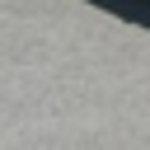
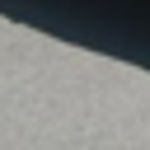
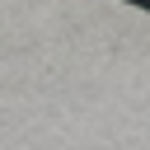
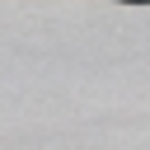
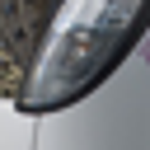
...
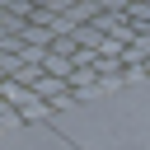
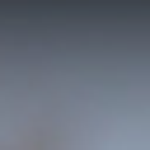
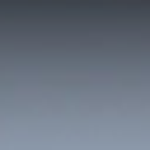
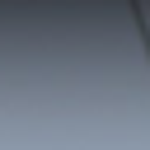
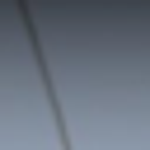

[27, 132, 179, 907, 918, 919, 996, 1043, 1050, 1138, 1141, 1154, 1383, 1447, 1710, 1712, 1829, 1838, 1852, 1971, 2038, 2157, 2182, 2191, 2199, 2204, 2350, 2411, 2412, 2688, 2893, 2894, 2941, 3009, 3011, 3334, 3444, 3658, 3659, 3715, 3765, 3979, 4018, 4089, 4090, 4093, 4349, 4373, 4434, 4455, 4456, 4457, 4458, 4459, 4462, 4463, 4663, 4664, 4665, 4680, 5154, 5234, 5331, 5492, 5494, 5715, 5805, 5811, 5813, 5999, 6091, 6092, 6094, 6095, 6187, 6467, 6468, 6553, 6602, 6603, 6786, 6788, 6990, 7104, 7107, 7108, 7613, 7614, 8009, 8025, 8026, 8253, 8409, 8609, 8641, 9283, 9296, 9407, 9552, 9632, 9647, 9799, 9906, 9907, 10044, 10336, 10347, 10825, 10838, 10877, 11427, 11443, 11807, 11968, 12061, 12636, 12876, 13812, 13814, 13927, 13928, 14063, 14064, 14587, 15210, 15315, 15421, 15631, 16103, 16154, 16155, 16160, 16187, 16190, 16533, 16537, 17121, 17219, 17346, 17470, 17631, 17669, 18120, 18214, 18368, 18719, 19060, 19337, 19379, 19561, 20079, 20096, 20179, 20315, 20316, 20528, 20830, 20850, 20854


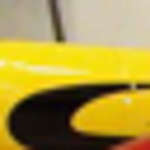
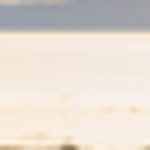
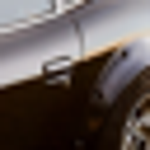
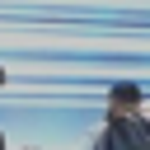
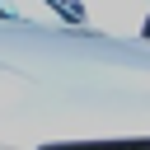
...
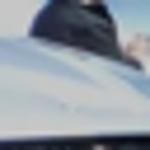
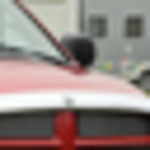
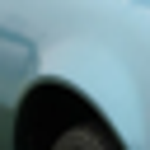
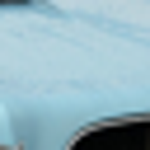
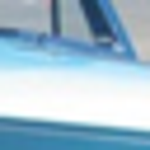

[51, 73, 84, 289, 298, 407, 460, 461, 549, 561, 713, 780, 809, 897, 910, 936, 941, 953, 954, 1180, 1497, 1498, 1510, 1511, 1518, 1519, 1738, 1874, 2131, 2307, 2310, 2692, 2693, 2700, 2744, 2752, 2753, 2755, 2757, 2766, 2767, 2768, 2780, 2781, 2946, 2958, 2959, 2970, 2971, 3194, 3496, 3545, 3602, 3614, 3615, 3616, 3622, 3778, 3790, 3825, 4122, 4257, 4258, 4263, 4395, 4443, 4526, 4716, 4727, 4954, 5020, 5034, 5081, 5091, 5389, 5390, 5391, 5392, 5405, 5498, 5592, 5650, 5651, 5663, 5694, 5696, 5815, 6279, 6282, 6287, 6288, 6290, 6303, 6304, 6320, 6333, 6537, 6591, 6607, 6609, 7134, 7225, 7391, 7633, 7640, 7655, 7826, 7858, 8153, 8271, 8461, 8481, 8813, 8835, 8878, 8922, 9094, 9095, 9108, 9111, 9121, 9124, 9201, 9342, 9343, 9347, 9348, 9354, 9377, 9649, 9794, 9910, 10105, 10213, 10222, 10533, 10610, 10708, 11152, 11172, 11174, 11178, 11183, 11184, 11190, 11191, 11196, 11206, 11208, 11209, 11219, 11237, 11298, 11300, 11305, 11312, 11313, 11314, 11326, 11337, 11340, 11530, 11539, 11541, 12116


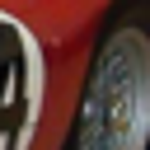
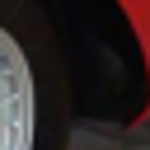
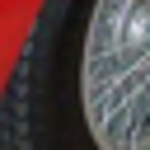
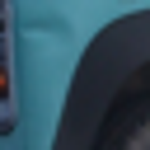
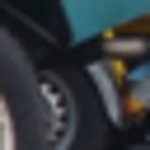
...
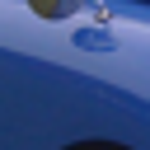
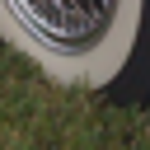
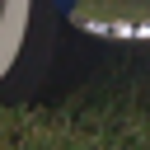
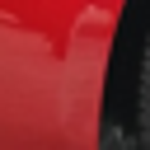
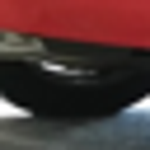

[3, 8, 110, 111, 112, 113, 114, 115, 1566, 1576, 1577, 2087, 2506, 4615, 4641, 4643, 5200, 5201, 5202, 5203, 5204, 5213, 5214, 5224, 5225, 5226, 5239, 5548, 5549, 5761, 5767, 5770, 6006, 6383, 6384, 6394, 6395, 6396, 6407, 6408, 7694, 7698, 7699, 7949, 7950, 7951, 7954, 7955, 7958, 7959, 7960, 7962, 7963, 7964, 7967, 7968, 7972, 7973, 7974, 7985, 7986, 7987, 9607, 9608, 9609, 9610, 9620, 9621, 9622, 9623, 9624, 9625, 9802, 9971, 9974, 9977, 9978, 9981, 9982, 9983, 9984, 9987, 9988, 9989, 9995, 9996, 9997, 9998, 9999, 10000, 10001, 10002, 10744, 10745, 10746, 10747, 10748, 10749, 10750, 10751, 10752, 10753, 10754, 10755, 10756, 10971, 12811, 12812, 12813, 12814, 12815, 16629, 16630, 16631, 16632, 17036, 17037, 17045, 17050, 17595, 17596, 17608, 19643, 19644, 19645, 19646, 19647, 19648, 19657, 19658, 19766, 19767, 19768, 19771, 19772, 19773, 19774, 19775, 19781, 19789, 20130, 20131, 20142, 20143, 20144, 20155, 20156, 20157, 20168, 20169, 20181, 20182, 20194, 20195, 20207, 20208, 20216, 2


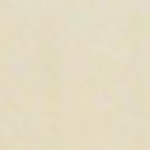
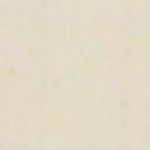
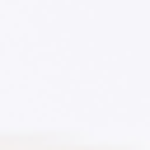
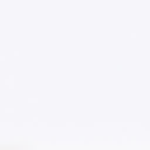
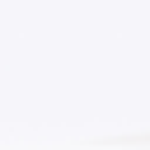
...
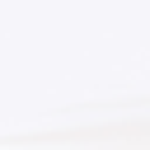
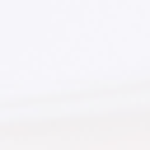
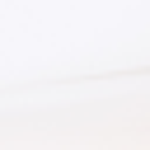
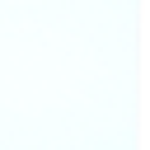
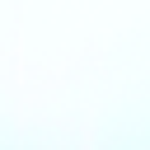

[82, 282, 389, 405, 409, 410, 522, 602, 803, 864, 865, 877, 926, 1028, 1963, 1964, 2002, 2109, 2110, 2112, 2126, 2194, 2205, 2215, 3016, 3029, 3537, 3538, 3541, 3542, 3951, 4107, 4112, 4113, 4123, 4124, 4201, 4202, 4212, 4213, 4351, 4363, 4364, 4580, 4803, 5230, 5231, 5233, 5247, 5256, 5257, 5259, 5262, 5263, 5266, 5267, 5268, 5269, 5270, 5271, 5274, 5276, 5495, 6061, 6175, 6191, 6195, 6197, 6326, 6593, 6596, 6597, 6598, 6599, 7114, 7125, 7342, 7343, 7344, 7345, 7346, 7347, 7451, 7457, 7459, 7465, 7466, 7470, 7471, 7553, 8032, 8033, 8183, 8357, 8358, 8359, 8360, 8369, 8401, 8642, 8643, 8727, 8728, 8731, 8736, 8737, 8738, 8930, 8998, 9007, 9008, 9009, 9188, 9189, 9285, 9695, 9706, 9707, 9708, 9709, 9710, 9711, 9714, 9716, 10123, 10125, 10128, 12057, 12714, 12836, 12838, 12844, 12845, 13252, 13254, 14529, 14731, 14779, 14780, 14781, 14782, 14785, 14810, 15056, 15223, 15329, 15429, 17215, 17260, 17281, 19683, 19684, 21003, 21655, 21656, 21881, 21900, 22002, 22007, 22009, 22552, 22954, 231


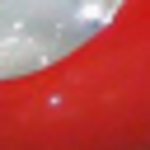
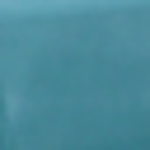
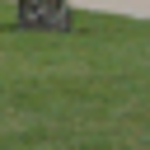
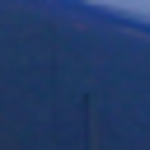
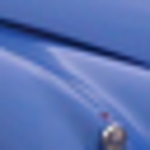
...
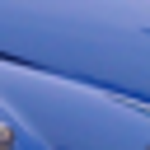
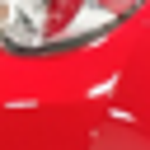
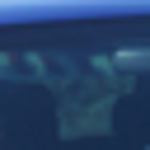
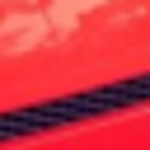
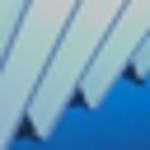

[161, 228, 229, 261, 566, 567, 568, 569, 570, 651, 674, 680, 891, 904, 1126, 1127, 1128, 1370, 1586, 1763, 1913, 1915, 1960, 2024, 2025, 2174, 2320, 2321, 2329, 2360, 2381, 2669, 3416, 3511, 3512, 3513, 3761, 3772, 3882, 3883, 3890, 4319, 4322, 4444, 4445, 4523, 4540, 4667, 4668, 4705, 5037, 5038, 5418, 5419, 5462, 5463, 5464, 5503, 5603, 5833, 6036, 6071, 6078, 6079, 6141, 6479, 6566, 6567, 6845, 6846, 6874, 6971, 6977, 7069, 7080, 7081, 7179, 7275, 7365, 7375, 7505, 7719, 7720, 7721, 7722, 8209, 8214, 8215, 8256, 8311, 8389, 8492, 8501, 8505, 8545, 9231, 9232, 9233, 9234, 9254, 9382, 9514, 9515, 9645, 9776, 9783, 9784, 9786, 10040, 10110, 10255, 10344, 10345, 10385, 10448, 10449, 10460, 10464, 10465, 10466, 10513, 10666, 10668, 10797, 10798, 10841, 11295, 11307, 11606, 11777, 11778, 11910, 11922, 11923, 12064, 12627, 12628, 12792, 12803, 12974, 13493, 13502, 13513, 13541, 13693, 13777, 13779, 13785, 13786, 13910, 14321, 14338, 14538, 14653, 15047, 15106, 15302, 15420, 15610, 15720, 1


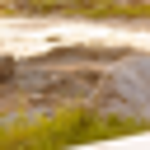
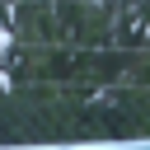
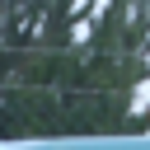
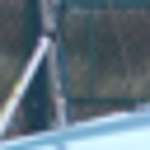
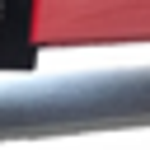
...
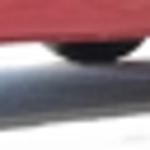
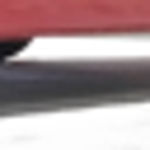
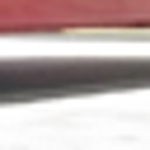
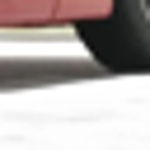
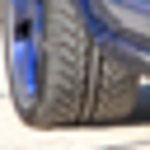

[893, 894, 1201, 1353, 1561, 1666, 1667, 1670, 1811, 1812, 1813, 1814, 1815, 1816, 1817, 3404, 3419, 3420, 3421, 3422, 3423, 3486, 3645, 3666, 3668, 3676, 3689, 3810, 3811, 3812, 3813, 3814, 3815, 3816, 3817, 3819, 4013, 4045, 4046, 4049, 4050, 4303, 4304, 4323, 4339, 4340, 4420, 4421, 4422, 4446, 4447, 4448, 4542, 4545, 4602, 4603, 4604, 4645, 4646, 4647, 4648, 4748, 4979, 4980, 4981, 4982, 4983, 4984, 4985, 4986, 4987, 5384, 5399, 5400, 5415, 5416, 5677, 5868, 5971, 5972, 5973, 6372, 6373, 6374, 6514, 6524, 6550, 6619, 6620, 6621, 6622, 6623, 6625, 6626, 6627, 6711, 6712, 6715, 6886, 7021, 7038, 7041, 7042, 7058, 7061, 7062, 7063, 7666, 7667, 7670, 7754, 7792, 8043, 8314, 8315, 8543, 8895, 9149, 9151, 9265, 9371, 9372, 9516, 9517, 9533, 9674, 9675, 9676, 9677, 9680, 9954, 10049, 10154, 10155, 10156, 10157, 10164, 10165, 10252, 10253, 10254, 10259, 10260, 10322, 10323, 10338, 10380, 10387, 10388, 10389, 10516, 10517, 10518, 10519, 10569, 10932, 10933, 10934, 10935, 11067, 11401, 11402


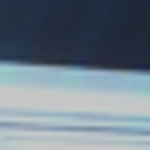
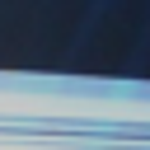
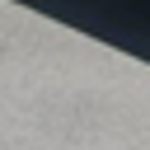
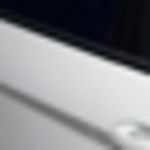
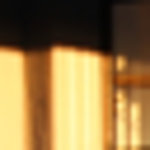
...
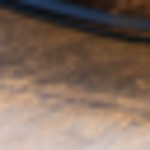
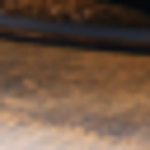
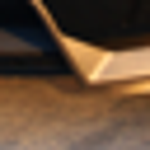
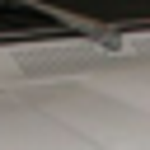
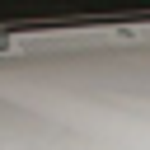

[15, 16, 17, 106, 107, 108, 109, 145, 226, 232, 233, 576, 577, 692, 1578, 1580, 1589, 1591, 2274, 2500, 2502, 2503, 2504, 2516, 2518, 3956, 3957, 3958, 4072, 4087, 4780, 4894, 4895, 5206, 5207, 5208, 5209, 5215, 5476, 5477, 5478, 5532, 5571, 5659, 5768, 5769, 5771, 5773, 5774, 5780, 5782, 6007, 6135, 6410, 6421, 6425, 6473, 7156, 7337, 7455, 7569, 7570, 7571, 7689, 7691, 7692, 7709, 7713, 7714, 7952, 7953, 7975, 7976, 7977, 7978, 7981, 7982, 7983, 7984, 7998, 7999, 8000, 8090, 8091, 9144, 9279, 9280, 9474, 9800, 9990, 9994, 10007, 10488, 10489, 10490, 10491, 10642, 10768, 10948, 12830, 12943, 12994, 12996, 12997, 14008, 14018, 16522, 16643, 16644, 16645, 17049, 17057, 17498, 17609, 18155, 18159, 18176, 18177, 18178, 18583, 19659, 19770, 19776, 19777, 19778, 19779, 19780, 19785, 19787, 19788, 19790, 19793, 19797, 19801, 20174, 20306, 20307, 20333, 20334, 21175, 21176, 21177, 21185, 21328, 21329, 21361, 22597, 22627, 22628, 22629, 22633, 22635, 22636, 22689, 22796, 22799, 23032, 23106, 2


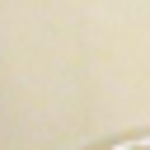
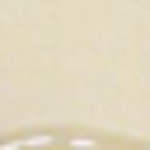
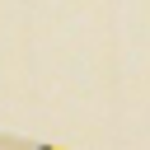
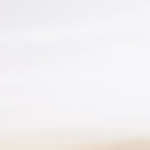
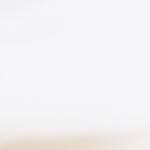
...
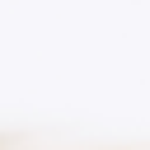
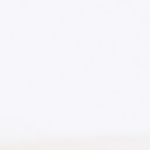
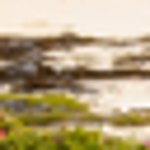
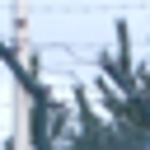
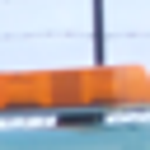

[91, 102, 103, 1143, 1199, 3152, 3153, 4207, 4208, 4209, 4210, 4211, 4223, 4224, 7436, 8982, 8993, 8995, 8996, 8997, 9616, 9848, 9849, 9860, 9861, 9873, 9886, 9899, 9925, 9938, 9951, 9959, 11800, 12702, 12703, 13177, 13184, 13197, 13506, 13516, 13517, 14772, 14784, 15281, 15282, 15451, 15452, 15465, 17000, 17001, 18283, 19023, 19024, 19025, 19026, 19027, 19034, 19035, 19036, 19037, 19168, 19169, 19170, 19171, 19173, 19178, 19179, 19181, 19192, 19193, 19194, 19757, 20352, 20353, 20361, 20362, 20370, 20371, 20378, 20379, 20380, 20381, 20382, 20386, 20388, 20389, 20390, 20395, 23454, 24918, 24921, 24922, 25226, 25227, 25262, 25356, 25357, 25358, 25359, 25367, 25368, 25707, 25749, 25763, 25764, 25765, 25766, 25767, 25768, 25770, 25771, 25781, 25782, 25820, 25821, 25822, 25831, 25832, 25833, 25834, 25835, 25836, 25837, 26002, 26003, 26015, 26023, 26408, 26524, 26525, 26664, 26665, 26675, 26676, 26773, 26774, 26786, 26787, 27029, 27239, 27240, 27280, 27281, 27282, 27292, 28059, 28153, 28164,


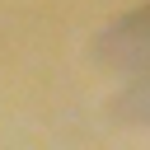
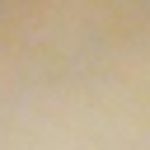
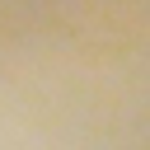
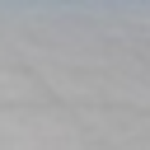
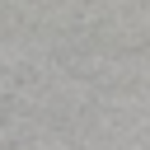
...
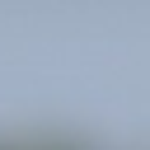
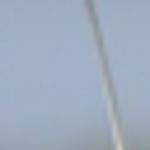
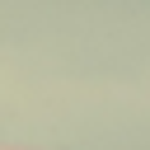
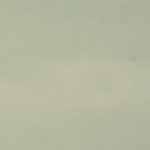
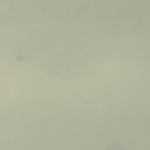

[163, 361, 441, 452, 544, 653, 711, 1076, 1215, 1227, 1367, 1388, 1472, 1622, 1623, 1723, 1734, 1781, 2291, 2304, 2387, 2408, 2423, 2424, 2430, 2449, 2462, 2463, 2521, 2921, 3203, 3519, 3726, 3731, 3791, 4000, 4385, 4464, 4475, 4672, 4771, 5122, 5130, 5143, 5148, 5161, 5374, 5705, 5836, 5880, 5904, 5926, 5927, 5929, 6544, 6701, 6981, 6982, 6994, 7163, 7170, 7176, 7184, 7186, 7188, 7192, 7197, 7199, 7300, 8116, 8165, 8206, 8219, 8232, 8270, 8515, 8522, 8528, 9046, 9053, 9055, 9064, 9076, 9077, 9358, 9477, 9501, 9654, 9811, 10103, 10210, 10280, 10359, 10367, 10454, 10455, 10795, 10796, 10807, 10821, 10833, 10836, 10845, 11123, 11134, 11141, 11142, 11155, 11514, 11515, 11587, 11588, 11654, 11667, 11793, 11806, 11867, 11873, 11886, 11889, 12300, 12592, 12616, 12625, 12626, 12638, 12645, 12664, 12668, 12690, 12884, 12892, 12897, 12923, 13300, 13321, 13677, 13720, 13815, 13915, 14057, 14453, 14907, 14919, 14928, 14929, 14931, 14932, 14958, 14975, 14986, 15041, 15053, 15065, 15340, 15348, 153


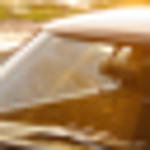
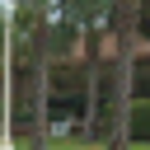
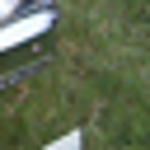
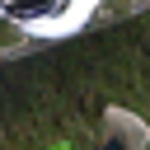
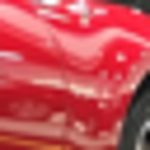
...
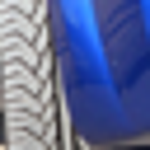
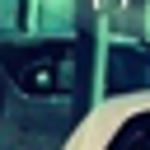
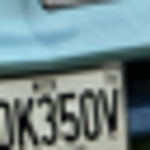
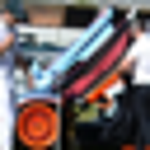
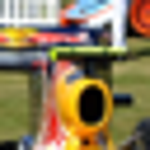

[156, 157, 169, 170, 171, 182, 184, 195, 196, 207, 208, 209, 210, 217, 218, 220, 551, 727, 728, 1089, 1216, 1217, 1254, 1297, 1393, 2385, 2390, 2426, 2427, 2472, 2475, 2486, 2487, 2488, 2640, 3238, 3239, 3367, 3368, 3369, 3370, 3371, 3372, 3373, 3374, 3375, 3376, 3377, 3378, 3379, 3380, 3381, 3382, 3383, 3384, 3386, 3387, 3388, 3389, 3390, 3391, 3392, 3393, 3394, 3395, 3396, 3407, 3409, 3492, 3493, 3494, 3505, 3506, 3507, 3520, 4290, 4295, 4296, 4297, 4466, 4473, 4524, 4525, 4708, 4709, 4738, 4772, 4773, 4774, 4888, 4889, 4890, 4891, 4901, 4903, 4904, 4905, 4914, 4916, 4917, 4918, 5500, 5733, 5881, 5882, 5883, 5884, 5885, 5887, 5888, 5900, 6219, 6670, 6671, 6672, 6674, 6682, 6686, 6693, 6694, 6707, 6795, 6808, 6821, 6927, 6929, 6930, 6934, 6940, 6941, 6943, 6944, 6950, 6951, 6954, 6983, 7027, 7237, 7385, 7395, 7396, 7397, 7777, 7790, 8117, 8798, 8811, 8814, 9316, 9479, 9480, 9507, 10169, 10182, 10183, 10195, 10197, 10276, 10277, 10278, 10282, 10283, 10284, 10286, 10287, 10288, 10289, 1


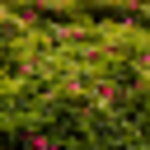
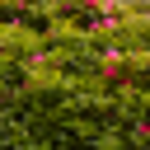
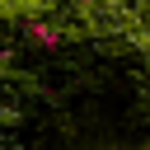
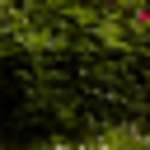
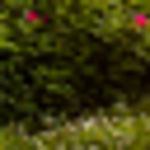
...
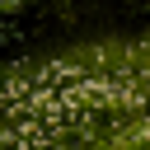
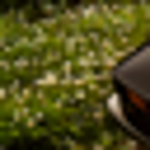
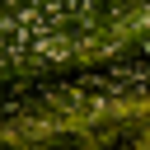
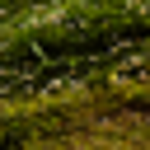
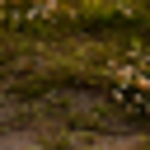

[256, 257, 4171, 8575, 8576, 8577, 8578, 8589, 8590, 8591, 8592, 8953, 8954, 8955, 8956, 8957, 8958, 8966, 8967, 8968, 8969, 8970, 8971, 8979, 8980, 8981, 9604, 9605, 9617, 9618, 9855, 15450, 15464, 15477, 15478, 15479, 16919, 16920, 16921, 16922, 16923, 16924, 16925, 16926, 16927, 16928, 16929, 16930, 16931, 16932, 16933, 16934, 16935, 16936, 16937, 16938, 16939, 16940, 16941, 16942, 16943, 16944, 16945, 16946, 16947, 16948, 16949, 16950, 16951, 16952, 16953, 16954, 16955, 16956, 16957, 16958, 16959, 16960, 16961, 16962, 16963, 16964, 16965, 16966, 16967, 16968, 16969, 16970, 16971, 16972, 16973, 16981, 16982, 16983, 16996, 16997, 17009, 17010, 17011, 17012, 17013, 17014, 17018, 17019, 17020, 17021, 17022, 17023, 17024, 17025, 17026, 17027, 17028, 17030, 17031, 17032, 17033, 17034, 17035, 17432, 17433, 17434, 17435, 17436, 17437, 17446, 17447, 17448, 17449, 17816, 17817, 17818, 17819, 17820, 17821, 17822, 17823, 17824, 17825, 17826, 17827, 17828, 18551, 18552, 18553, 18554, 18555, 185


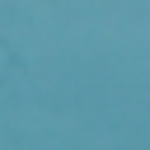
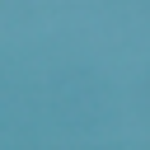
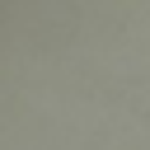
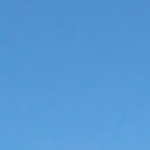
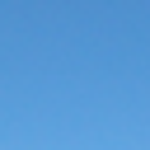
...
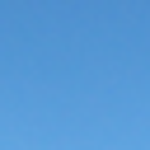
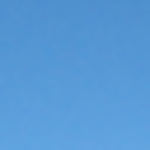
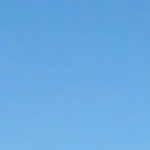
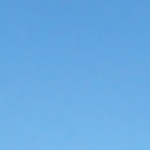
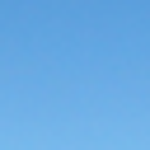

[574, 575, 1460, 1466, 1473, 1596, 1611, 1849, 2496, 2499, 2517, 3722, 3730, 3766, 3980, 4078, 4346, 4347, 4350, 5063, 5264, 5350, 5570, 5584, 5585, 5599, 5784, 5812, 5951, 6392, 6393, 6405, 6406, 6462, 7336, 7732, 7997, 9050, 9140, 9142, 9160, 9161, 9175, 9276, 9277, 9801, 9813, 9814, 10184, 10641, 10961, 11506, 11510, 11853, 11859, 11868, 11969, 11982, 11990, 12030, 12717, 12718, 12730, 12731, 12784, 12797, 12942, 13618, 13632, 13646, 14007, 14029, 14030, 14043, 14056, 14502, 15305, 16517, 16641, 16671, 17044, 17069, 17076, 17077, 17082, 17160, 18157, 18161, 18162, 18593, 18608, 18924, 19669, 19682, 19783, 19798, 20041, 20054, 20133, 20134, 20140, 20141, 20147, 20304, 21072, 21073, 21083, 21084, 21094, 21370, 21401, 21402, 21446, 21447, 21460, 22109, 22111, 23105, 23294, 23549, 23570, 23683, 24552, 24553, 25306, 25333, 25340, 25611, 26099, 26118, 26424, 26753, 26767, 26768, 27249, 27575, 27928, 28051, 28069, 28236, 28291, 28347, 28348, 28379, 28657, 28987, 29000, 29008, 29220, 29221,


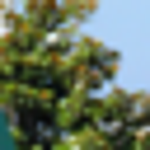
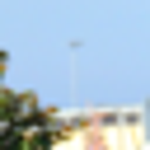
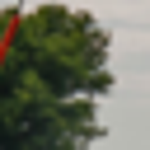
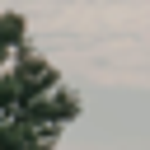
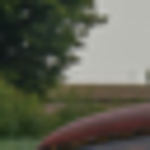
...
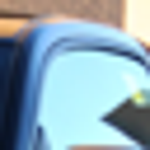
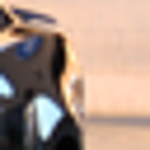
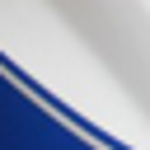
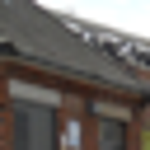
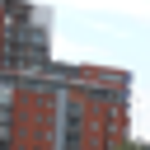

[186, 189, 190, 191, 308, 642, 970, 1223, 1287, 1294, 1295, 1296, 1343, 1344, 1345, 1380, 1392, 1407, 1436, 1437, 1594, 1615, 1616, 1642, 1644, 1645, 1746, 1792, 1793, 1856, 1982, 1983, 1984, 2489, 2490, 2953, 3385, 3438, 3439, 3727, 3785, 3786, 3789, 4274, 4275, 4276, 4387, 4441, 4722, 4737, 5169, 5514, 5516, 5756, 5757, 5906, 6350, 6751, 6787, 6984, 6985, 7198, 7379, 7387, 7407, 7408, 7409, 7410, 7745, 7763, 7788, 7789, 7796, 8540, 9200, 9319, 9566, 9567, 9661, 10216, 10217, 10349, 10357, 10358, 10496, 10605, 10606, 10881, 10913, 10914, 10995, 10996, 10998, 11004, 11005, 11006, 11007, 11008, 11009, 11010, 11011, 11012, 11013, 11014, 11015, 11016, 11080, 11132, 11332, 11333, 11334, 11454, 11677, 11697, 11698, 11699, 11700, 11890, 11905, 11935, 12200, 12201, 12204, 12205, 12206, 12207, 12291, 13851, 13940, 15728, 16236, 16237, 16253, 16884, 18739, 18817, 18818, 18863, 19482, 20746, 20767, 21284, 21286, 21420, 21452, 23021, 23049, 23063, 23133, 23533, 23799, 23800, 23802, 23806, 23807, 


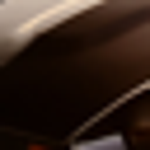
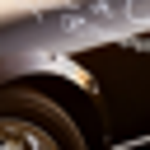
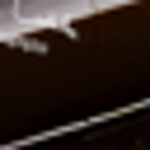
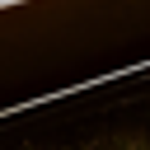
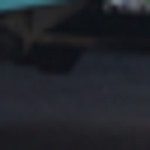
...
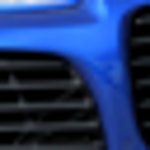
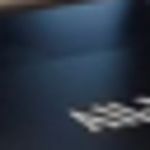
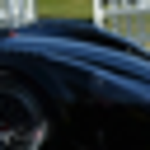
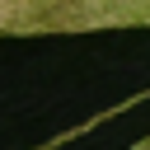
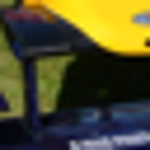

[48, 66, 158, 159, 160, 173, 181, 248, 273, 274, 275, 364, 424, 426, 440, 449, 505, 521, 588, 591, 592, 641, 704, 705, 718, 722, 732, 1012, 1077, 1604, 1850, 1863, 2022, 2094, 2158, 2161, 2214, 2216, 2296, 2302, 2389, 2404, 2425, 2512, 2891, 2922, 2939, 2955, 2976, 3014, 3023, 3060, 3215, 3295, 3332, 3333, 3733, 4003, 4040, 4343, 4344, 4357, 4510, 4511, 4512, 4622, 4919, 4965, 5060, 5077, 5141, 5360, 5361, 5373, 5377, 5378, 5379, 5458, 5553, 5554, 5582, 5583, 5670, 5683, 5684, 5716, 5754, 5790, 5848, 5891, 5907, 5921, 5923, 5924, 5925, 5932, 6029, 6154, 6155, 6171, 6186, 6554, 6555, 6577, 6600, 6723, 6735, 6737, 7079, 7189, 7283, 7496, 7606, 7625, 7626, 7627, 7748, 7762, 7764, 7863, 7864, 7880, 7883, 8021, 8104, 8122, 8123, 8149, 8150, 8203, 8247, 8252, 8254, 8262, 8375, 8408, 8510, 8524, 8529, 8541, 9045, 9052, 9054, 9075, 9155, 9159, 9184, 9248, 9289, 9290, 9315, 9406, 9660, 10019, 10036, 10209, 10346, 10352, 10353, 10456, 10501, 10791, 10794, 10815, 10861, 10975, 11135, 11601, 11639


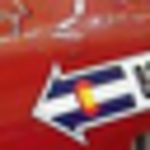
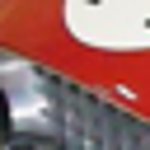
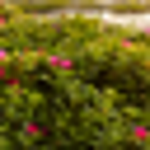
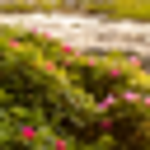
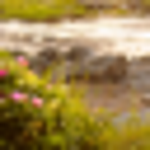
...
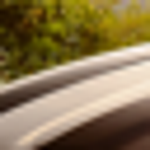
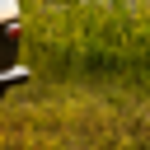
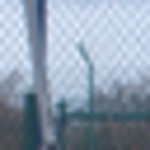
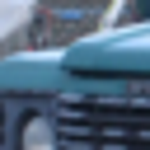
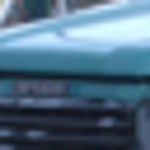

[71, 253, 278, 871, 980, 1106, 1135, 1146, 1433, 1491, 1976, 2509, 2754, 2873, 2874, 2875, 2876, 2886, 2888, 2986, 3006, 3042, 3053, 3055, 3213, 3352, 3641, 3901, 4130, 4240, 4573, 4587, 4847, 5013, 5031, 5033, 5044, 5046, 5107, 5289, 6167, 6168, 6439, 6440, 7483, 7486, 7499, 7632, 7820, 7821, 7822, 7823, 7833, 7834, 7835, 7845, 8834, 8836, 8837, 8847, 8918, 8977, 9085, 9626, 9791, 9804, 10207, 11165, 11173, 11207, 11290, 11323, 11498, 11733, 11746, 11751, 11754, 11759, 11763, 11765, 11772, 11993, 12015, 12028, 12118, 12331, 12430, 12431, 12440, 12441, 12442, 12475, 13073, 13161, 13168, 13169, 13173, 13174, 13186, 13195, 13199, 13220, 13224, 13236, 13248, 13249, 13262, 13409, 13410, 13419, 13440, 13459, 13460, 13461, 13471, 13781, 13790, 13863, 13872, 14125, 14233, 14246, 14515, 14628, 14637, 14651, 14696, 14800, 14805, 14813, 14832, 14836, 14845, 14846, 14850, 14859, 14864, 14872, 14875, 15005, 15018, 15031, 15166, 15170, 15171, 15178, 15183, 15205, 15206, 15208, 15227, 15442, 15461, 


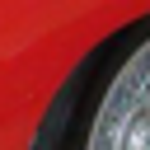
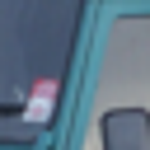
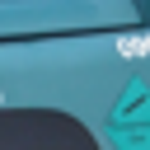
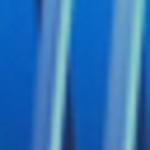
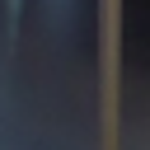
...
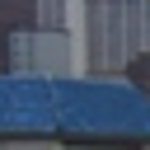
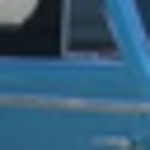
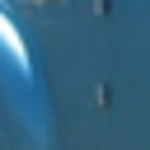
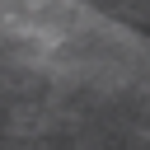
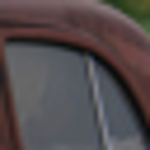

[2, 4, 5, 7, 9, 10, 11, 104, 105, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 136, 677, 683, 684, 685, 686, 1563, 1564, 1565, 1567, 2505, 3706, 3711, 3712, 4071, 4075, 4079, 4080, 4336, 4628, 4642, 4862, 5211, 5212, 5223, 5238, 5533, 5534, 5535, 5536, 5537, 5547, 5550, 5588, 5601, 5602, 5760, 6430, 6448, 7693, 7695, 7696, 7697, 7700, 7701, 7956, 7957, 7966, 7969, 7970, 7971, 7979, 7980, 8076, 8077, 9278, 9281, 9815, 9969, 9972, 9973, 9975, 9976, 9980, 9985, 9986, 9993, 10401, 10402, 10403, 10944, 10945, 10956, 10957, 10958, 10969, 10970, 10972, 12787, 12799, 12800, 12801, 12816, 12817, 12818, 12823, 12944, 12945, 12958, 12971, 12983, 12984, 12992, 13005, 13522, 13523, 13616, 13627, 13628, 13629, 13634, 13635, 13636, 13637, 13638, 13640, 13641, 13647, 13648, 13650, 13651, 13652, 13653, 13654, 17661, 17675, 17688, 18519, 18520, 18522, 18527, 19635, 20135, 20136, 20137, 20138, 20148, 20149, 20150, 20161, 20162, 20163, 20175, 20177, 20188, 20190, 20200, 20201, 202


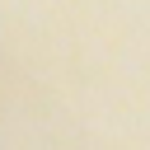
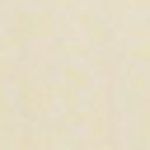
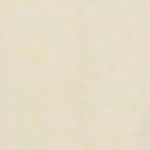
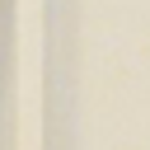
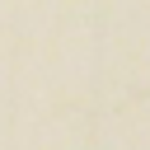
...
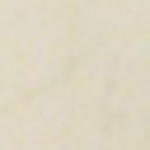
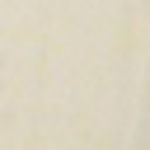
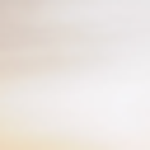
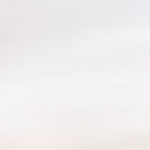
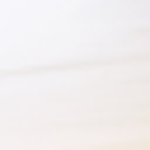

[366, 545, 559, 665, 679, 681, 915, 916, 1015, 1049, 1371, 1832, 2169, 2338, 2373, 2394, 2524, 2525, 2526, 2666, 2897, 3500, 3527, 3647, 3667, 3736, 3744, 3747, 3754, 3774, 4318, 4416, 4417, 4419, 4499, 4541, 4544, 4546, 4547, 4549, 4551, 4764, 4807, 4809, 4858, 4860, 4935, 4936, 5051, 5139, 5140, 5414, 5432, 5469, 5470, 5674, 5675, 5699, 5700, 5965, 5978, 5990, 6313, 6542, 6549, 6562, 6564, 6570, 6571, 6590, 6628, 6801, 6814, 6899, 7070, 8204, 8264, 8497, 8498, 8500, 8504, 8544, 8674, 9057, 9058, 9148, 9268, 9527, 9528, 9539, 9541, 9685, 10024, 10031, 10032, 10111, 10114, 10115, 10249, 10251, 10333, 10339, 10378, 10386, 10473, 10481, 10482, 10520, 10521, 10522, 10937, 11417, 11626, 11627, 11666, 11725, 11726, 11727, 11728, 11794, 11795, 11822, 11938, 11939, 11959, 12142, 12188, 12674, 12756, 12775, 12902, 12903, 13131, 13531, 13699, 13700, 13766, 14065, 14673, 14917, 15109, 15110, 15152, 15418, 15609, 16057, 16085, 16183, 16202, 16227, 17110, 17338, 17618, 17620, 18169, 18170, 18362, 


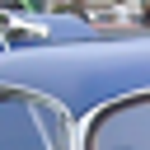
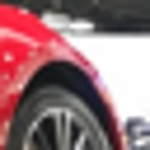
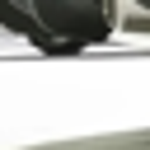
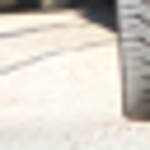
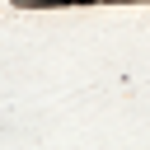
...
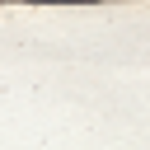
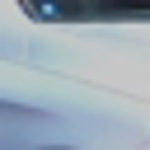
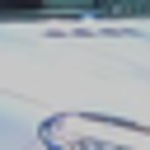
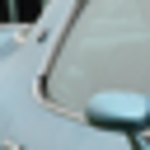
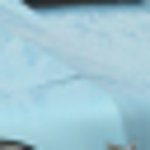

[6, 130, 134, 137, 138, 139, 147, 148, 149, 150, 151, 221, 223, 224, 225, 235, 236, 581, 582, 594, 595, 663, 664, 675, 678, 687, 1152, 1574, 1587, 1841, 2333, 2335, 2501, 3047, 3432, 3707, 3708, 3709, 3710, 3716, 3717, 3981, 4077, 4092, 4331, 4333, 4335, 4338, 4781, 4877, 4878, 4879, 4880, 4881, 4884, 4885, 5116, 5129, 5291, 5546, 5559, 5560, 5561, 5562, 5572, 5586, 5587, 5600, 5660, 5673, 5690, 5702, 5759, 5763, 5764, 5765, 5772, 5777, 5778, 5877, 6080, 6134, 6147, 6148, 6160, 6424, 6431, 6432, 6449, 6459, 6465, 6470, 6541, 7093, 7094, 7095, 7096, 7442, 7443, 7561, 7562, 7568, 7575, 7581, 7584, 7588, 7589, 7600, 7734, 7965, 7988, 7989, 7991, 8003, 8004, 8005, 8067, 8068, 8069, 8070, 8071, 8072, 8073, 8075, 8078, 8081, 8084, 8085, 8325, 8499, 8513, 8514, 8517, 8518, 9266, 9282, 9394, 9396, 9397, 9530, 9531, 9542, 9543, 9544, 9785, 9787, 9788, 9789, 9796, 10176, 10177, 10400, 10404, 10406, 10407, 10408, 10409, 10410, 10411, 10412, 10413, 10420, 10422, 10423, 10424, 10425, 10426, 10430, 


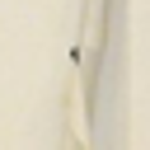
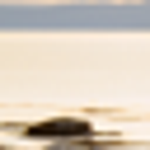
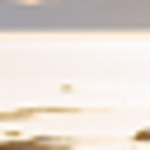
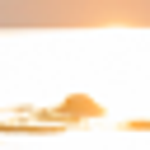
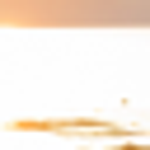
...
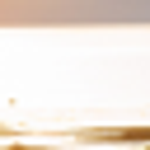
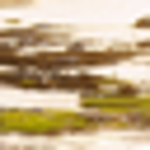
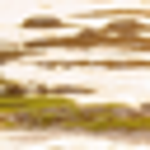
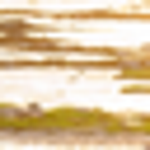
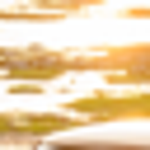

[219, 356, 359, 506, 509, 514, 530, 531, 533, 587, 611, 612, 720, 1001, 1212, 1218, 1219, 1220, 1221, 1234, 1268, 1305, 1368, 1478, 1660, 1752, 1753, 2184, 2317, 2318, 2337, 2382, 2383, 2384, 2396, 2399, 2400, 2417, 2421, 2422, 2451, 2528, 2641, 2642, 2643, 2792, 2793, 3034, 3283, 3403, 3408, 3586, 3648, 3734, 3753, 4014, 4302, 4408, 4471, 4472, 4474, 4482, 4483, 4754, 4805, 4924, 5124, 5144, 5145, 5351, 5352, 5367, 5645, 5678, 5691, 5692, 5743, 5893, 5894, 5895, 5896, 5897, 5898, 5899, 5901, 5914, 5917, 6043, 6076, 6104, 6299, 6315, 6546, 6548, 6556, 6942, 6958, 7164, 7177, 7183, 7366, 7382, 7383, 7384, 7851, 7852, 8200, 8297, 8395, 8397, 8471, 8475, 8476, 8484, 8485, 8503, 8520, 8539, 9061, 9062, 9063, 9229, 9230, 9303, 9502, 9503, 9512, 10029, 10033, 10224, 10235, 10340, 10343, 10809, 10814, 10863, 11130, 11139, 11140, 11204, 11404, 11406, 11581, 11615, 11617, 11652, 11789, 11876, 11877, 11880, 11881, 11882, 11911, 12273, 12622, 12623, 12651, 12655, 12662, 12673, 12889, 12906, 13307


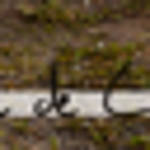
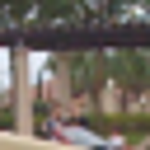
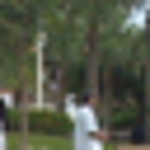
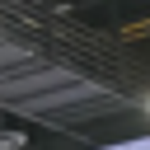
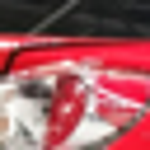
...
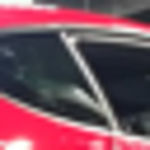
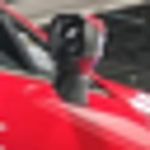
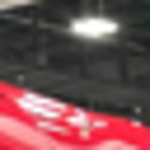
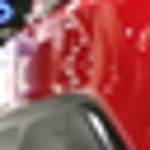
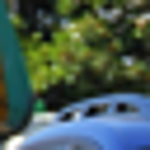

[336, 337, 350, 1183, 1184, 1196, 1197, 1198, 1454, 1455, 1683, 1742, 1755, 1768, 1769, 1770, 2549, 2562, 2572, 2573, 2575, 2589, 2590, 2601, 2603, 2614, 2911, 2913, 2914, 2924, 2937, 4058, 4059, 4062, 4063, 4064, 4065, 4219, 4849, 4939, 5410, 5411, 5412, 5413, 5423, 5424, 5425, 5436, 5437, 5438, 5439, 5440, 5443, 5444, 5496, 5980, 5981, 5982, 5983, 5984, 5985, 5996, 6002, 6084, 6381, 6630, 6631, 6632, 6633, 6634, 6635, 6636, 6637, 6638, 6639, 6640, 6641, 6643, 6644, 6645, 6646, 6647, 6648, 6649, 6650, 6651, 6652, 6653, 6654, 6655, 6914, 7610, 7622, 7623, 7662, 7674, 7675, 7681, 7682, 7683, 7684, 7685, 7686, 7687, 7688, 7901, 7902, 7903, 7913, 7914, 7916, 8038, 8039, 8051, 8052, 8058, 8059, 8060, 8061, 8062, 8063, 8064, 8223, 8224, 8225, 8236, 8248, 8699, 8700, 8707, 8716, 9535, 9536, 9537, 9548, 9549, 9561, 9562, 9574, 9575, 9587, 9588, 9688, 9689, 9690, 9912, 9952, 10264, 10265, 10266, 10267, 10268, 10269, 10270, 10271, 10272, 10273, 11239, 11251, 11252, 11253, 11254, 11255, 11424, 1


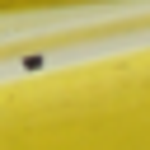
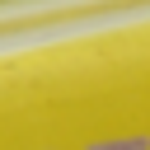
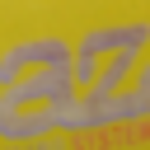
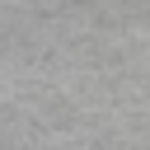
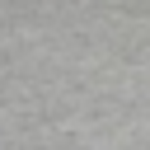
...
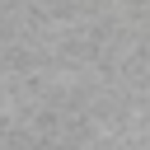
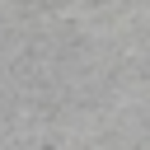
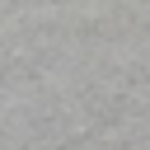
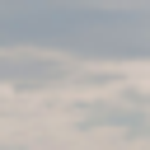
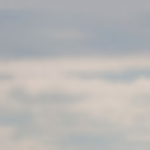

[59, 63, 176, 403, 447, 508, 537, 557, 613, 700, 702, 710, 736, 754, 769, 783, 796, 924, 938, 947, 1025, 1120, 1158, 1179, 1278, 1435, 1607, 1633, 1980, 2029, 2034, 2066, 2118, 2129, 2171, 2198, 2210, 2211, 2224, 2229, 2406, 2410, 2551, 2564, 2578, 2639, 2806, 2811, 2904, 2905, 2957, 3036, 3214, 3322, 3323, 3501, 3531, 4111, 4138, 4342, 4356, 4532, 4534, 4569, 4611, 4623, 4691, 4719, 4784, 4832, 4833, 5000, 5006, 5010, 5023, 5041, 5087, 5307, 5308, 5315, 5381, 5394, 5448, 5486, 5499, 5591, 6075, 6328, 6346, 6747, 6864, 6891, 6972, 7638, 7825, 7837, 7838, 8134, 8138, 8172, 8399, 8411, 8412, 8648, 8649, 8919, 9138, 9158, 9171, 9187, 9301, 9356, 9376, 9511, 9591, 9763, 9764, 9806, 9825, 9901, 9914, 9915, 10097, 10101, 10104, 10306, 10543, 10789, 10849, 10889, 10989, 11274, 11275, 11292, 11301, 11329, 11446, 11600, 11768, 11771, 11774, 12133, 12169, 12231, 12264, 12271, 12277, 12281, 12290, 12293, 12303, 12504, 12513, 12629, 12661, 12684, 12742, 12878, 13078, 13194, 13316, 13348, 13450, 13


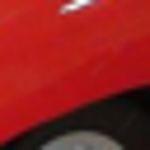
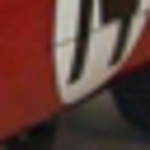
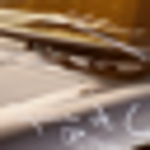
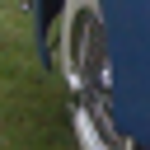
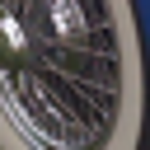
...
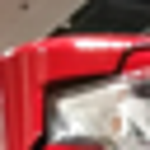
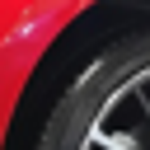
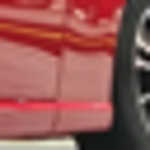
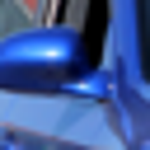
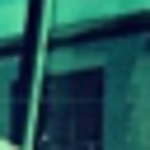

[305, 306, 562, 598, 825, 832, 833, 834, 882, 986, 987, 1192, 1193, 1249, 1250, 1263, 1438, 1439, 1440, 1514, 1517, 1520, 1522, 1523, 1627, 1628, 1629, 1643, 2132, 2135, 2136, 2431, 2827, 2829, 2847, 2848, 2980, 2983, 3207, 3228, 3236, 3464, 3557, 3558, 3563, 3582, 3792, 3861, 3862, 3863, 3907, 4328, 4378, 4379, 4388, 4389, 4390, 4392, 4507, 4634, 4635, 4653, 4725, 4972, 4973, 4974, 4976, 4977, 5089, 5090, 5168, 5176, 5177, 5178, 5181, 5182, 5387, 5517, 5710, 5744, 5843, 5844, 6203, 6204, 6215, 6216, 6255, 6256, 6257, 6258, 6259, 6260, 6352, 6364, 6666, 6683, 6764, 6765, 6766, 6998, 7029, 7127, 7128, 7133, 7136, 7137, 7401, 7644, 7760, 7769, 7770, 7795, 7799, 8163, 8174, 8423, 8744, 8745, 8757, 8758, 8759, 8760, 8761, 8859, 8880, 8908, 8910, 8923, 8935, 9001, 9013, 9017, 9018, 9033, 9034, 9035, 9205, 9208, 9215, 9216, 9310, 9311, 9320, 9353, 9362, 9402, 9403, 9434, 9438, 9447, 9448, 9449, 9450, 9818, 9830, 9846, 10057, 10134, 10185, 10218, 10525, 10526, 10541, 10573, 10871, 10994, 1100


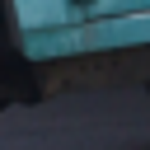
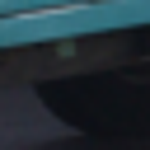
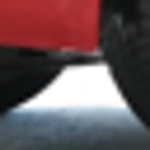
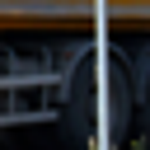
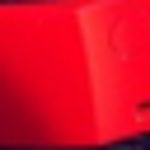
...
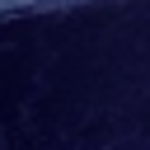
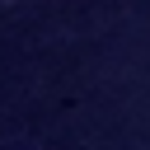
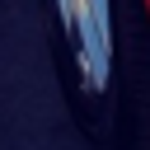
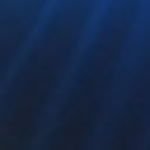
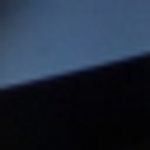

[75, 76, 77, 86, 87, 88, 89, 98, 320, 324, 331, 332, 339, 385, 494, 746, 747, 748, 749, 757, 758, 759, 798, 829, 840, 850, 851, 982, 1024, 1309, 1318, 1404, 1661, 1662, 1674, 1810, 1995, 1996, 1997, 1998, 1999, 2043, 2044, 2045, 2054, 2146, 2147, 2185, 2186, 2231, 2232, 2715, 2770, 2771, 2810, 2972, 2989, 3076, 3078, 3079, 3080, 3090, 3336, 3337, 3349, 3630, 3635, 3636, 3646, 3878, 3909, 3920, 3921, 3922, 3923, 3930, 3931, 4053, 4119, 4143, 4144, 4155, 4522, 4583, 4584, 4585, 4649, 4650, 4788, 5024, 5042, 5199, 5481, 5861, 5862, 5870, 5871, 5872, 5873, 5874, 6324, 6341, 6367, 6380, 6676, 6963, 7043, 7044, 7303, 7428, 7551, 7658, 7659, 7668, 7669, 8045, 8048, 8049, 8143, 8154, 8167, 8190, 8191, 8632, 8664, 8665, 8668, 8669, 8767, 8893, 9131, 9663, 9840, 9895, 9923, 9924, 9933, 9934, 9935, 9944, 9945, 9946, 9955, 9956, 10108, 10144, 10145, 10149, 10151, 10153, 10565, 10566, 10570, 10577, 10739, 10740, 10893, 10897, 10898, 11820, 12020, 12119, 12125, 12126, 12325, 12450, 12451, 12552, 125


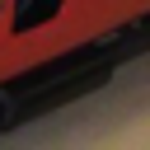
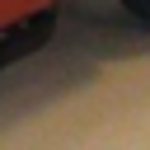
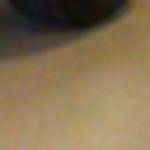
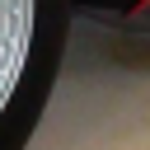
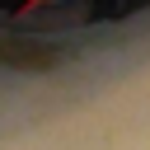
...
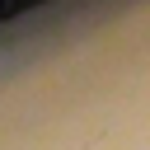
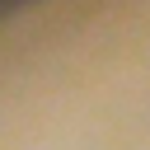
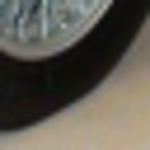
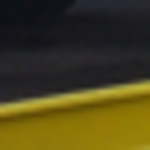
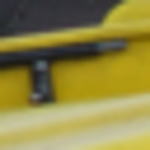

[258, 271, 775, 776, 2787, 4182, 4183, 4185, 4237, 7635, 8574, 8581, 8582, 8583, 8584, 8585, 8593, 8972, 8983, 8984, 9630, 9641, 9642, 9847, 9868, 9869, 10160, 10578, 12747, 12748, 12849, 12867, 13160, 15493, 15503, 16404, 16414, 16415, 16436, 16463, 16974, 16975, 16976, 16977, 16978, 16979, 16984, 16985, 16986, 16987, 16993, 16994, 16995, 17458, 17459, 17461, 17473, 17829, 17830, 17831, 17832, 17833, 17834, 17835, 17836, 17837, 17838, 17839, 17840, 17841, 18549, 18550, 22230, 22231, 22242, 23441, 23442, 23451, 24407, 24408, 24420, 24421, 24435, 24436, 24437, 24438, 24439, 24440, 24441, 24442, 24443, 24444, 24649, 24664, 24665, 24666, 24888, 24889, 24902, 24903, 24917, 24919, 24923, 24925, 25668, 25669, 25828, 25829, 25830, 25845, 25846, 25852, 25973, 26272, 26284, 26296, 26297, 26300, 26301, 26395, 26512, 26540, 26547, 26548, 26639, 26640, 26651, 26660, 26661, 26662, 26663, 26672, 26673, 26677, 26678, 26679, 26680, 26681, 26878, 26879, 26882, 26888, 26889, 26895, 26896, 26898, 26899, 


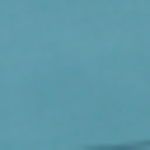
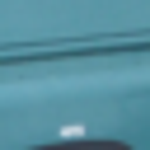
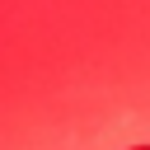
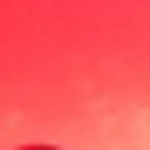
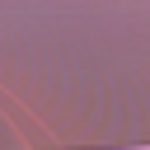
...
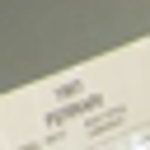
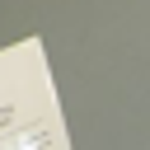
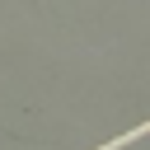
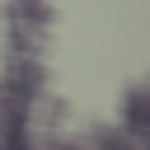
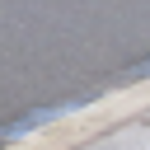

[99, 341, 453, 485, 491, 565, 571, 671, 672, 673, 1207, 1208, 1369, 1572, 1659, 1672, 1823, 2522, 2906, 2907, 3188, 3525, 3637, 3743, 3773, 3821, 3992, 4317, 4405, 4407, 4414, 4415, 4424, 4451, 4490, 4518, 4543, 4838, 4991, 5136, 5198, 5624, 5636, 5637, 5963, 6121, 6122, 6379, 6547, 6560, 6569, 6616, 6629, 6838, 6856, 6868, 6869, 6875, 6881, 6887, 6911, 6912, 7068, 7091, 7102, 7861, 8285, 8286, 8298, 8322, 8491, 8496, 8509, 8600, 8626, 8896, 9253, 9263, 9275, 9359, 9380, 9381, 9393, 9510, 9652, 9797, 9967, 10109, 10261, 10334, 10366, 10379, 10471, 10472, 10484, 10509, 10810, 10811, 10847, 10942, 10943, 10954, 10966, 11282, 11293, 11306, 11385, 11458, 11466, 11467, 11469, 11479, 11480, 11717, 11718, 12055, 12240, 12253, 12298, 12640, 12650, 12725, 12809, 12810, 12821, 12822, 12950, 12968, 12981, 13063, 13102, 13119, 13137, 13286, 13759, 13776, 13821, 13922, 14062, 14075, 14337, 14346, 14363, 14652, 15419, 15426, 15432, 15444, 15593, 15961, 16215, 16769, 16898, 17073, 17217, 17583, 17659


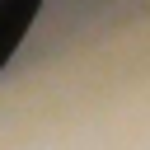
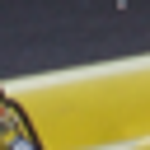
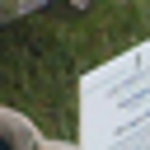
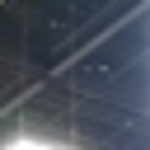
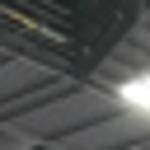
...
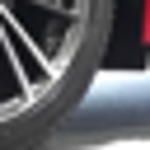
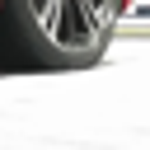
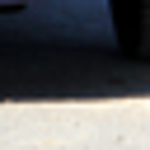
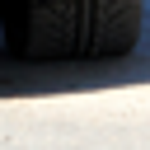
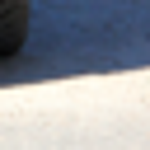

[2367, 4073, 4074, 4084, 4085, 4086, 7961, 8365, 12705, 12706, 12719, 12732, 12745, 12758, 12771, 13521, 14010, 17426, 17438, 17450, 17462, 17474, 17486, 18570, 18571, 19717, 19728, 19729, 19730, 19731, 19740, 19741, 19742, 19743, 19750, 19751, 19753, 19754, 19763, 19764, 19765, 20042, 20055, 21074, 21075, 21085, 21095, 22931, 22932, 22933, 22934, 22944, 22945, 24069, 24070, 24071, 24528, 24529, 24540, 24754, 25015, 25016, 25018, 25020, 25021, 25022, 25024, 25292, 25293, 25294, 25295, 25296, 25297, 25298, 25299, 25300, 25301, 25302, 25303, 25307, 25308, 25309, 25310, 25311, 25312, 25313, 25314, 25315, 25316, 25321, 25322, 25323, 25326, 25327, 25328, 25329, 25342, 25458, 25673, 25674, 25677, 25680, 25687, 25688, 25689, 25690, 25691, 25692, 25693, 25699, 25700, 25701, 25702, 25703, 25704, 25713, 26162, 26163, 26164, 26171, 26172, 26173, 26174, 26175, 26176, 26177, 26186, 26187, 26391, 26392, 26405, 26409, 26418, 26419, 26420, 26735, 26759, 26762, 26769, 26770, 27222, 27223, 27224, 27228,


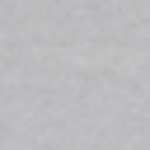
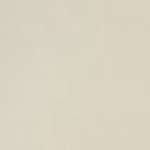
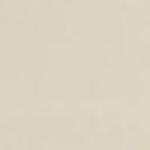
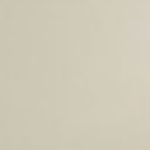
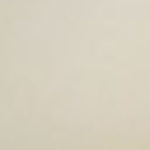
...
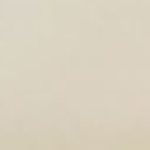
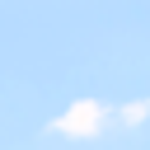
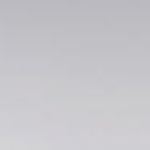
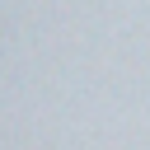
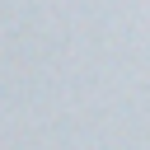

[0, 413, 448, 600, 794, 899, 998, 1002, 1075, 1819, 2027, 2028, 2032, 2053, 2213, 2391, 2407, 2435, 2460, 2539, 2908, 2919, 3008, 3039, 3201, 3294, 3735, 3896, 4230, 4329, 4406, 4498, 4508, 4536, 4592, 4689, 4729, 4911, 5120, 5137, 5186, 5380, 5468, 5905, 5953, 6034, 6060, 6132, 6526, 6530, 6531, 6980, 7071, 7090, 7174, 7185, 7191, 7301, 7314, 7718, 7827, 7848, 7877, 8151, 8478, 8508, 8637, 8661, 8913, 9363, 9490, 9509, 9782, 10018, 10042, 10098, 10202, 10211, 10788, 10834, 11407, 11534, 11619, 11653, 12002, 12041, 12070, 12501, 12525, 12634, 12635, 12652, 12663, 12687, 12894, 12937, 13170, 13279, 13285, 13295, 13314, 13324, 13341, 13688, 13711, 13744, 14283, 14301, 14557, 15013, 15028, 15334, 15542, 15555, 15558, 15567, 15571, 15580, 15581, 15597, 15917, 15969, 16030, 16036, 16038, 16039, 16042, 16047, 16048, 16056, 16062, 16088, 16089, 16093, 16113, 16119, 16129, 16201, 16261, 16357, 16501, 16819, 17101, 17254, 17335, 17336, 17337, 17455, 17511, 17589, 17602, 17625, 17629, 17630, 176


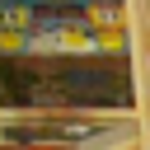
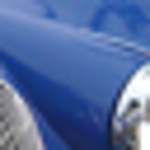
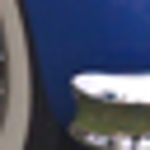
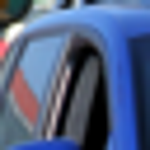
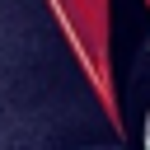
...
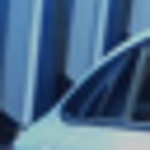
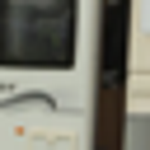
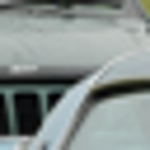
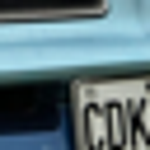
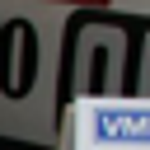

[254, 262, 333, 334, 335, 398, 399, 556, 623, 624, 752, 788, 1003, 1004, 1007, 1018, 1031, 1036, 1037, 1129, 1130, 1131, 1664, 1695, 1713, 1717, 1718, 1719, 1771, 1926, 1927, 1930, 1931, 1932, 1933, 1934, 1935, 1936, 1948, 1949, 1957, 1958, 2059, 2061, 2062, 2063, 2064, 2076, 2149, 2176, 2187, 2188, 2201, 2339, 2374, 2544, 2545, 2546, 2554, 2558, 2559, 2560, 2576, 2588, 2602, 2604, 2617, 2671, 2902, 2912, 2927, 2930, 3018, 3098, 3100, 3101, 3321, 3651, 3679, 3948, 3970, 3972, 3973, 3974, 4429, 4430, 4937, 4938, 4951, 5471, 5954, 5968, 5969, 5970, 5986, 5987, 5992, 6000, 6001, 6005, 6123, 6143, 6178, 6181, 6182, 6183, 6357, 6371, 6561, 6589, 6617, 7034, 7035, 7036, 7037, 7084, 7085, 7285, 7318, 7328, 7329, 7331, 7332, 7333, 7334, 7661, 7671, 7672, 7673, 7677, 7678, 7679, 7680, 7906, 7908, 7915, 7925, 8050, 8111, 8210, 8211, 8212, 8213, 8222, 8631, 8675, 8676, 8693, 8696, 8698, 8701, 8704, 8705, 8706, 8708, 8709, 8710, 8712, 8713, 8714, 8715, 8717, 8718, 8719, 8720, 9242, 9386, 9524, 969


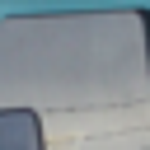
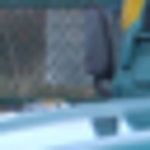
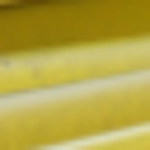
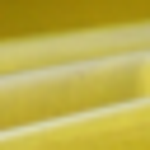
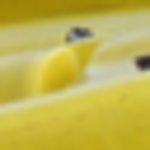
...
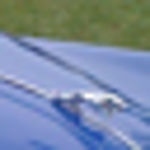
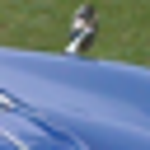
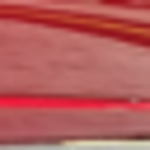
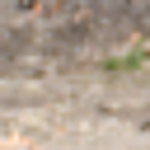
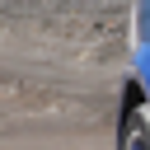

[21, 578, 1579, 1590, 2349, 2508, 2514, 2515, 2519, 2520, 3718, 3719, 3720, 3721, 3723, 3724, 4893, 4896, 4899, 6008, 6009, 6010, 6011, 6012, 6019, 6020, 6385, 6386, 6387, 6388, 6389, 6391, 7157, 7158, 7169, 7690, 7707, 7708, 7710, 7711, 7712, 9051, 9141, 9143, 9157, 9475, 9487, 9991, 10012, 10013, 10014, 10015, 10419, 10757, 10758, 10759, 10760, 10761, 10762, 10763, 10764, 10765, 10766, 10767, 10769, 10984, 11507, 11508, 11854, 11855, 11856, 11862, 14022, 14028, 15290, 15291, 17048, 17058, 17062, 17063, 17064, 17585, 19769, 19782, 19784, 19786, 19791, 19792, 19794, 19799, 19800, 19802, 19806, 19807, 20771, 20772, 20773, 20774, 20775, 20776, 20779, 21068, 22797, 22798, 22800, 22801, 22802, 22803, 22804, 22805, 22806, 22807, 24073, 24074, 24075, 24076, 24077, 24078, 24079, 24080, 24081, 24082, 24083, 24084, 24085, 24086, 24092, 25031, 25426, 26103, 26198, 26206, 26422, 26423, 26426, 26427, 26428, 27193, 27220, 27221, 27297, 27945, 27946, 28247, 28257, 28350, 28380, 28950, 28951, 28952, 


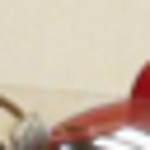
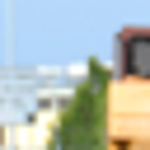
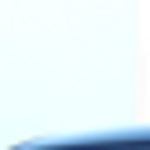
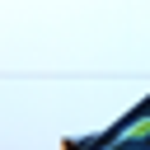
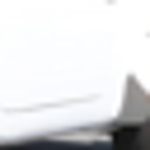
...
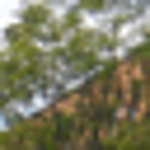
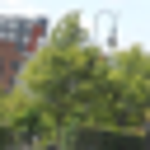
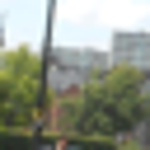
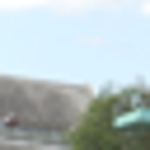
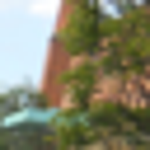

[1114, 1452, 1453, 1480, 2018, 3151, 3154, 3663, 4196, 4204, 4660, 4661, 4662, 5451, 6157, 8250, 8361, 8362, 8363, 8573, 8587, 8588, 8601, 8740, 9006, 9866, 9867, 9883, 10174, 10593, 10595, 12700, 12716, 12865, 12866, 13210, 14023, 14762, 14763, 14783, 15285, 15286, 15292, 15293, 15298, 15299, 15313, 15320, 16405, 16406, 16416, 16980, 17431, 17441, 17443, 17444, 17453, 17456, 17457, 17460, 18563, 18564, 18565, 18566, 18578, 18579, 18580, 18594, 18595, 19697, 20585, 20778, 22936, 22938, 22939, 22940, 22943, 22956, 24916, 24920, 24924, 24926, 25027, 25030, 25203, 25204, 25213, 25218, 25219, 25223, 25233, 25237, 25238, 25682, 25696, 25697, 25974, 25975, 25987, 25988, 25997, 26516, 26517, 26529, 26530, 26531, 26538, 26544, 26545, 26546, 26553, 26690, 26880, 26881, 26897, 26988, 27251, 27252, 27662, 27663, 27665, 27787, 27788, 27789, 27802, 27804, 27805, 27807, 27808, 27824, 28055, 28056, 28070, 28071, 28072, 28143, 28149, 28150, 28156, 28157, 28165, 28186, 28469, 28470, 28471, 28479, 28490


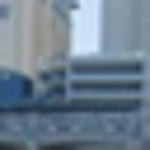
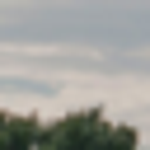
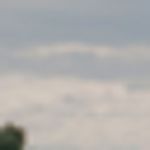
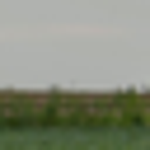
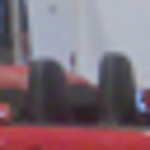
...
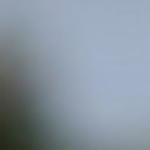
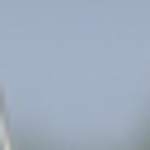
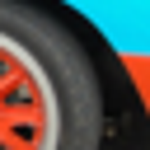
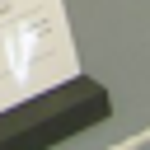
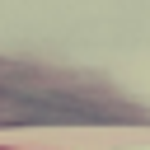

[143, 353, 355, 1211, 1213, 1214, 1733, 1754, 1764, 1765, 1766, 1767, 1776, 1777, 1778, 1779, 1780, 1973, 2262, 2263, 2264, 2270, 2271, 2275, 2276, 2278, 2314, 2330, 2331, 2334, 2474, 3202, 3574, 3587, 3757, 4775, 4782, 4793, 4892, 4921, 5112, 5886, 7162, 7288, 7724, 7737, 7740, 7752, 7753, 8511, 8512, 8519, 9043, 9069, 9472, 9499, 9500, 9966, 9979, 10354, 10414, 10415, 10416, 10417, 10418, 10421, 10427, 10428, 10429, 10432, 10433, 10434, 10435, 10436, 10437, 10438, 10440, 10441, 10442, 10447, 11126, 11127, 11128, 11129, 11593, 11605, 11618, 11790, 11866, 12610, 12611, 12624, 13664, 13665, 13666, 13672, 13680, 13685, 14372, 14384, 14405, 14417, 14427, 14430, 14436, 14440, 14441, 14449, 14465, 14467, 14468, 14477, 14480, 14482, 14490, 14491, 14492, 14631, 14632, 14915, 14918, 14920, 14927, 14933, 14946, 14959, 14960, 14967, 14968, 14970, 14971, 14974, 14980, 14981, 14984, 14985, 15672, 15673, 15674, 15675, 15678, 15682, 15683, 15684, 15685, 15686, 15687, 15688, 15695, 15698, 15699, 1571


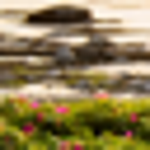
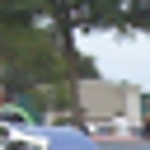
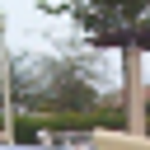
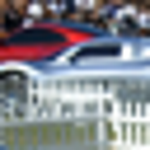
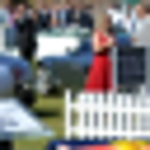
...
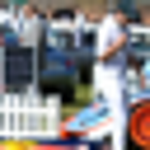
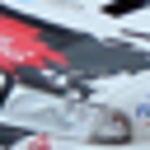
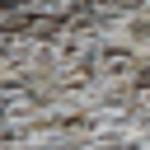
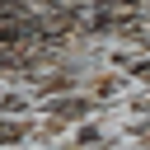
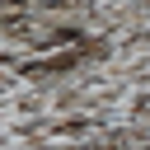

[255, 268, 279, 764, 858, 860, 862, 872, 1116, 1117, 1756, 2058, 2060, 2065, 2069, 2072, 2077, 2078, 2091, 2115, 2613, 2788, 2789, 2790, 2801, 2802, 2962, 2987, 2988, 3000, 3004, 3005, 3049, 3057, 3097, 3107, 3638, 3639, 3644, 3985, 3987, 4214, 4596, 4597, 4996, 5243, 5245, 5396, 5397, 5408, 5421, 5435, 5543, 5544, 6369, 7304, 7307, 7308, 7435, 7438, 7452, 7481, 7482, 7855, 7856, 7895, 7904, 7905, 7912, 7938, 7944, 8128, 8181, 8594, 8595, 8597, 8598, 8985, 8991, 9563, 9576, 9589, 9590, 9602, 9614, 9615, 9712, 9725, 10866, 11238, 11241, 11242, 11245, 11247, 11249, 11303, 11742, 11743, 11966, 12140, 12144, 12146, 12147, 12153, 12154, 12155, 12162, 12163, 12164, 12165, 12166, 12171, 12172, 12174, 12175, 12181, 12182, 12183, 12189, 12190, 12191, 12192, 12198, 12199, 12318, 12319, 12327, 12328, 12333, 12335, 12336, 12337, 12338, 12341, 12343, 12344, 12345, 12346, 12347, 12349, 12351, 12352, 12355, 12357, 12359, 12360, 12361, 12362, 12363, 12367, 12369, 12370, 12371, 12372, 12373, 12375, 123


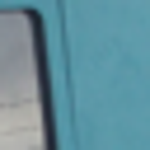
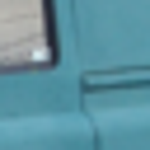
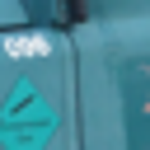
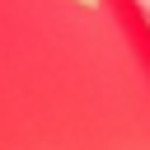
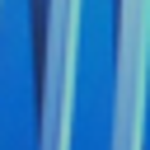
...
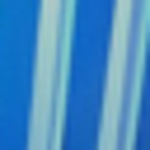
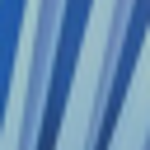
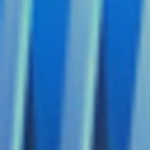
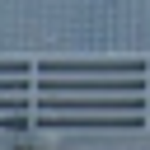
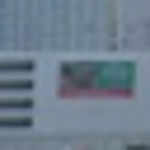

[96, 319, 750, 1095, 1187, 1405, 1420, 1668, 1671, 1758, 1759, 1799, 1800, 1881, 1890, 1994, 2237, 2238, 2239, 2240, 2241, 2608, 2633, 2704, 2705, 2707, 2708, 2709, 2710, 2711, 2712, 2714, 2845, 2854, 2992, 2999, 3177, 3179, 3272, 3344, 3414, 3476, 3477, 3485, 3489, 3631, 3917, 3918, 3919, 3927, 3928, 3929, 4052, 4176, 4177, 4178, 4266, 4267, 4268, 4270, 4284, 4285, 4449, 4450, 4520, 4521, 5100, 5189, 5190, 5523, 5634, 5867, 5869, 5957, 5958, 5959, 5974, 5975, 6228, 6230, 6376, 6716, 6775, 6776, 6777, 6906, 7008, 7022, 7023, 7024, 7025, 7256, 7257, 7416, 7417, 7418, 7419, 7420, 7421, 7422, 7423, 7424, 7425, 7426, 7427, 7657, 7665, 7806, 7807, 7808, 7809, 8044, 8186, 8187, 8188, 8189, 8318, 8319, 8320, 8321, 8633, 8634, 8783, 8784, 8785, 8786, 8787, 8788, 8841, 8842, 8843, 8884, 8891, 8892, 9126, 9127, 9130, 9374, 9375, 9459, 9534, 9579, 9753, 9768, 9843, 9844, 9941, 9942, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10075, 10076, 10077, 10078, 10079, 10143, 10150, 10736, 10737, 108


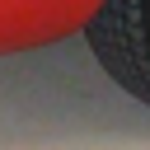
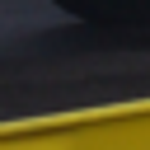
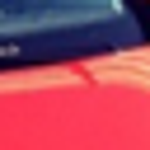
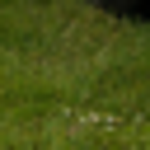
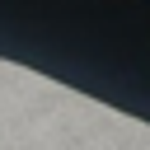
...
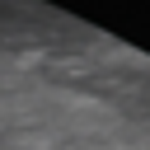
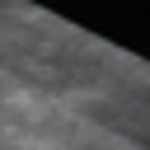
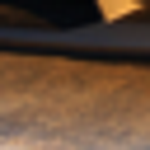
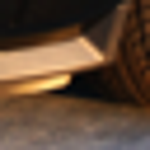
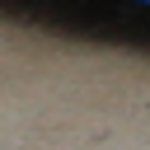

[90, 100, 101, 774, 777, 3138, 3139, 3140, 3141, 3142, 4169, 4170, 4181, 5865, 5866, 8326, 8327, 8328, 8329, 8330, 8331, 8332, 8333, 8334, 8335, 8336, 8337, 8338, 8339, 8340, 8341, 8342, 8343, 8344, 8345, 8346, 8347, 8348, 8349, 8350, 8351, 8678, 8679, 8680, 8681, 8682, 8683, 8684, 8685, 8686, 8687, 8694, 8904, 8978, 10529, 12567, 12568, 12847, 12848, 12850, 13152, 13158, 16390, 16391, 16392, 16393, 16394, 16395, 16396, 16397, 16401, 16402, 16403, 16410, 17205, 17233, 17234, 17242, 17285, 17292, 19628, 19629, 19630, 19724, 19725, 19726, 19738, 19739, 19758, 19759, 19760, 20549, 22261, 23433, 23434, 24512, 24513, 24514, 24515, 24516, 24522, 24523, 24525, 24526, 24527, 24646, 24647, 24648, 24988, 25795, 25796, 25807, 25808, 25817, 25818, 25819, 26627, 26628, 26629, 26638, 26643, 26644, 26648, 26649, 26650, 26656, 26657, 26658, 26798, 26956, 26957, 26958, 26959, 26960, 26961, 26962, 26963, 26976, 26977, 26980, 27412, 27413, 27414, 27415, 27416, 27417, 27418, 27420, 27421, 27529, 27530, 27


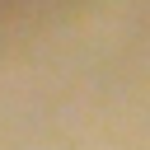
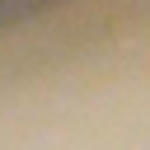
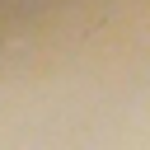
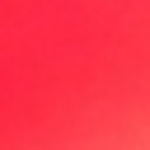
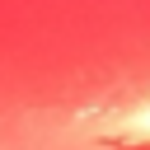
...
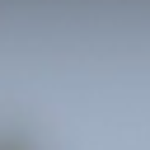
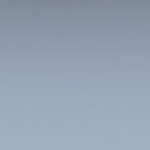
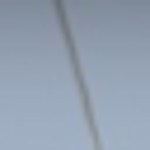
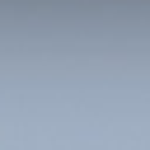
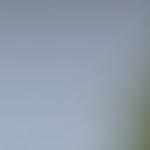

[835, 985, 1087, 1235, 1248, 1261, 1262, 1326, 1327, 1337, 1338, 1351, 1429, 1442, 1846, 2747, 2981, 2982, 3120, 3133, 3146, 3147, 3159, 3160, 3172, 3173, 3174, 3185, 3186, 3245, 3254, 3259, 3260, 3266, 3458, 3459, 3460, 3461, 3462, 3463, 3465, 3466, 3564, 3565, 3566, 3580, 3592, 3593, 3605, 3606, 4380, 4391, 4393, 4400, 5195, 6268, 6271, 6272, 6273, 6281, 6286, 6363, 6696, 6697, 6919, 6936, 6997, 7010, 7047, 7138, 7139, 7140, 7141, 7142, 7143, 7232, 7240, 7392, 7412, 7413, 7414, 7786, 7787, 8599, 8762, 8764, 8774, 8775, 8777, 8803, 8804, 8816, 8817, 8830, 8858, 8872, 8885, 8886, 8898, 8899, 8936, 9014, 9024, 9025, 9026, 9027, 9028, 9029, 9030, 9031, 9032, 9036, 9037, 9038, 9040, 9220, 9415, 9416, 9428, 9429, 9440, 9442, 9451, 9452, 9453, 9464, 9465, 9755, 9832, 9845, 10540, 10562, 10601, 10619, 10636, 10724, 10927, 10928, 10940, 10993, 11017, 11018, 11019, 11020, 11021, 11022, 11023, 11024, 11025, 11026, 11027, 11028, 11029, 11032, 11044, 11045, 11057, 11062, 11070, 11071, 11072, 1107


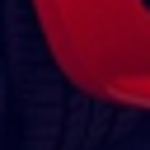
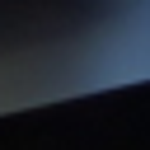
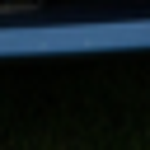
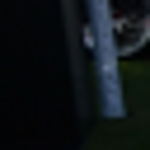
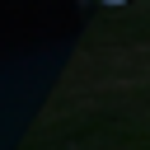
...
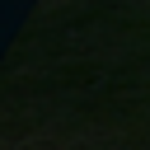
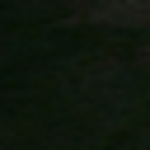
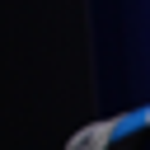
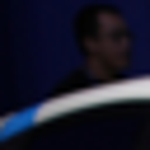
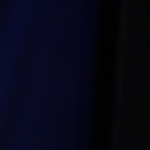

[330, 513, 590, 707, 797, 932, 1060, 1061, 1062, 1476, 1736, 1855, 1879, 2166, 2358, 2359, 2361, 2362, 3073, 3216, 3217, 3447, 3448, 3449, 3455, 3673, 3759, 3760, 3794, 3915, 4015, 4101, 4110, 4269, 4273, 4558, 4621, 4678, 4969, 5061, 5110, 5111, 5152, 5164, 5487, 5489, 5508, 5520, 5685, 5686, 5817, 5818, 5826, 6023, 6110, 6152, 6156, 6196, 6327, 6492, 6494, 6736, 6894, 6955, 6956, 6991, 7161, 7290, 7369, 7552, 7746, 7747, 8029, 8030, 8031, 8301, 8382, 8404, 8488, 8526, 8618, 8627, 8628, 9073, 9082, 9084, 9133, 9134, 9135, 9139, 9156, 9360, 9827, 9828, 10126, 10127, 10152, 10502, 10503, 10504, 10505, 10506, 10683, 10770, 10771, 10772, 10773, 10774, 10775, 10777, 10778, 10779, 10780, 10782, 10843, 10844, 10858, 10891, 10892, 10999, 11093, 11455, 11712, 11713, 11714, 11715, 11808, 11936, 12837, 12839, 12941, 12961, 13402, 13822, 14555, 15090, 16145, 16146, 16194, 16195, 16196, 16230, 16239, 16773, 16802, 17131, 17134, 17366, 17367, 18048, 18166, 20715, 21462, 22794, 23018, 23019, 23192, 


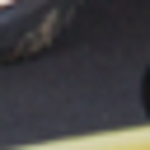
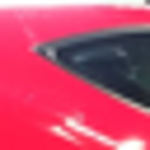
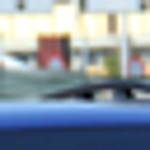
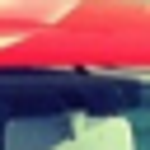
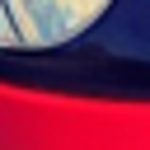
...
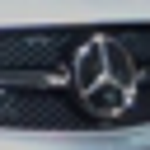
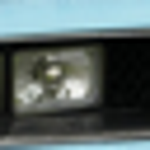
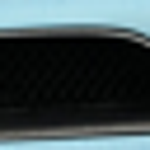
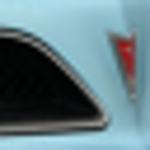
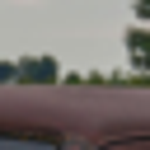

[523, 842, 843, 844, 852, 853, 854, 855, 1273, 1286, 1299, 1302, 1315, 1319, 1320, 1321, 1322, 1324, 1677, 1678, 1679, 1680, 1681, 1682, 1690, 1691, 1692, 1693, 1694, 1703, 1704, 1705, 1716, 1772, 2233, 2234, 2235, 2244, 2245, 2246, 2247, 2248, 2249, 2250, 2251, 2252, 2253, 2254, 2255, 2256, 2257, 2258, 2259, 2260, 2261, 2571, 2574, 2585, 2586, 2615, 2618, 2621, 2622, 2623, 2624, 2816, 3091, 3099, 3102, 3111, 3112, 4746, 4747, 4759, 4760, 4761, 5434, 5979, 5993, 5994, 6070, 6097, 6483, 7557, 7558, 8610, 9627, 10784, 11200, 11213, 11215, 11595, 11647, 11732, 11734, 11735, 11737, 11738, 11745, 11749, 11750, 12254, 12262, 12267, 12456, 12457, 12460, 12461, 12465, 12466, 12467, 12473, 12474, 12479, 12480, 12481, 12482, 12483, 12486, 12490, 12499, 12503, 12516, 13109, 13122, 13135, 13147, 13148, 13360, 13373, 13374, 13377, 13383, 13384, 13385, 13386, 13387, 13388, 13389, 13393, 13394, 13395, 13423, 13424, 13428, 13429, 13438, 13444, 13448, 13449, 13454, 13458, 13490, 13491, 13500, 13539, 14


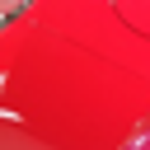
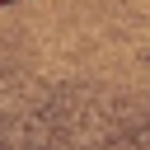
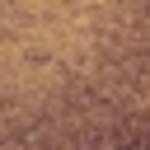
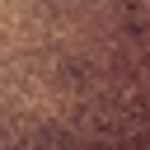
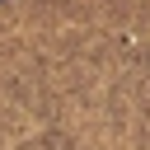
...
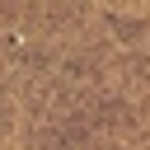
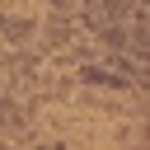
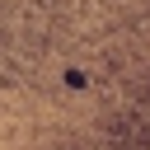
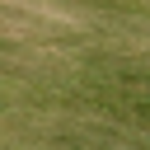
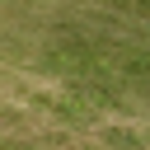

[1144, 1451, 1464, 1481, 2016, 2019, 3168, 3652, 3963, 4008, 4097, 4108, 4222, 4659, 5232, 5450, 5452, 8249, 8355, 8356, 8366, 8367, 8379, 8596, 8603, 8604, 8605, 8606, 8614, 8615, 8616, 9631, 9865, 9874, 9875, 9876, 9877, 9905, 10159, 11267, 11442, 11500, 12699, 12715, 13172, 13190, 13198, 13398, 13399, 14761, 14773, 15283, 15284, 15288, 15289, 15294, 15295, 15296, 15297, 15300, 15301, 15317, 15327, 15415, 15416, 15428, 15453, 15494, 15506, 16407, 17015, 17244, 17245, 17428, 17430, 17439, 17440, 17442, 17451, 17452, 17454, 17729, 18560, 18561, 18562, 18572, 18573, 19237, 20068, 20345, 20346, 22054, 22935, 22937, 22946, 22947, 22948, 22957, 24446, 24914, 25023, 25026, 25028, 25029, 25202, 25221, 25222, 25234, 25239, 25291, 25324, 25325, 25591, 25698, 25867, 25889, 25986, 25998, 26036, 26253, 26528, 26536, 26541, 26549, 26552, 26565, 27238, 27357, 27557, 27664, 27666, 27667, 27803, 27806, 28054, 28060, 28061, 28062, 28065, 28141, 28154, 28159, 28166, 28179, 28467, 28468, 28472, 28473, 2


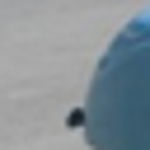
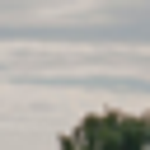
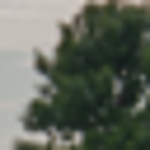
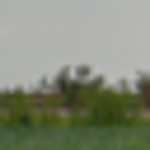
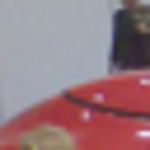
...
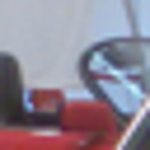
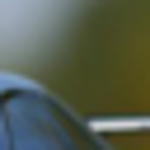
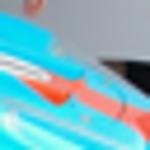
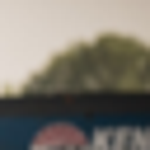
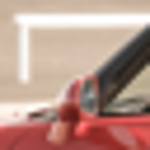

[62, 83, 290, 536, 629, 701, 856, 857, 866, 920, 984, 1013, 1026, 1191, 1398, 1414, 1612, 1613, 1844, 2388, 2592, 2593, 2824, 3024, 3054, 3074, 3193, 3205, 3218, 3366, 3533, 3544, 3892, 3895, 4023, 4030, 4031, 4068, 4358, 4362, 4365, 4505, 4610, 4909, 4961, 5067, 5078, 5132, 5165, 5484, 5491, 5497, 5504, 5507, 5755, 5847, 5849, 6163, 6193, 6348, 6497, 6690, 6753, 6840, 6852, 6861, 6897, 7126, 7194, 7209, 7377, 7779, 8023, 8034, 8294, 8415, 8530, 8907, 8999, 9066, 9298, 9307, 9400, 9401, 9412, 9413, 9424, 9425, 9444, 9565, 9659, 9666, 9751, 9829, 9918, 9919, 10597, 10609, 10826, 10869, 10979, 10986, 10991, 11000, 11263, 11269, 11438, 11444, 11447, 11451, 11512, 11642, 12059, 12312, 12497, 12509, 12517, 12526, 12534, 12535, 12667, 12677, 12680, 12988, 13001, 13683, 13798, 13806, 13841, 13842, 13850, 14304, 14306, 14586, 14599, 14750, 14830, 15156, 15488, 15500, 15501, 15511, 15512, 15524, 15630, 15716, 15867, 15895, 15896, 16092, 16156, 16234, 16235, 16245, 16750, 17993, 18049, 18207, 18


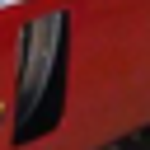
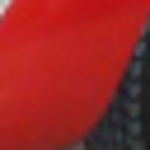
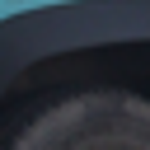
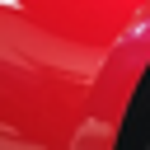
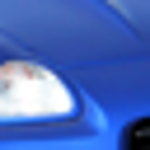
...
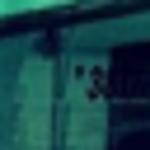
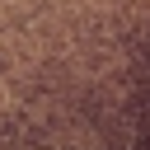
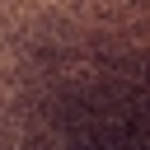
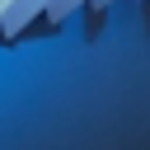
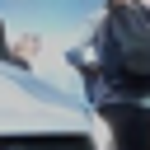

[74, 328, 430, 431, 432, 445, 464, 475, 477, 615, 616, 617, 734, 745, 806, 816, 823, 952, 960, 961, 1067, 1074, 1103, 1134, 1289, 1301, 1308, 1316, 1317, 1434, 1485, 1505, 1506, 1532, 1543, 1544, 1550, 1551, 1648, 1760, 1882, 1885, 1887, 1899, 1900, 1907, 1921, 2130, 2142, 2173, 2221, 2222, 2243, 2469, 2652, 2702, 2833, 2846, 2855, 3038, 3178, 3180, 3199, 3200, 3219, 3221, 3222, 3223, 3345, 3654, 3804, 3836, 3976, 4131, 4142, 4283, 4286, 4928, 5011, 5014, 5017, 5019, 5021, 5079, 5080, 5099, 5105, 5179, 5460, 5633, 6224, 6225, 6226, 6229, 6231, 6232, 6233, 6234, 6235, 6237, 6241, 6274, 6275, 6276, 6277, 6278, 6289, 6291, 6502, 6503, 6510, 6702, 6757, 6758, 6768, 6962, 7120, 7145, 7249, 7258, 7262, 7404, 7510, 7535, 7536, 7550, 7656, 7716, 7832, 7846, 7847, 8303, 8304, 8435, 8436, 8438, 8439, 8468, 8469, 8480, 8619, 8635, 8636, 8782, 8917, 9080, 9107, 9117, 9118, 9300, 9324, 9341, 9379, 9582, 9592, 9593, 9595, 9723, 9756, 9767, 9778, 9779, 9780, 9826, 9839, 9841, 10080, 10136, 10200, 102


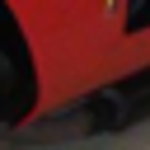
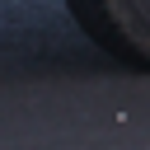
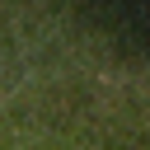
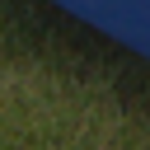
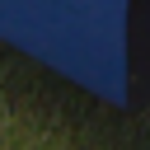
...
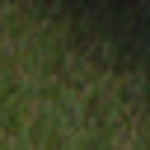
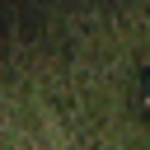
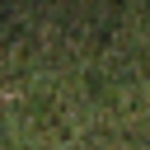
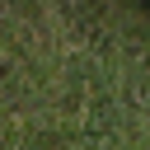
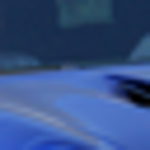

[1, 14, 222, 234, 486, 499, 580, 593, 662, 1575, 1583, 1588, 1598, 2273, 2286, 2299, 3428, 3441, 3705, 3769, 3993, 4070, 4083, 5125, 5210, 5222, 5237, 5251, 5488, 5766, 5779, 5820, 6133, 6146, 6159, 6419, 6434, 6447, 6458, 6460, 6525, 6826, 7092, 7430, 7480, 7564, 7567, 7574, 7580, 7583, 7727, 8074, 8390, 9247, 9395, 9473, 9486, 9606, 9619, 9762, 9810, 9970, 10162, 10175, 10444, 10461, 10646, 10659, 10672, 10955, 10968, 11412, 11991, 12003, 12010, 12017, 12031, 12043, 12049, 12056, 12082, 12586, 12744, 12762, 12763, 12770, 12786, 12969, 13396, 13494, 13504, 13569, 13585, 13595, 13626, 13633, 13639, 13649, 13778, 14015, 14016, 14024, 14357, 14518, 14657, 16523, 16628, 16658, 17043, 17129, 17313, 17400, 17401, 17414, 17728, 17800, 18154, 18175, 18518, 18526, 18530, 18881, 18959, 18972, 19058, 19071, 19078, 19091, 19365, 19400, 19401, 19414, 19593, 19601, 19626, 19634, 19642, 19655, 19656, 19716, 19762, 19975, 20153, 20154, 20160, 20173, 20180, 20186, 20187, 20199, 20212, 20225, 20238, 20


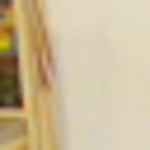
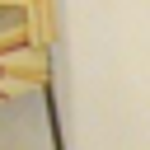
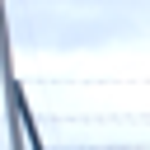
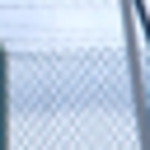
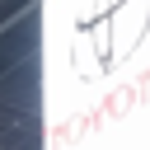
...
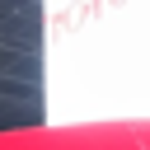
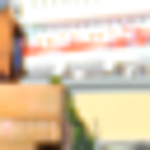
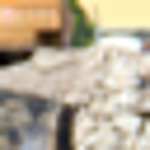
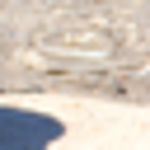
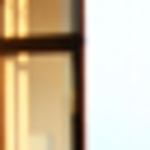

[358, 360, 362, 1741, 1773, 1774, 1775, 2265, 2266, 2267, 2268, 2269, 2279, 2280, 2281, 2282, 2292, 2293, 2294, 2295, 2298, 2301, 2482, 2483, 2495, 2533, 2534, 2610, 2611, 2636, 2637, 2638, 2649, 2650, 2651, 4355, 4369, 4370, 4383, 4384, 4743, 4744, 4745, 4755, 4756, 4757, 4758, 4762, 4763, 4765, 4766, 4767, 4768, 4769, 4770, 4776, 4777, 4778, 4792, 5353, 5354, 5368, 6031, 6032, 6033, 6044, 7005, 8653, 9327, 10186, 10279, 10285, 10445, 10446, 10786, 11003, 11599, 11851, 11852, 11912, 12260, 12270, 13657, 13658, 13659, 13660, 13661, 13662, 13663, 13673, 13674, 13675, 13676, 13678, 13679, 13973, 14379, 14380, 14381, 14382, 14383, 14386, 14387, 14390, 14391, 14392, 14393, 14394, 14396, 14397, 14400, 14401, 14402, 14403, 14404, 14406, 14407, 14408, 14409, 14410, 14411, 14412, 14413, 14414, 14415, 14416, 14418, 14419, 14423, 14426, 14428, 14429, 14431, 14432, 14433, 14434, 14435, 14442, 14443, 14444, 14445, 14446, 14447, 14448, 14454, 14455, 14456, 14457, 14458, 14459, 14460, 14461, 14464, 


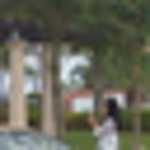
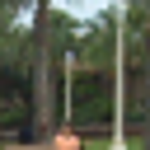
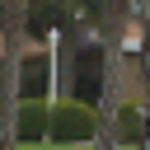
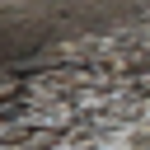
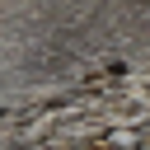
...
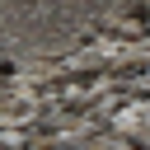
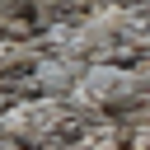
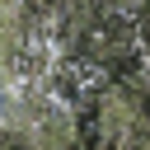
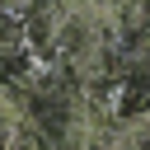
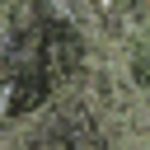

[34, 54, 155, 167, 351, 357, 368, 370, 382, 438, 596, 597, 609, 610, 652, 719, 905, 1059, 1376, 1720, 1851, 1972, 2151, 2277, 2288, 2289, 2290, 2303, 2325, 2326, 2395, 2563, 2598, 2612, 2625, 3015, 3417, 3429, 3431, 3442, 3763, 3982, 3995, 3996, 4484, 4492, 4669, 4670, 4783, 4806, 4811, 4823, 4859, 4907, 4908, 4934, 4949, 5150, 5292, 5333, 5349, 5657, 5671, 5704, 5786, 5806, 5807, 5835, 5889, 5890, 5892, 5903, 5908, 5909, 5910, 6056, 6138, 6139, 6140, 6142, 6528, 6539, 6847, 6968, 7175, 7187, 7287, 7299, 7335, 7501, 7572, 7576, 7577, 7578, 7579, 7595, 7602, 7725, 7726, 7738, 7739, 7750, 7870, 7875, 7888, 8066, 8080, 8082, 8093, 8095, 8115, 8197, 8502, 8516, 9041, 9042, 9044, 9226, 9246, 9260, 9526, 10003, 10023, 10025, 10026, 10028, 10035, 10039, 10099, 10100, 10113, 10654, 10667, 10783, 10876, 11582, 11584, 11585, 11586, 11648, 11651, 11729, 11796, 11871, 11875, 11924, 11973, 11974, 11987, 12177, 12274, 12286, 12287, 12299, 12612, 12614, 12615, 12778, 12862, 12874, 12875, 13077, 13116


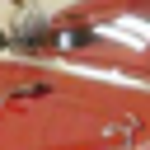
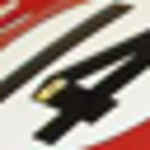
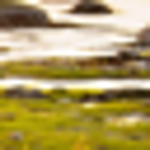
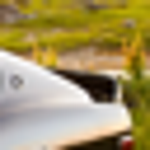
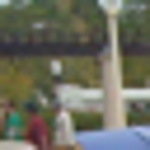
...
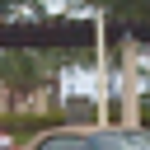
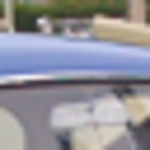
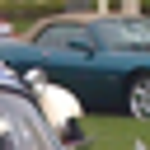
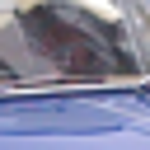
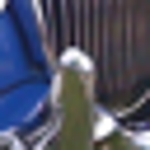

[43, 97, 240, 241, 242, 266, 311, 342, 343, 344, 374, 377, 510, 527, 528, 614, 739, 756, 913, 937, 1005, 1136, 1202, 1229, 1230, 1231, 1483, 1673, 1830, 1911, 1928, 1929, 2047, 2048, 2049, 2148, 2170, 2179, 2242, 2397, 2523, 2547, 2665, 2677, 2706, 2772, 2773, 2774, 2775, 2776, 2777, 2821, 2898, 2899, 2900, 2901, 2917, 2918, 3003, 3087, 3088, 3089, 3300, 3301, 3308, 3497, 3498, 3528, 3738, 3739, 3748, 3780, 3781, 3975, 3991, 4044, 4051, 4054, 4486, 4548, 4550, 4552, 4637, 4686, 4704, 4732, 4789, 4798, 4994, 4995, 5026, 5027, 5054, 5155, 5187, 5356, 5398, 5940, 5988, 5989, 6125, 6184, 6310, 6311, 6321, 6330, 6342, 6559, 6624, 6713, 6714, 6877, 6890, 7026, 7039, 7040, 7168, 7546, 7849, 7850, 7871, 7890, 7891, 8042, 8047, 8135, 8198, 8386, 8388, 8479, 8667, 8670, 8671, 8673, 8824, 8839, 8840, 8889, 8890, 9523, 9682, 9683, 9684, 9916, 10047, 10048, 10050, 10116, 10117, 10118, 10158, 10258, 10332, 10508, 10842, 11217, 11418, 11419, 11760, 11784, 11785, 11786, 11787, 11788, 11815, 11816, 118


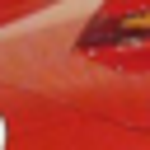
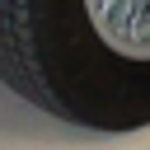
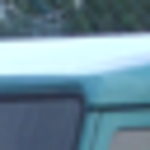
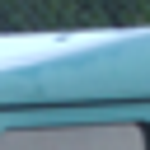
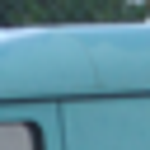
...
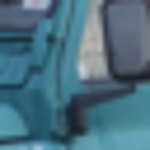
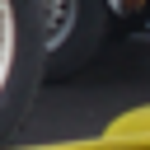
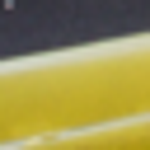
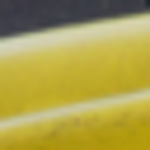
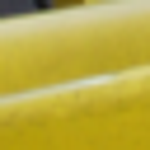

[761, 773, 3600, 4187, 4188, 4189, 4190, 4191, 4192, 4193, 8547, 8548, 8549, 8550, 8551, 8552, 8553, 8554, 8555, 8560, 8561, 8562, 8563, 8564, 8565, 8566, 8567, 8568, 8569, 8579, 8580, 9856, 9857, 9858, 9859, 9871, 9872, 16388, 16389, 22217, 24394, 24395, 24396, 24397, 24398, 24399, 24400, 24401, 24402, 24403, 24404, 24405, 24406, 24410, 24411, 24412, 24413, 24414, 24415, 24416, 24417, 24418, 24419, 24427, 24428, 24429, 24430, 24431, 24432, 24979, 24980, 24981, 24982, 24983, 24984, 24985, 24987, 24989, 24990, 24991, 25785, 25786, 25787, 25788, 25789, 25790, 25791, 25792, 25793, 25794, 25798, 25799, 25800, 25801, 25802, 25803, 25804, 25805, 25806, 25812, 25813, 25814, 25815, 25816, 26273, 26274, 26275, 26276, 26277, 26278, 26287, 26288, 26289, 26290, 26291, 26302, 26303, 26304, 26315, 26316, 26317, 26328, 26329, 26330, 26338, 26339, 26340, 26341, 26342, 26343, 26348, 26351, 26352, 26353, 26354, 26355, 26356, 26358, 26363, 26364, 26365, 26366, 26367, 26368, 26369, 26370, 26371, 26372, 26


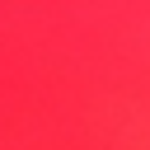
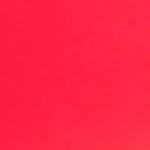
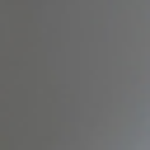
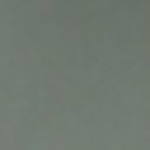
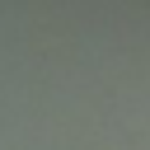
...
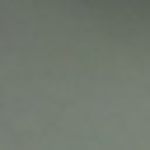
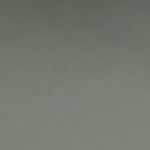
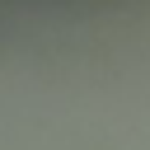
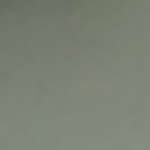
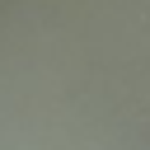

[131, 133, 140, 142, 152, 166, 621, 622, 635, 636, 648, 649, 676, 682, 917, 1033, 1034, 1035, 1046, 1047, 1139, 1444, 1448, 1970, 2189, 2340, 2341, 2342, 2351, 2352, 2355, 2364, 2365, 2376, 2599, 2683, 2685, 2686, 3433, 3434, 3435, 3680, 3681, 3682, 3683, 3684, 3685, 3686, 3691, 3692, 3693, 3694, 3695, 3696, 3697, 3698, 3699, 3700, 3701, 3702, 3703, 3704, 3749, 4060, 4061, 4332, 4428, 4454, 4514, 4836, 4851, 4863, 4864, 4865, 4866, 4867, 4868, 4869, 4870, 4871, 4872, 4873, 4874, 4875, 4876, 4882, 4883, 4886, 4887, 5241, 5428, 5430, 5431, 5442, 5479, 5557, 5558, 5563, 5573, 5574, 5575, 5589, 5616, 5629, 6136, 6137, 6724, 6876, 6889, 6900, 6913, 6915, 7082, 7083, 7097, 7098, 7326, 7597, 7599, 8237, 8299, 8312, 8324, 8534, 8546, 8711, 9147, 9269, 9271, 9383, 9398, 9545, 9686, 9687, 10038, 10041, 10337, 10392, 10393, 10394, 10395, 10396, 10397, 10398, 10399, 10405, 10497, 10510, 10511, 10643, 10648, 10674, 10679, 10680, 11413, 11415, 11416, 11583, 11636, 11719, 11720, 11721, 11722, 11723, 


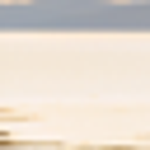
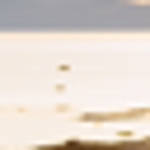
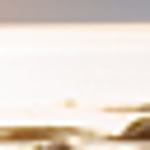
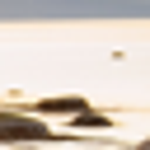
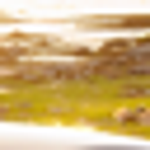
...
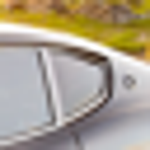
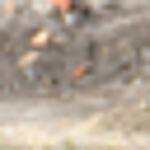
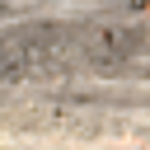
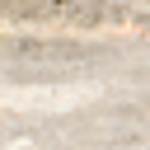
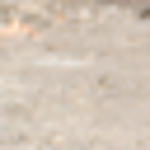

[288, 302, 309, 315, 433, 599, 646, 660, 731, 807, 972, 1251, 1365, 1403, 1636, 1637, 1649, 1821, 1834, 1873, 2041, 2795, 3523, 3624, 3826, 4412, 4530, 5002, 5022, 5447, 5551, 5611, 5649, 5653, 5709, 6108, 6332, 6798, 6799, 6811, 6812, 6824, 6825, 6837, 6850, 6880, 6898, 7101, 7112, 7389, 7402, 7804, 8259, 8273, 8400, 8639, 8796, 8963, 8976, 8989, 9212, 9482, 9571, 9757, 10219, 10248, 10558, 10588, 10600, 10613, 10885, 11105, 11273, 11311, 11321, 11398, 11691, 12143, 12227, 12265, 12285, 12520, 12533, 12692, 12973, 13076, 13092, 13093, 13123, 13136, 13176, 13202, 13366, 13379, 13783, 13802, 13885, 13909, 13935, 14049, 14074, 14084, 14087, 14088, 14122, 14254, 14255, 14264, 14273, 14282, 14291, 14300, 14309, 14310, 14318, 14319, 14328, 14353, 14362, 14570, 14572, 14677, 15510, 15568, 15602, 15615, 15668, 15949, 16429, 16559, 16572, 16578, 16906, 17360, 17692, 18234, 18459, 18838, 18856, 18869, 18923, 18936, 18963, 19292, 19297, 19305, 19476, 19560, 19651, 19664, 19665, 19690, 19980, 200


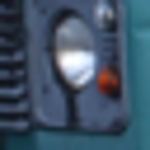
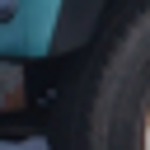
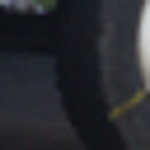
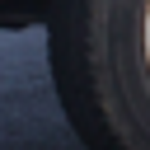
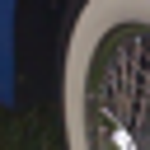
...
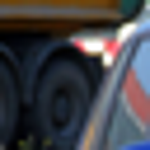
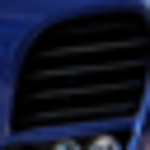
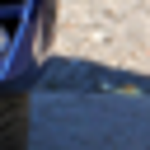
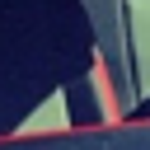
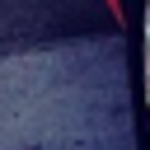

[292, 408, 421, 434, 539, 540, 553, 785, 1242, 1269, 1285, 1298, 1410, 1582, 1974, 2082, 2183, 2196, 2660, 2690, 2799, 2822, 2887, 3028, 3044, 3095, 3108, 3313, 3315, 3326, 3621, 3642, 3884, 3897, 3910, 4593, 4711, 4714, 4827, 4839, 6085, 7376, 7729, 7929, 7942, 8022, 8851, 8903, 9240, 9364, 9559, 9650, 9884, 9898, 9908, 10559, 10938, 11133, 11192, 11205, 11359, 11362, 11525, 11532, 11533, 11547, 11628, 11641, 12134, 12179, 12502, 12528, 13085, 13151, 13153, 13187, 13209, 13212, 13222, 13250, 13282, 13289, 13403, 13425, 13435, 14849, 15015, 15167, 15168, 15181, 15184, 15189, 15194, 15197, 15202, 15207, 15220, 15342, 15355, 15356, 15455, 15468, 15885, 15891, 16178, 16422, 16425, 16449, 16476, 17200, 17213, 17248, 17257, 17852, 17945, 18314, 18320, 18325, 18331, 18337, 18338, 18348, 18349, 18364, 18397, 18402, 18458, 18950, 19061, 20045, 20058, 20061, 20074, 20538, 20539, 21866, 21874, 21879, 21984, 22223, 22224, 22237, 22238, 22244, 22252, 22260, 22266, 22279, 22280, 22477, 22544, 22755


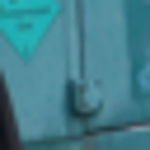
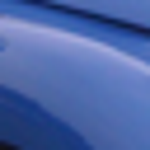
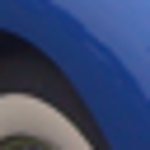
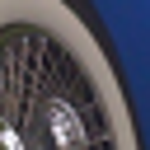
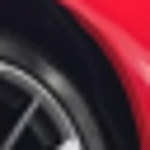
...
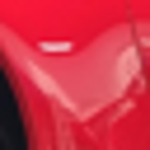
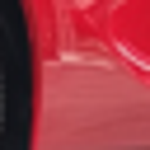
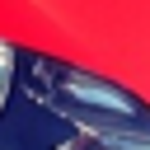
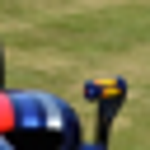
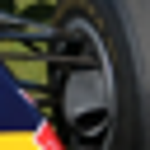

[61, 180, 291, 316, 422, 435, 459, 478, 627, 721, 767, 768, 781, 782, 808, 821, 884, 922, 940, 1072, 1168, 1238, 1256, 1270, 1283, 1284, 1411, 1416, 1509, 1595, 1726, 1739, 1820, 2023, 2031, 2036, 2093, 2106, 2107, 2120, 2209, 2225, 2227, 2403, 2405, 2409, 2481, 2808, 2814, 2940, 2954, 2968, 2984, 3026, 3298, 3311, 3318, 3325, 3331, 3360, 3502, 3655, 3656, 3732, 3893, 4002, 4038, 4243, 4244, 4245, 4533, 4620, 4693, 4694, 4710, 4717, 4741, 4848, 4940, 4955, 4978, 4992, 5167, 5171, 5172, 5301, 5314, 5316, 5375, 5376, 5404, 5502, 5681, 5731, 5740, 5803, 5845, 5938, 5952, 6042, 6088, 6199, 6318, 6323, 6336, 6347, 6533, 6552, 6565, 6689, 6790, 6843, 6987, 7001, 7181, 7200, 7204, 7761, 7778, 8140, 8164, 8220, 8267, 8272, 8410, 8413, 8414, 8422, 8621, 8624, 8652, 8850, 8877, 8912, 8926, 9098, 9186, 9196, 9655, 9657, 9662, 9837, 9920, 10017, 10096, 10205, 10206, 10305, 10542, 10544, 10697, 10714, 10850, 10851, 11049, 11148, 11151, 11157, 11229, 11236, 11375, 11449, 11517, 11535, 11678, 11747, 


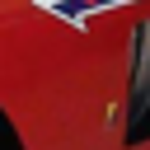
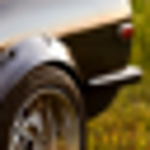
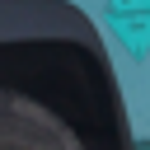
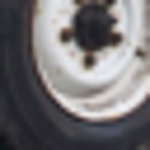
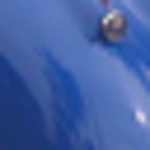
...
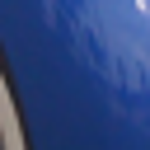
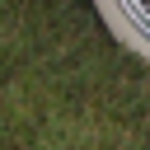
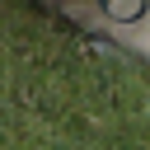
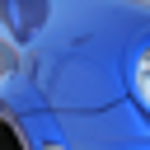
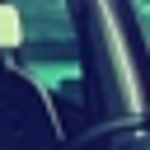

[259, 272, 283, 390, 484, 963, 1132, 1157, 1260, 1625, 1638, 1894, 1903, 2090, 2195, 2223, 2945, 2951, 2964, 2977, 3020, 3033, 3072, 3143, 3156, 3316, 3340, 3351, 3353, 3596, 4017, 4067, 4121, 4134, 4161, 4226, 5003, 5016, 5059, 5344, 6176, 6188, 6189, 6201, 6828, 7351, 7364, 7507, 7520, 7624, 7637, 7651, 7730, 7927, 8184, 8238, 8239, 8261, 8417, 8973, 9286, 9308, 9388, 9405, 9457, 9643, 9733, 9900, 10532, 10561, 10704, 10707, 10717, 10730, 10743, 10867, 11195, 11244, 11250, 11256, 11257, 11291, 11304, 11310, 11459, 11663, 11980, 12321, 12330, 12429, 12496, 12521, 12530, 12569, 12698, 12711, 12712, 12724, 13150, 13159, 13181, 13200, 13213, 13216, 13217, 13226, 13230, 13243, 13260, 13290, 13417, 14034, 14047, 14060, 14073, 14086, 14099, 14774, 14792, 14874, 15310, 15359, 15466, 15467, 15491, 15518, 15664, 15834, 15907, 15920, 15945, 16127, 16128, 16140, 16426, 16439, 16678, 16704, 16989, 17002, 17223, 17253, 17263, 17267, 17286, 17925, 17957, 18114, 18294, 18305, 18339, 18344, 18350, 18


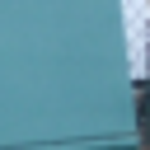
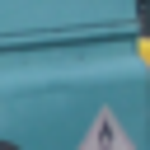
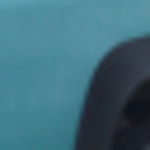
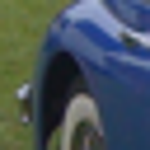
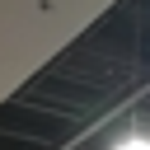
...
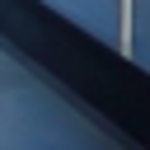
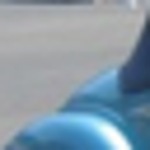
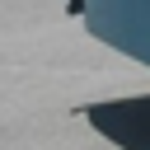
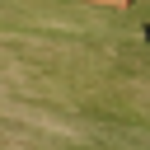
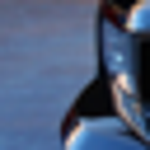

[92, 352, 383, 428, 501, 546, 547, 637, 650, 666, 902, 931, 1000, 1021, 1048, 1133, 1373, 1374, 1665, 1722, 2026, 2145, 2322, 2328, 2336, 2356, 2363, 2577, 2676, 3504, 3514, 3526, 3661, 3674, 3675, 3752, 3796, 4348, 4418, 4485, 4808, 4837, 4850, 4852, 5117, 5126, 5305, 5433, 5467, 5480, 5617, 5630, 5661, 5676, 5742, 5800, 5821, 5822, 6041, 6081, 6082, 6358, 6433, 6450, 6543, 6961, 7087, 7313, 7324, 7590, 7723, 8008, 8106, 8118, 8144, 8157, 8158, 8313, 8506, 8521, 9059, 9060, 9136, 9235, 9261, 9532, 9678, 9775, 9893, 10034, 10237, 10238, 10467, 10499, 10514, 10813, 10973, 10974, 11296, 11374, 11400, 11409, 11655, 11706, 11888, 11915, 11925, 11943, 11958, 12009, 12013, 12019, 12022, 12074, 12151, 12176, 12187, 12250, 12751, 12755, 12774, 12907, 12920, 13101, 13104, 13117, 13127, 13130, 13293, 13457, 13467, 13478, 13488, 13780, 13913, 14332, 14645, 14646, 14835, 14848, 15051, 15077, 15102, 15114, 15124, 15151, 15433, 15446, 15447, 15595, 15596, 15796, 15805, 15806, 16046, 16077, 16109, 16


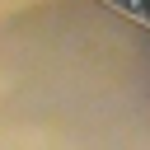
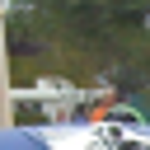
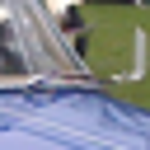
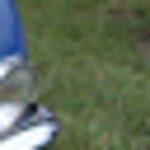
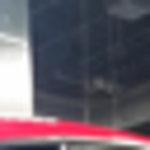
...
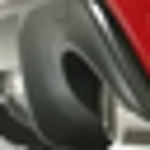
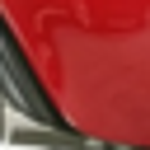
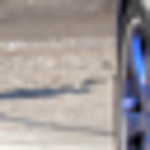
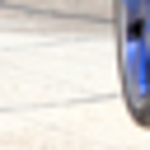
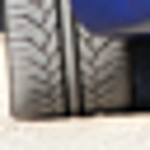

[94, 95, 338, 555, 771, 786, 826, 827, 828, 890, 1118, 1172, 1173, 1696, 1697, 1698, 1699, 1721, 1954, 1961, 2123, 2177, 2200, 2220, 2674, 2882, 3077, 3319, 3320, 3515, 3671, 3672, 3677, 3678, 3867, 3868, 3869, 3870, 3871, 3934, 3935, 3936, 3937, 3938, 3943, 3944, 3945, 3946, 3947, 3971, 4126, 4595, 4696, 4712, 4828, 4829, 4830, 4952, 4958, 4959, 5039, 5043, 5280, 5294, 5465, 5466, 5809, 6062, 6065, 6066, 6067, 6068, 6129, 6130, 6131, 6355, 6481, 6727, 6857, 7086, 7277, 7281, 7293, 7487, 7488, 7489, 7490, 7531, 7537, 7660, 7676, 7945, 8046, 8216, 8372, 8373, 8853, 8875, 8897, 8931, 9664, 9770, 9921, 9922, 10220, 10221, 10530, 10531, 10698, 10829, 10868, 11119, 11363, 11489, 11490, 11776, 11783, 11909, 11926, 12006, 12713, 12785, 12857, 13086, 13087, 13241, 13266, 13269, 13271, 13274, 13484, 13492, 13526, 13527, 13528, 14528, 14674, 14775, 14812, 15002, 15035, 15036, 15057, 15221, 15237, 15343, 15590, 15775, 15776, 15957, 16017, 16024, 16025, 16676, 17135, 17177, 17197, 17198, 17199, 17


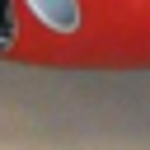
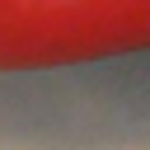
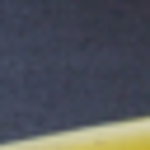
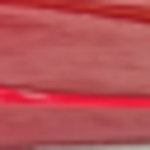
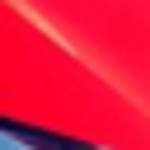
...
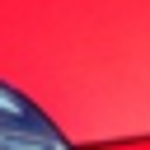
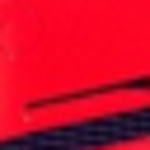
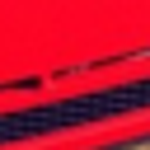
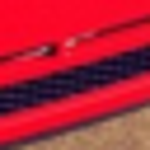
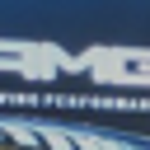

[321, 322, 323, 329, 340, 667, 668, 669, 670, 903, 1023, 1358, 1359, 1360, 1560, 1631, 1632, 1880, 1914, 2319, 2459, 2582, 2607, 2609, 2762, 2896, 3189, 3309, 3413, 3415, 3491, 3584, 3669, 3670, 3820, 3889, 4047, 4048, 4298, 4320, 4321, 4398, 4452, 4453, 4538, 4539, 4632, 4787, 4853, 4854, 4855, 4856, 4857, 4932, 5035, 5036, 5461, 5635, 5646, 5991, 6077, 6126, 6127, 6128, 6300, 6375, 6377, 6378, 6412, 6515, 6708, 6709, 6710, 6964, 6965, 7057, 7059, 7060, 7367, 7368, 7370, 7371, 7372, 7373, 7776, 8486, 8487, 8493, 8537, 8538, 8672, 8894, 9128, 9129, 9251, 9252, 9262, 9264, 9368, 9369, 9370, 9494, 9518, 9612, 9671, 9672, 9673, 9892, 9943, 10030, 10321, 10324, 10363, 10375, 10376, 10377, 10382, 10383, 10384, 10459, 10515, 10804, 10805, 10929, 10930, 10931, 10936, 11036, 11037, 11108, 11109, 11110, 11111, 11112, 11113, 11114, 11115, 11116, 11117, 11118, 11138, 11283, 11308, 11456, 11457, 11614, 11709, 11710, 11711, 11716, 11782, 11947, 12073, 12215, 12218, 12447, 13273, 13897, 13901, 13914


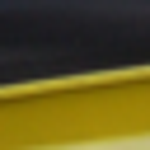
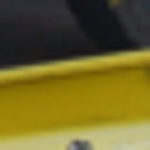
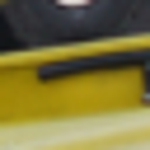
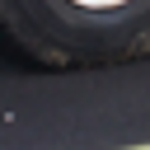
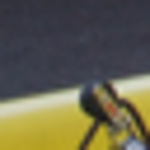
...
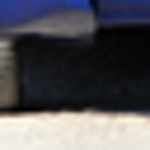
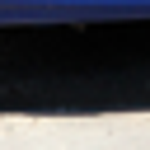
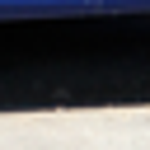
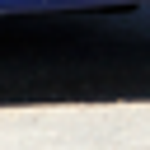
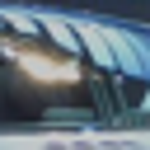

[13, 380, 861, 863, 874, 906, 930, 988, 997, 1016, 1017, 1019, 1020, 1032, 1584, 1597, 1708, 1709, 1836, 1837, 1842, 2081, 2092, 2162, 2167, 2190, 2202, 2327, 2536, 2684, 2879, 2880, 3751, 3762, 3969, 3986, 4004, 4006, 4027, 4069, 4218, 4231, 4235, 4500, 4501, 4655, 4658, 5160, 5221, 5427, 5441, 5454, 5555, 5556, 5569, 5576, 5658, 5785, 5997, 5998, 6003, 6004, 6145, 6158, 6173, 6174, 6436, 6437, 6445, 6446, 6540, 6728, 6739, 6870, 6888, 6901, 6902, 7429, 7440, 7441, 7454, 7573, 7585, 7586, 7601, 7608, 7609, 7636, 7831, 7844, 7857, 7869, 7882, 7886, 7887, 7990, 8011, 8014, 8086, 8087, 8101, 8129, 8218, 8226, 8532, 9243, 9244, 9245, 9255, 9256, 9257, 9258, 9259, 9270, 9529, 9737, 10640, 10649, 10651, 10652, 10653, 10662, 10663, 10671, 11501, 11503, 11622, 11634, 11635, 11650, 11741, 11977, 11986, 12011, 12033, 12062, 12066, 12067, 12081, 12149, 12158, 12186, 12241, 12266, 12275, 12583, 12585, 12666, 12766, 12767, 12779, 12790, 12856, 12861, 12869, 12873, 13297, 13372, 13436, 13503, 13533


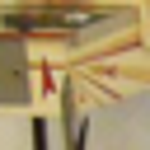
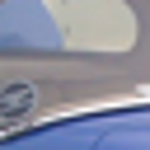
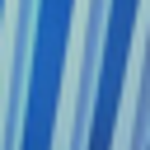
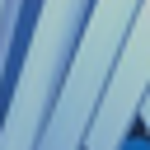
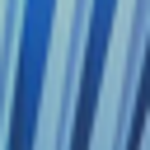
...
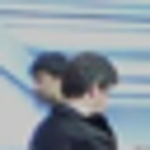
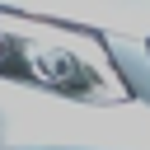
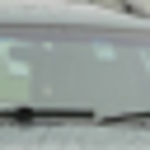
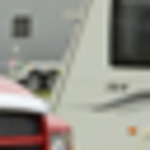
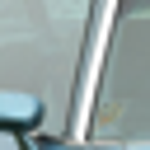

[60, 187, 504, 633, 703, 939, 1027, 1041, 1056, 1057, 1071, 1194, 1224, 1237, 1341, 1342, 1379, 1394, 1396, 1397, 1408, 1465, 1862, 2834, 3135, 3150, 3163, 3164, 3167, 3426, 3536, 3664, 3787, 4032, 4330, 4360, 4361, 4368, 4374, 4381, 4382, 4962, 5345, 5474, 5501, 5708, 5711, 5712, 5725, 5726, 5739, 5753, 6194, 6200, 6722, 6893, 7213, 8275, 8276, 8586, 8608, 8623, 8860, 8873, 8874, 8900, 8901, 8902, 9420, 9421, 9553, 9694, 9822, 9823, 9882, 10045, 10589, 10590, 10591, 10607, 10711, 10793, 10887, 10980, 10981, 11079, 11434, 11435, 11448, 11450, 12060, 12311, 12506, 12511, 12524, 12527, 12538, 12546, 12657, 12701, 12986, 12999, 13163, 13604, 13617, 13630, 13631, 13644, 13645, 13801, 13839, 13840, 13849, 13939, 13993, 14111, 14751, 15312, 15318, 15844, 15898, 15899, 15911, 15912, 16238, 16251, 16491, 16556, 16580, 16593, 16752, 16766, 16780, 16781, 16782, 17137, 17996, 19467, 19468, 19469, 19481, 19691, 20339, 20348, 20349, 20768, 20864, 20866, 21071, 21082, 21369, 21422, 22257, 22451, 234


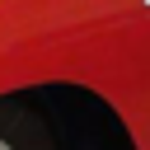
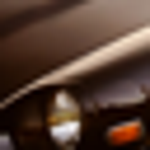
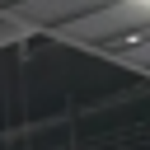
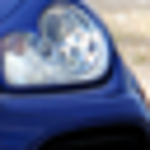
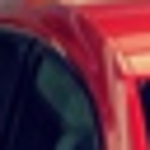
...
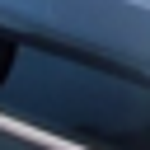
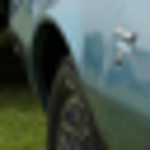
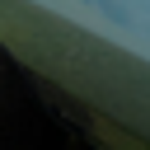
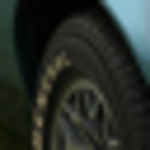
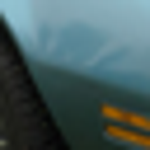

[172, 286, 287, 303, 310, 446, 465, 497, 552, 586, 640, 729, 735, 738, 795, 912, 1014, 1064, 1065, 1068, 1267, 1277, 1280, 1281, 1412, 1421, 1569, 1608, 1653, 1751, 1808, 1876, 1888, 2212, 2230, 2308, 2398, 2416, 2434, 2446, 2447, 2494, 2583, 2596, 2597, 2713, 2809, 3281, 3282, 3285, 3288, 3292, 3299, 3310, 3312, 3424, 3453, 3454, 3457, 3488, 3561, 3585, 3745, 4140, 4166, 4301, 4372, 4479, 4481, 4489, 4535, 4591, 4624, 4636, 4739, 4785, 4786, 4846, 5075, 5118, 5147, 5192, 5407, 5420, 5564, 5567, 5590, 5606, 5607, 5656, 5662, 5668, 5669, 5827, 5832, 5920, 5949, 6293, 6306, 6308, 6322, 6615, 6669, 6721, 6834, 6835, 6910, 6959, 6960, 6966, 7031, 7236, 7728, 7765, 7853, 7872, 8177, 8202, 8208, 8233, 8284, 8289, 8387, 8394, 8396, 8459, 8465, 8542, 8810, 8823, 9132, 9170, 9172, 9183, 9340, 9493, 9639, 9668, 9669, 9670, 10094, 10148, 10196, 10236, 10292, 10317, 10330, 10500, 10555, 10837, 10846, 10919, 10925, 11143, 11146, 11160, 11166, 11168, 11170, 11198, 11324, 11394, 11518, 11879, 12239, 


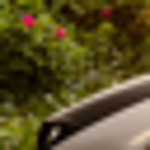
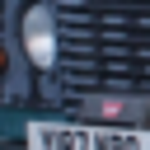
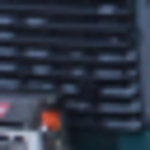
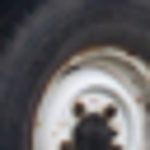
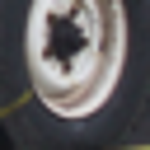
...
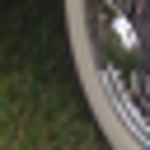
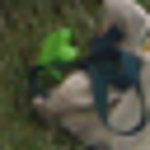
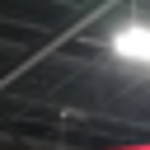
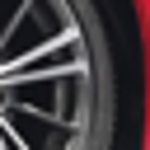
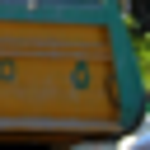

[193, 201, 313, 314, 517, 657, 658, 659, 716, 822, 836, 956, 959, 1055, 1088, 1222, 1253, 1328, 1362, 1378, 1424, 1524, 1527, 1539, 1634, 1635, 1657, 1658, 1785, 1804, 1833, 1847, 1866, 2418, 2428, 2429, 2439, 2441, 2442, 2443, 2444, 2452, 2453, 2455, 2456, 2465, 2478, 2492, 2628, 2694, 2748, 2756, 2838, 2839, 3208, 3237, 3242, 3251, 3255, 3261, 3468, 3469, 3470, 3481, 3482, 3483, 3495, 3508, 3509, 3522, 3535, 3575, 3610, 3623, 3839, 4261, 4262, 4291, 4292, 4309, 4310, 4311, 4313, 4314, 4396, 4411, 4442, 4470, 4723, 4931, 5184, 5388, 5580, 5605, 5620, 5695, 5722, 5735, 5736, 5750, 5934, 5947, 6207, 6218, 6266, 6296, 6305, 6329, 6511, 6538, 6608, 6658, 6659, 6660, 6661, 6662, 6675, 6681, 6685, 6706, 6733, 6749, 6750, 6755, 6804, 6807, 6809, 6823, 6865, 6879, 6922, 6946, 7000, 7078, 7144, 7211, 7214, 7217, 7218, 7219, 7223, 7224, 7227, 7228, 7230, 7231, 7238, 7241, 7251, 7741, 7744, 7756, 7759, 7772, 7774, 7782, 7800, 7801, 7817, 7839, 8279, 8282, 8307, 8308, 8421, 8424, 8425, 8426, 8463


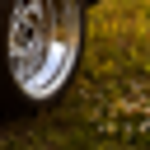
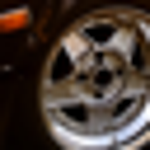
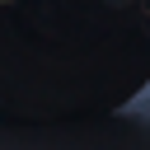
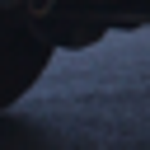
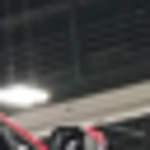
...
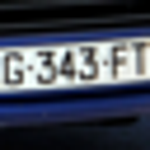
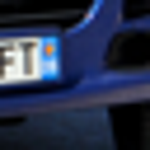
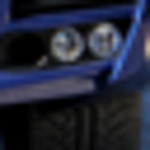
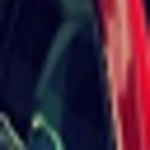
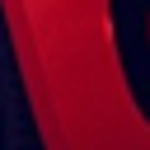

[33, 44, 55, 175, 264, 367, 371, 372, 373, 375, 393, 394, 395, 396, 543, 618, 696, 753, 802, 804, 830, 876, 914, 992, 1006, 1010, 1011, 1228, 1232, 1233, 1310, 1311, 1400, 1401, 1477, 1482, 1605, 1669, 1745, 1868, 1870, 1877, 1912, 1916, 1917, 1918, 1919, 1920, 1922, 1923, 1966, 1967, 1985, 1986, 1987, 2042, 2175, 2392, 2531, 2532, 2555, 2654, 2659, 2663, 2791, 2933, 2934, 3040, 3302, 3303, 3304, 3305, 3306, 3307, 3456, 3518, 3737, 3902, 3949, 4010, 4011, 4012, 4021, 4043, 4103, 4116, 4117, 4118, 4229, 4242, 4682, 4687, 4688, 4804, 4818, 4943, 4944, 4945, 4946, 5151, 5156, 5163, 5320, 5330, 5347, 5363, 5365, 5366, 5825, 5860, 5976, 5977, 6017, 6024, 6026, 6047, 6048, 6049, 6050, 6051, 6052, 6053, 6054, 6055, 6105, 6151, 6153, 6169, 6185, 6312, 6441, 6442, 6496, 6585, 6586, 6592, 6957, 6974, 7004, 7018, 7291, 7292, 7294, 7295, 7498, 7511, 7512, 7513, 7514, 7515, 7516, 7517, 7615, 7616, 7617, 7618, 7619, 7652, 7889, 7893, 8035, 8107, 8132, 8133, 8145, 8147, 8148, 8178, 8243, 8263, 8290, 


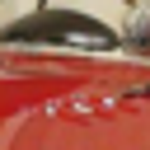
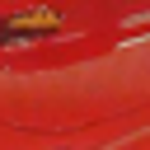
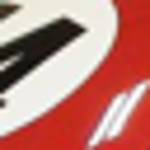
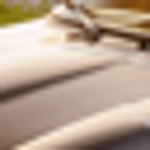
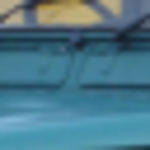
...
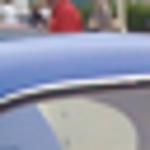
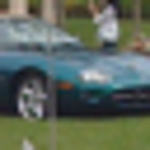
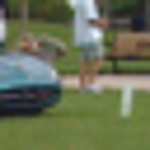
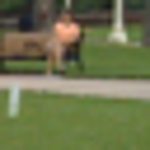
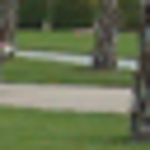

[299, 312, 317, 496, 643, 793, 820, 971, 1070, 1204, 1265, 1336, 1402, 1427, 1521, 1796, 2144, 2765, 2825, 2837, 3206, 3210, 3534, 3603, 3609, 3784, 3837, 3838, 3850, 4377, 4394, 4625, 4652, 4975, 5175, 5193, 5652, 5654, 5751, 5933, 5944, 6217, 6253, 6254, 6267, 6501, 6691, 6759, 6767, 6772, 6784, 6785, 6793, 6841, 7121, 7122, 7132, 7203, 7226, 7239, 7252, 7390, 7717, 7771, 7781, 8305, 8428, 8462, 8755, 8756, 8933, 8934, 8987, 9000, 9104, 9120, 9123, 9204, 9287, 9361, 9389, 9390, 9414, 9432, 9766, 9807, 9820, 9821, 9834, 9928, 9931, 10119, 10239, 10281, 10545, 10548, 10556, 10572, 10585, 10598, 10611, 10623, 10624, 10882, 10992, 11234, 11270, 11289, 11331, 11338, 11382, 11383, 11396, 11690, 12505, 12518, 12522, 12523, 12542, 12547, 12572, 12574, 12594, 12954, 13066, 13773, 13819, 13855, 13862, 13867, 13871, 13873, 13881, 13882, 13883, 13893, 13941, 13956, 14048, 14080, 14092, 14093, 14106, 14139, 14146, 14156, 14159, 14165, 14169, 14179, 14182, 14190, 14192, 14209, 14216, 14222, 14234,


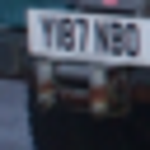
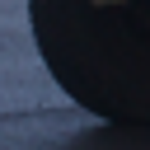
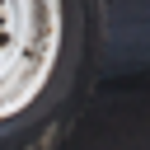
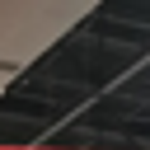
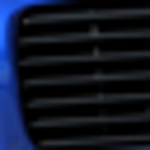
...
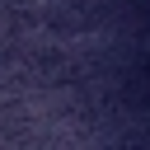
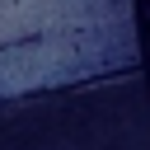
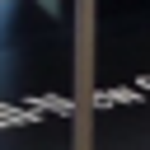
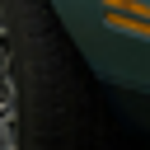
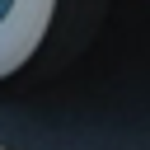

[72, 297, 492, 550, 654, 690, 714, 723, 724, 934, 935, 948, 967, 1009, 1069, 1073, 1082, 1252, 1282, 1330, 1331, 1332, 1354, 1356, 1390, 1391, 1409, 1647, 1652, 1761, 1795, 2401, 2415, 2433, 2437, 2471, 2476, 2635, 2664, 2758, 2807, 2820, 2952, 2965, 3027, 3037, 3275, 3278, 3280, 3284, 3286, 3291, 3293, 3410, 3601, 3633, 3740, 3741, 3805, 3977, 4016, 4149, 4150, 4305, 4306, 4341, 4354, 4371, 4404, 4409, 4410, 4413, 4423, 4432, 4469, 4476, 4487, 4528, 4605, 4638, 4673, 4720, 4749, 4750, 4953, 4966, 4967, 5073, 5074, 5135, 5146, 5322, 5357, 5565, 5578, 5642, 5643, 5719, 5802, 5823, 5829, 5830, 5919, 5964, 6292, 6294, 6307, 6314, 6316, 6361, 6557, 6558, 6663, 6664, 6677, 6678, 6679, 6688, 6730, 6734, 6748, 6800, 6802, 6810, 6815, 6816, 6822, 6866, 6892, 6948, 7053, 7100, 7111, 7182, 7195, 7221, 7250, 7263, 7264, 7755, 7757, 7794, 8257, 8258, 8260, 8280, 8292, 8293, 8393, 8460, 8466, 8474, 8477, 8494, 8799, 8821, 8825, 8826, 8827, 8828, 8856, 8867, 9078, 9079, 9090, 9091, 9198, 9211, 9213,


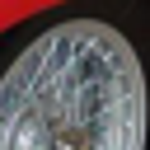
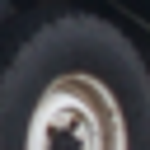
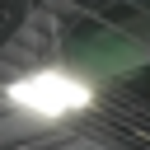
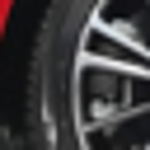
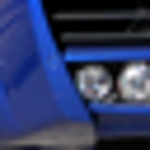
...
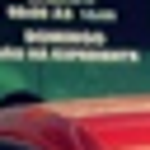
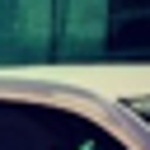
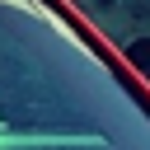
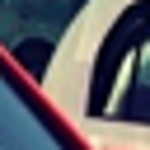
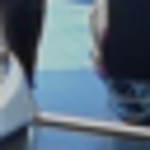

[19, 25, 467, 480, 500, 1166, 1446, 1458, 1459, 1568, 1581, 1600, 2039, 2343, 2680, 2687, 3436, 3725, 3764, 3768, 3770, 3776, 3777, 3783, 5930, 6093, 6398, 6399, 6474, 6487, 6500, 6742, 6827, 6859, 6871, 6872, 6884, 8131, 8171, 8251, 8300, 9295, 9488, 9748, 9803, 9812, 9816, 10172, 10335, 10493, 10494, 10681, 10694, 10950, 10963, 11322, 11387, 11668, 11858, 11860, 11863, 11970, 11992, 12001, 12781, 12962, 12972, 12975, 12985, 13114, 13525, 13705, 13807, 14044, 14077, 14323, 14351, 14369, 14533, 14536, 15472, 15620, 16159, 16479, 16646, 16659, 16672, 16685, 16698, 16711, 16724, 16737, 17052, 17059, 17071, 17078, 17083, 17143, 17345, 17475, 17499, 17610, 19133, 19368, 19448, 19732, 19795, 20017, 20056, 20069, 20152, 20184, 20204, 20217, 20230, 20243, 20256, 20269, 20274, 20282, 20465, 20719, 20743, 21077, 21087, 21096, 21353, 21373, 21383, 21445, 21464, 21466, 22354, 22356, 22363, 23033, 23035, 23045, 23098, 23295, 23682, 23689, 23851, 23864, 23877, 24026, 24039, 24356, 24369, 25592, 267


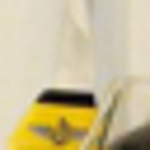
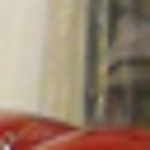
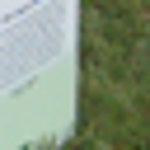
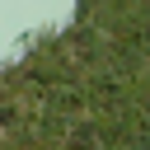
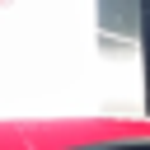
...
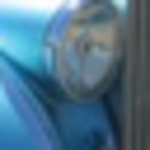
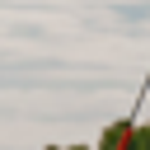
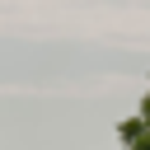
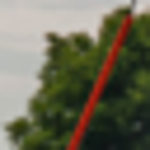
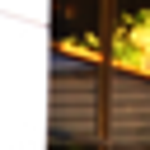

[269, 760, 762, 763, 2071, 2084, 2096, 2097, 2114, 2784, 2785, 2786, 3083, 3093, 3096, 3115, 3117, 3118, 3137, 3911, 4146, 4158, 4159, 4160, 4172, 4173, 4184, 4197, 4198, 4563, 5850, 5851, 5863, 5864, 5875, 7446, 7447, 7448, 8556, 8558, 8559, 8570, 8571, 8572, 8952, 8965, 8992, 9560, 9603, 9628, 9629, 9715, 9727, 9759, 9870, 9885, 9949, 9960, 9961, 9962, 10716, 12135, 12136, 12145, 12329, 12694, 12695, 12696, 12697, 12707, 12708, 12709, 12710, 12720, 12721, 12722, 12723, 12733, 12734, 12735, 12736, 12746, 12859, 12872, 13229, 13239, 15424, 15463, 15476, 15489, 15490, 15492, 16152, 16400, 16411, 16413, 16424, 16437, 16450, 17008, 17185, 17194, 17225, 17282, 17284, 18293, 19674, 19685, 19698, 19699, 19700, 19713, 20048, 20540, 20558, 22013, 22014, 22015, 22016, 22023, 22025, 22029, 22030, 22031, 22032, 22033, 22218, 22220, 22326, 23419, 23422, 23423, 23426, 23427, 23428, 23429, 23430, 23435, 23440, 24068, 24628, 24629, 24630, 24631, 24632, 24633, 24634, 24635, 24636, 24637, 24638, 24639,


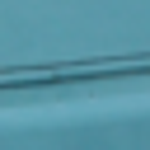
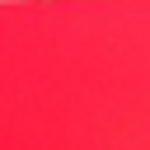
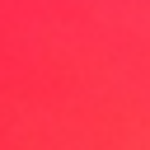
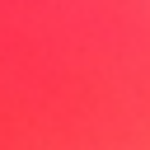
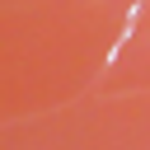
...
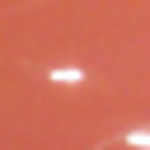
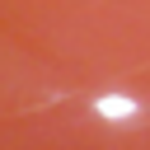
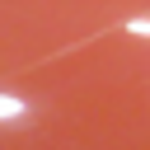
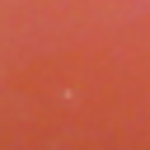
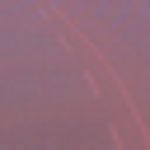

[18, 227, 487, 693, 1153, 1599, 2287, 2300, 2507, 3955, 4076, 4081, 4616, 4617, 4629, 5205, 5216, 5227, 5240, 5252, 5265, 5278, 5762, 6161, 6397, 6409, 6411, 6422, 6435, 6461, 6513, 7325, 7431, 7444, 8378, 9476, 9611, 9964, 9965, 10463, 10476, 10959, 10960, 11320, 11849, 11850, 12000, 12793, 12819, 13397, 13524, 14017, 14025, 14031, 14038, 14051, 16531, 17038, 17046, 17051, 17070, 17130, 17314, 17333, 17463, 17487, 17584, 17597, 17689, 18521, 19040, 19053, 19059, 19066, 19079, 20043, 20132, 20139, 20145, 20151, 20158, 20164, 20170, 20171, 20176, 20183, 20189, 20196, 20197, 20209, 20222, 20235, 20248, 20255, 20261, 20268, 20281, 20287, 20294, 20326, 20328, 20464, 21067, 21076, 21086, 21106, 21116, 21126, 21137, 21147, 21158, 21168, 21332, 21342, 21352, 21362, 21571, 22340, 22573, 22586, 22599, 22612, 22624, 22625, 22637, 22638, 22651, 22664, 22665, 22677, 22690, 23071, 23085, 23594, 23711, 23838, 23956, 23962, 24028, 24041, 24549, 24562, 25130, 25304, 25330, 25438, 25447, 25451, 25613, 


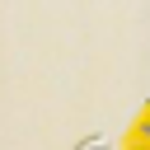
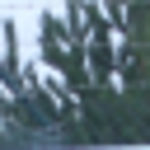
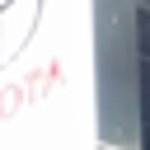
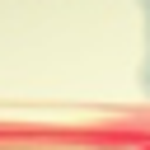
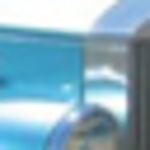
...
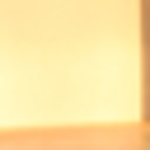
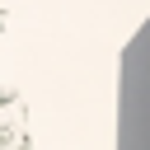
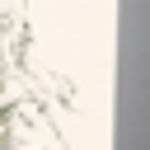
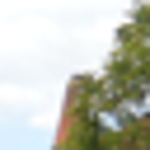
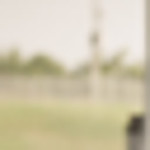

[78, 93, 245, 246, 345, 346, 347, 348, 512, 661, 790, 1029, 1045, 1150, 1151, 1164, 1384, 1385, 1839, 1840, 2051, 2099, 2165, 2192, 2556, 2557, 2658, 2915, 3017, 3059, 3113, 3660, 3665, 3950, 3954, 4007, 4009, 4102, 4203, 4337, 4426, 4553, 4556, 4557, 4559, 4608, 4683, 4684, 4819, 4820, 4947, 5218, 5219, 5220, 5229, 5235, 5249, 5254, 5255, 5304, 5306, 5317, 5319, 5382, 5445, 5446, 5455, 5482, 5483, 5530, 5545, 5703, 6368, 6581, 6582, 6583, 6584, 6642, 6738, 6882, 7072, 7073, 7074, 7075, 7330, 7340, 7341, 7439, 7453, 7469, 7598, 7611, 7648, 7649, 7894, 7900, 7934, 8010, 8016, 8017, 8018, 8019, 8020, 8027, 8028, 8097, 8098, 8170, 8217, 8228, 8235, 8402, 8721, 8722, 8723, 8724, 8725, 8726, 9178, 9179, 9180, 9223, 9224, 9225, 9237, 9272, 9273, 9294, 9408, 9691, 9692, 9696, 9697, 9698, 9699, 9700, 9701, 9758, 9761, 10051, 10053, 10263, 10274, 10275, 10675, 10676, 10677, 10684, 10685, 10686, 10687, 10688, 10692, 10693, 10853, 10854, 10855, 11408, 11436, 11437, 11597, 11623, 11624, 11625, 117


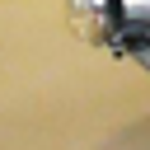
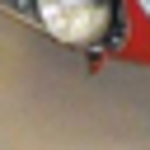
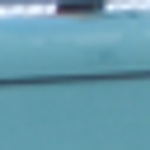
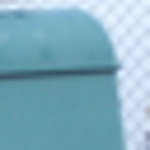
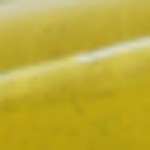
...
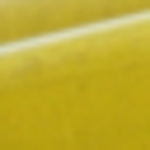
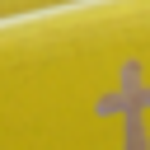
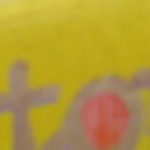
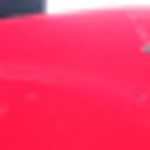
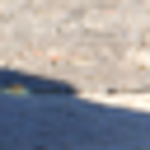

[80, 260, 369, 454, 639, 699, 765, 900, 901, 923, 1119, 1125, 1492, 1956, 1968, 2393, 2510, 2511, 2527, 2529, 2530, 2553, 2634, 2645, 2646, 2647, 2794, 2804, 2805, 3490, 3634, 4493, 4527, 4586, 4790, 4791, 5028, 5029, 5337, 5729, 5911, 5912, 6037, 6040, 6045, 6046, 6059, 6069, 6536, 6587, 6970, 6978, 6979, 7015, 7180, 7273, 7276, 7278, 7296, 7309, 7322, 7500, 7502, 7503, 7504, 7828, 7836, 7842, 7854, 7876, 8119, 8120, 8398, 9106, 10021, 10161, 10199, 10201, 10670, 11294, 11612, 11994, 12007, 12014, 12488, 12643, 12738, 12761, 12840, 12890, 13088, 13103, 13206, 13207, 13219, 13268, 13272, 13280, 13281, 13283, 13288, 13291, 13292, 13296, 13305, 13326, 13357, 13470, 13690, 13691, 13692, 13694, 13707, 13708, 14076, 14285, 14286, 14537, 14697, 14822, 15011, 15556, 15603, 15827, 16031, 16043, 16070, 16082, 16143, 16144, 16147, 16216, 16433, 16434, 16669, 16717, 17072, 17096, 17172, 17331, 17493, 17530, 17535, 17733, 17735, 17775, 17781, 17851, 18039, 18046, 18068, 18307, 18318, 18319, 18322,


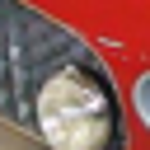
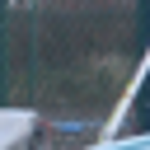
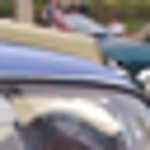
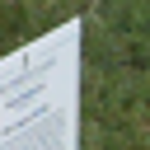
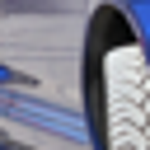
...
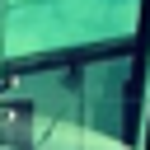
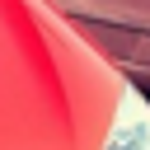
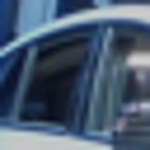
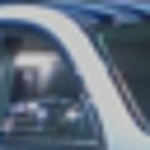
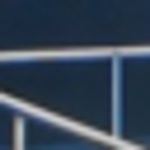

[38, 177, 185, 194, 300, 450, 712, 784, 801, 911, 944, 945, 957, 983, 1040, 1121, 1239, 1293, 1395, 1399, 1496, 1512, 1610, 1619, 1620, 1621, 1626, 1735, 1737, 1747, 1783, 1784, 1786, 1807, 1857, 1865, 1981, 2030, 2119, 2141, 2143, 2402, 2413, 2414, 2419, 2420, 2464, 2579, 2580, 2695, 2696, 2697, 2698, 2699, 2812, 2818, 2819, 3012, 3063, 3204, 3296, 3297, 3437, 3771, 4036, 4135, 4139, 4151, 4246, 4247, 4248, 4250, 4256, 4259, 4315, 4460, 4461, 4506, 4612, 4910, 5055, 5133, 5166, 5174, 5358, 5393, 5506, 5664, 5697, 5788, 5789, 5841, 5842, 5931, 6089, 6090, 6198, 6202, 6211, 6295, 6319, 6349, 6351, 6692, 6720, 6740, 6741, 6754, 6789, 6797, 6805, 6829, 6836, 6851, 6873, 6885, 6986, 7028, 7190, 7193, 7210, 7353, 7361, 7378, 7380, 7381, 7386, 7388, 7629, 7630, 7642, 8241, 8242, 8244, 8406, 8458, 8523, 8750, 8855, 8909, 9065, 9092, 9185, 9239, 9317, 9318, 9321, 9478, 9646, 9648, 9656, 9819, 9890, 10043, 10055, 10130, 10204, 10212, 10227, 10368, 10369, 10696, 10709, 10710, 10801, 10817, 10818


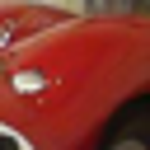
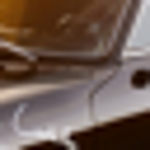
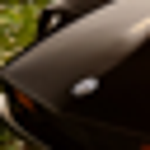
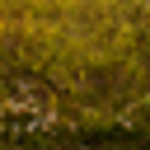
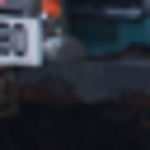
...
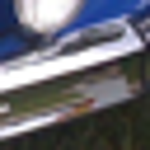
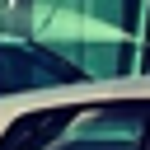
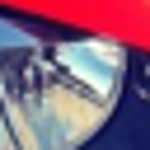
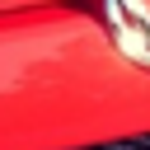
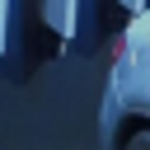

[301, 304, 824, 883, 969, 978, 979, 1091, 1160, 1189, 1264, 1423, 1425, 1861, 1875, 2480, 2701, 2703, 2743, 2749, 2751, 2764, 3121, 3122, 3134, 3148, 3149, 3161, 3162, 3195, 3224, 3225, 3231, 3328, 3341, 3354, 3549, 3562, 3594, 3597, 3598, 3607, 3611, 3620, 3627, 3827, 3840, 3852, 3853, 3866, 4154, 4401, 4402, 4627, 5069, 5082, 5185, 5326, 5329, 5511, 5525, 5538, 5738, 5752, 6087, 6212, 6213, 6265, 6269, 6280, 6756, 6769, 6842, 7123, 7129, 7415, 7643, 7742, 7819, 7859, 8427, 8440, 8495, 8612, 8651, 8780, 8800, 8805, 8818, 8819, 8831, 8832, 8845, 8846, 8861, 8887, 8888, 9002, 9003, 9004, 9122, 9209, 9346, 9349, 9350, 9378, 9391, 9417, 9426, 9430, 9439, 9443, 9454, 9455, 9466, 9467, 9584, 9769, 10527, 10528, 10534, 10557, 10586, 10587, 10599, 10612, 10622, 10625, 10626, 10872, 11179, 11318, 11335, 11339, 11704, 11920, 12541, 13072, 13149, 13774, 13810, 13817, 13820, 13826, 13858, 13866, 13869, 13875, 13968, 13981, 13994, 14083, 14123, 14137, 14138, 14142, 14148, 14150, 14155, 14160, 1416


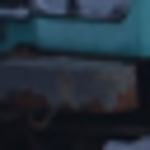
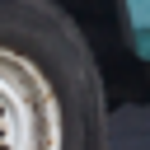
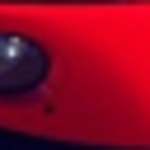
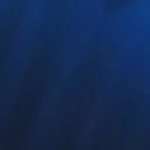
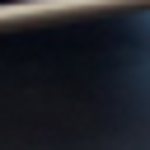
...
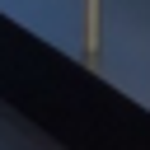
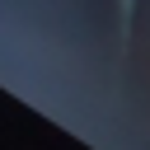
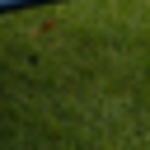
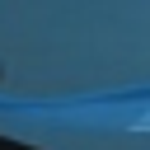
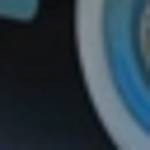

[634, 647, 691, 1562, 1835, 1848, 1871, 3756, 3782, 3795, 3808, 5015, 5475, 5539, 5612, 5625, 6486, 6499, 6512, 7731, 8403, 8416, 8613, 9199, 9731, 9734, 9736, 9744, 9749, 10967, 11002, 11372, 11386, 11399, 11679, 11692, 11705, 11971, 11984, 11997, 12004, 12029, 12042, 12757, 12783, 12796, 12951, 12955, 12956, 12963, 12964, 12976, 12977, 12989, 12990, 13002, 13003, 13015, 13016, 13124, 13189, 13792, 13811, 13830, 14037, 14050, 14274, 14292, 14531, 15414, 15606, 16170, 16474, 16487, 16684, 16697, 17056, 17326, 17913, 18907, 19038, 19039, 19052, 19103, 19116, 19749, 20031, 20127, 20146, 20167, 20193, 20206, 20219, 20232, 20245, 20258, 20271, 20277, 20284, 20285, 20462, 20475, 20544, 20553, 20742, 20755, 20946, 20959, 20972, 20985, 21104, 21114, 21124, 21134, 21354, 21359, 21387, 21390, 21397, 21407, 21412, 21500, 21513, 22076, 22198, 22730, 22864, 23039, 23052, 23065, 23078, 23091, 23092, 23909, 24005, 24018, 24027, 24031, 24040, 24360, 24566, 26780, 26793, 27235, 27248, 27264, 29138, 29


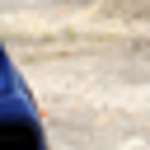
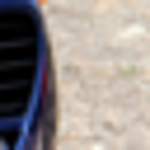
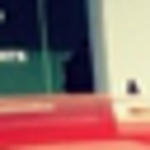
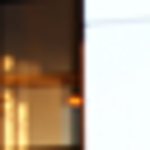
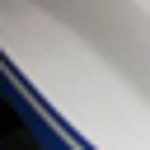
...
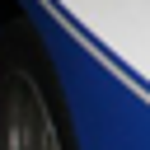
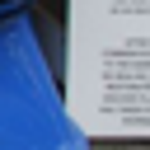
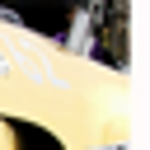
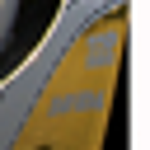
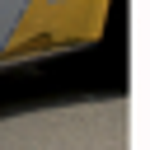

[188, 284, 285, 293, 294, 295, 307, 524, 630, 631, 632, 766, 819, 1042, 1159, 1174, 1175, 1413, 1499, 1501, 1508, 1515, 1516, 1617, 1618, 1740, 1902, 2125, 2133, 2134, 2139, 2228, 2569, 2813, 2828, 2830, 2835, 2836, 3190, 3234, 3235, 3317, 3363, 3364, 3425, 3543, 3550, 3551, 3552, 3553, 3554, 3555, 3556, 3793, 3905, 3906, 3914, 3964, 4033, 4034, 4035, 4039, 4128, 4136, 4366, 4367, 4567, 4639, 4844, 4998, 5068, 5170, 5299, 5359, 5473, 5509, 5597, 5730, 6063, 6064, 6209, 6210, 6340, 6488, 6489, 6498, 6594, 7124, 7130, 7131, 7354, 7355, 7356, 7357, 7358, 7359, 7360, 7631, 7818, 7943, 8160, 8622, 8644, 8645, 8654, 8655, 8656, 8657, 8658, 8659, 8660, 8741, 8906, 8911, 9005, 9010, 9011, 9012, 9191, 9192, 9193, 9195, 9202, 9203, 9206, 9207, 9249, 9250, 9297, 9299, 9435, 9436, 9437, 9717, 9718, 9719, 9720, 9721, 9722, 9728, 9729, 9817, 9909, 9929, 9930, 10058, 10059, 10060, 10061, 10062, 10063, 10064, 10065, 10066, 10067, 10131, 10141, 10608, 10712, 10713, 10870, 10878, 10879, 10880, 11193, 11


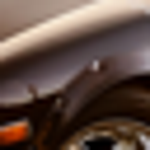
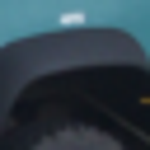
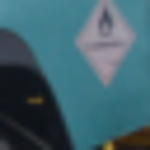
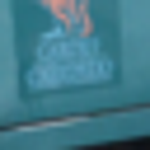
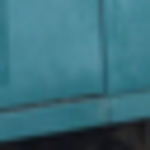
...
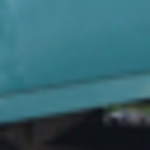
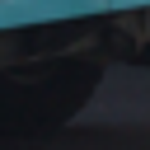
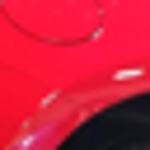
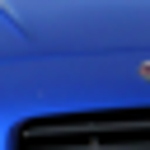
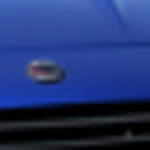

[39, 79, 325, 416, 733, 951, 962, 976, 981, 1053, 1170, 1171, 1247, 1303, 1406, 1419, 1534, 1651, 1744, 1757, 2605, 2975, 2990, 2991, 3131, 3132, 3314, 3327, 3329, 3330, 3338, 3342, 3343, 4055, 4148, 4162, 4163, 4254, 4685, 5321, 5369, 5370, 5824, 5837, 5838, 5839, 5854, 5942, 6165, 6331, 6344, 6359, 6360, 6575, 6604, 6761, 6771, 6903, 6904, 7146, 7234, 7403, 7534, 7547, 7664, 8166, 8185, 8418, 8431, 8441, 8863, 8946, 8947, 8961, 8974, 9153, 9154, 9167, 9228, 9418, 9445, 9458, 9842, 9902, 9927, 9940, 10571, 10721, 10722, 10735, 10888, 11153, 11180, 11201, 11203, 11216, 11230, 11231, 11302, 11317, 11330, 11343, 11344, 11460, 11548, 11629, 11814, 12121, 12127, 12557, 12939, 13075, 13233, 13263, 13270, 13782, 13791, 14112, 14727, 14756, 14757, 14758, 14841, 14842, 14855, 14856, 15330, 15333, 15425, 15462, 15475, 15508, 15530, 15546, 15551, 15789, 15825, 15831, 15959, 15960, 15973, 15977, 15987, 16499, 16604, 16617, 16618, 17114, 17164, 17272, 18013, 18196, 18226, 18442, 18913, 19028, 1929


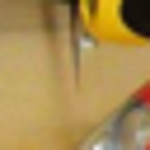
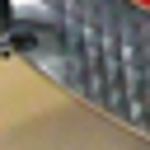
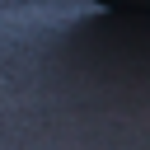
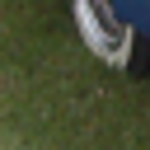
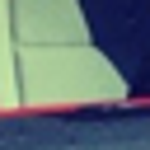
...
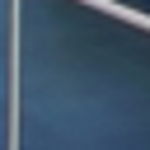
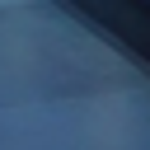
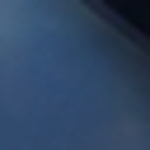
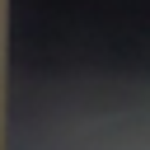
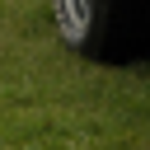

[560, 715, 779, 921, 1051, 1052, 1389, 2309, 2436, 2484, 2591, 2978, 3418, 4029, 4042, 4141, 4515, 4531, 4651, 5018, 5121, 5459, 5485, 5505, 5604, 5667, 5680, 5693, 5706, 5718, 5814, 6098, 6839, 6849, 7007, 7076, 7088, 7099, 7110, 7205, 7767, 7768, 8274, 8277, 8287, 8507, 9119, 9483, 9551, 9564, 9738, 9739, 10194, 11081, 11107, 11680, 11681, 11693, 11694, 11902, 12178, 12642, 12936, 12946, 12959, 12998, 13011, 13091, 13361, 13378, 13670, 13800, 13809, 13816, 13818, 13827, 13828, 13833, 13836, 13837, 13846, 13864, 14066, 14079, 14103, 14315, 14324, 14343, 14352, 14361, 14370, 14624, 14688, 14816, 15157, 15309, 15617, 15670, 15933, 15946, 16169, 16707, 16720, 16736, 17359, 17579, 17777, 17790, 17810, 18008, 18445, 18499, 18839, 18874, 18887, 18900, 19100, 19706, 19719, 20097, 20104, 20110, 20117, 20123, 20347, 20439, 20452, 20545, 20559, 20757, 20816, 20829, 20842, 20949, 20962, 20975, 21107, 21301, 21323, 21333, 21343, 21488, 21497, 21510, 21521, 21523, 21751, 21778, 22073, 22256, 22389


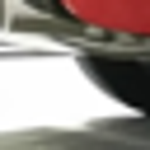
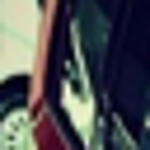
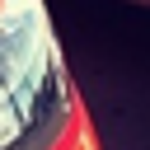
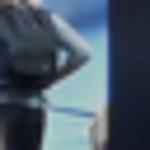
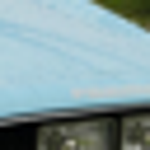
...
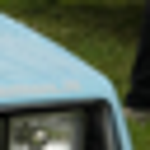
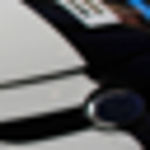
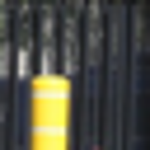
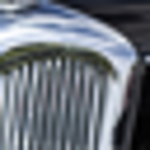
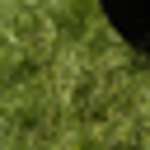

[20, 28, 29, 68, 144, 146, 153, 154, 165, 230, 231, 237, 238, 239, 249, 354, 579, 583, 589, 608, 688, 995, 1375, 1386, 1387, 2153, 2154, 2155, 2156, 2313, 2345, 2346, 2347, 2513, 2655, 2681, 3445, 3446, 3713, 3714, 3775, 3994, 4088, 4091, 4104, 4105, 4334, 4494, 4495, 4554, 4555, 4656, 4671, 4779, 4794, 4795, 5109, 5142, 5334, 5335, 5336, 5346, 5456, 5490, 5672, 5687, 5688, 5689, 5701, 5714, 5781, 5783, 5791, 5792, 5793, 5794, 5795, 5799, 5819, 5834, 5876, 5878, 5879, 5902, 5922, 6016, 6057, 6463, 6464, 6466, 6469, 6471, 6860, 7103, 7105, 7106, 7286, 7312, 7456, 7559, 7560, 7563, 7565, 7566, 7582, 7587, 7591, 7592, 7593, 7594, 7603, 7604, 7612, 7733, 7735, 7736, 7749, 7751, 7766, 7996, 8001, 8002, 8012, 8013, 8083, 8088, 8089, 8094, 8102, 8103, 8105, 8227, 8231, 8527, 9047, 9048, 9049, 9070, 9292, 9293, 9409, 9410, 9411, 9750, 9798, 10004, 10006, 10112, 10173, 10188, 10189, 10451, 10452, 10453, 10485, 10486, 10487, 10498, 10655, 10656, 10661, 10664, 10665, 10781, 10824, 10947, 10949, 1


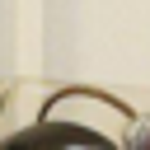
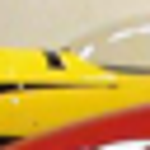
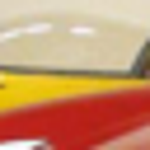
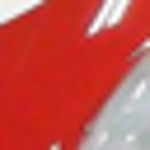
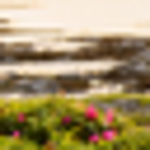
...
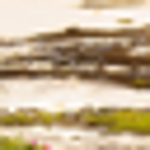
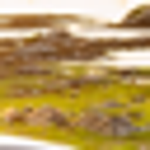
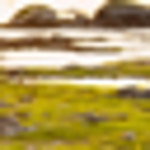
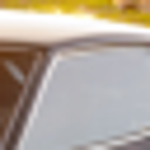
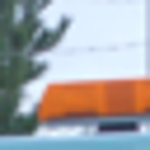

[8352, 8353, 8354, 8364, 8602, 9850, 9851, 9852, 9853, 9854, 9862, 9863, 9864, 10579, 10580, 10581, 10582, 15287, 17427, 17445, 18544, 18545, 18546, 18547, 18548, 18557, 18558, 18559, 18567, 18568, 18569, 18581, 18582, 19755, 19756, 20335, 22914, 22915, 22916, 22917, 22918, 22919, 22920, 22921, 22922, 22923, 22924, 22926, 22927, 22928, 22929, 22930, 24539, 24995, 24996, 24997, 24998, 24999, 25000, 25001, 25003, 25005, 25006, 25007, 25008, 25009, 25010, 25011, 25012, 25013, 25014, 25017, 25200, 25201, 25205, 25206, 25207, 25208, 25209, 25210, 25211, 25212, 25220, 25224, 25225, 25252, 25263, 25264, 25265, 25266, 25273, 25274, 25275, 25276, 25277, 25278, 25279, 25285, 25286, 25287, 25288, 25289, 25290, 25670, 25671, 25672, 25684, 25685, 25686, 25838, 25839, 25840, 25841, 25851, 25954, 25955, 25956, 25957, 25958, 25959, 25960, 25961, 25962, 25963, 25967, 25968, 25969, 25970, 25971, 25972, 25976, 25977, 25978, 25980, 25981, 25982, 25983, 25984, 25985, 25989, 25990, 25993, 25994, 25995, 2599


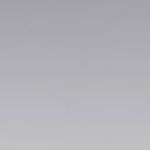
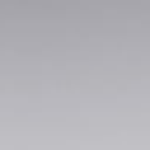
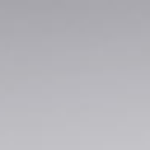
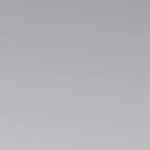
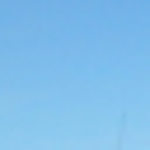
...
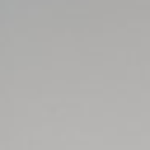
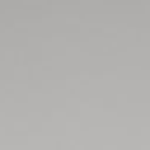
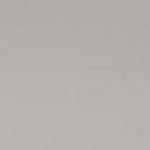
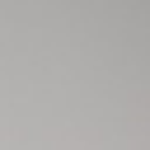
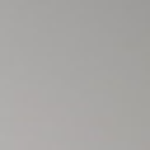

[349, 1243, 1244, 1245, 1259, 1272, 1323, 1684, 1729, 2736, 2737, 2738, 2739, 2740, 2741, 2742, 2800, 2928, 2929, 2974, 3001, 3002, 3058, 3092, 3104, 3105, 3106, 3114, 3116, 3119, 4564, 4565, 5244, 5395, 5409, 5422, 5995, 7305, 7306, 7437, 7650, 7663, 7917, 7918, 7919, 7920, 7930, 7931, 7932, 8040, 8053, 8054, 8055, 8056, 8057, 8065, 8169, 8182, 8194, 8195, 8557, 8695, 8697, 8703, 8905, 9573, 9586, 9702, 9703, 9936, 9947, 9948, 9957, 9958, 10689, 10690, 10691, 10702, 11240, 11243, 11248, 12120, 12129, 12130, 12317, 12353, 12366, 12384, 12406, 12416, 12424, 12426, 12434, 12435, 12436, 12444, 12445, 12446, 13154, 13157, 13414, 14694, 14719, 14720, 14721, 14732, 14797, 15242, 15997, 16004, 16621, 17294, 17866, 17871, 17872, 17881, 17882, 17883, 17884, 17895, 17896, 17897, 17898, 18371, 18375, 18376, 18382, 18386, 18387, 18393, 18398, 18403, 18404, 18405, 18406, 18408, 18409, 18410, 18411, 18414, 18415, 18416, 18417, 18418, 18419, 18420, 18421, 18422, 18423, 18424, 18425, 18426, 18858, 188


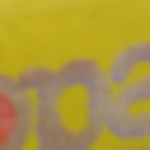
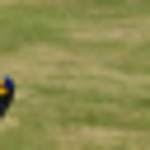
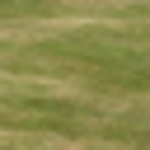
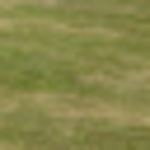
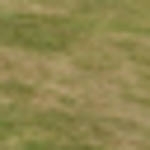
...
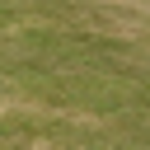
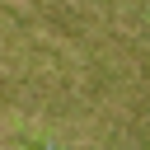
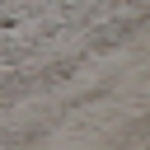
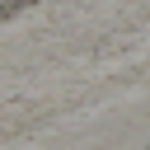
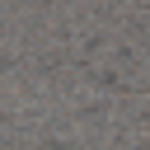

[135, 141, 1443, 1445, 1449, 1450, 1456, 1457, 1461, 1462, 1467, 1468, 2353, 2354, 2366, 2368, 2369, 2370, 2375, 2377, 2378, 3967, 3968, 4082, 4095, 4205, 4206, 4220, 4221, 4657, 4666, 5217, 5426, 5429, 5529, 5531, 5541, 5542, 5613, 5614, 5615, 5626, 5627, 5628, 5638, 5639, 5640, 5641, 6370, 7433, 8015, 9162, 9163, 9164, 11470, 11471, 11481, 11482, 11483, 11484, 11502, 11830, 11833, 11845, 11978, 11998, 11999, 12012, 12025, 12037, 12038, 12039, 12076, 12077, 12704, 13476, 13486, 13496, 13497, 13507, 13514, 13519, 13520, 13553, 13565, 13566, 13580, 13591, 14009, 14522, 14534, 14771, 15445, 15471, 16624, 17621, 18274, 19631, 19632, 19718, 20336, 20337, 20344, 20948, 20961, 20974, 21142, 21152, 21186, 21195, 22435, 22437, 22541, 22941, 22942, 22982, 23823, 23824, 23825, 23833, 23834, 23835, 23836, 23837, 23847, 23848, 23849, 23860, 23861, 23862, 23872, 23873, 23874, 23875, 23886, 23887, 23889, 23899, 23900, 23915, 23939, 23994, 23995, 23996, 23997, 23998, 24007, 24008, 24009, 24010, 24011


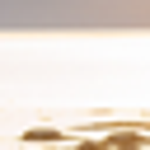
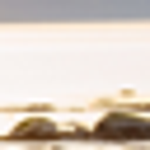
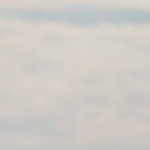
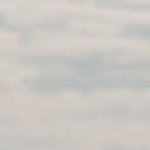
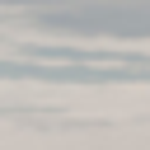
...
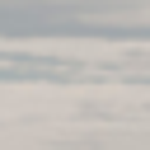
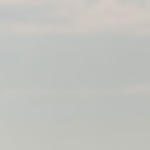
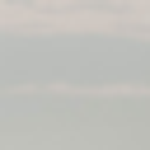
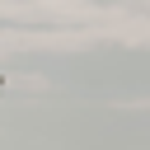
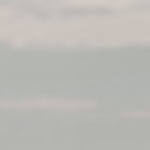

[22, 23, 24, 30, 31, 67, 572, 573, 1165, 1469, 1470, 1471, 1474, 1475, 1603, 2100, 2101, 2497, 2498, 3539, 3540, 3767, 3959, 3960, 3961, 3962, 4096, 4098, 4099, 4100, 4109, 4496, 4897, 4898, 4900, 5062, 5064, 5228, 5236, 5253, 5713, 5775, 5796, 5797, 6013, 6014, 6015, 6021, 6022, 6390, 6420, 6426, 6427, 6428, 6429, 6472, 6493, 6883, 7159, 7160, 7289, 7703, 7704, 7705, 7706, 7992, 7993, 7994, 7995, 8368, 8391, 9072, 9176, 9177, 9284, 9634, 9635, 9636, 9637, 9638, 10008, 10009, 10010, 10011, 10492, 11857, 12832, 12833, 12834, 12835, 14019, 14700, 14766, 14767, 14768, 14769, 14770, 16642, 17047, 18156, 18158, 19660, 19661, 19670, 19671, 19672, 19673, 19744, 20477, 21178, 21461, 22958, 22959, 23096, 23097, 23606, 23618, 23619, 23626, 23717, 24556, 24557, 24558, 24568, 24575, 24788, 24789, 25427, 25428, 25439, 25440, 25901, 26113, 26114, 26115, 26116, 26207, 26210, 26213, 26214, 26215, 26216, 26429, 26430, 26431, 26432, 26433, 26434, 26764, 26772, 26784, 26824, 27066, 27067, 27068, 27069, 2


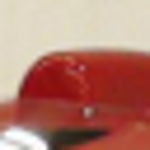
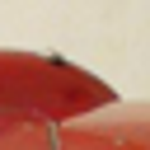
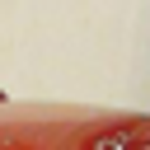
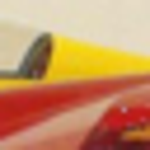
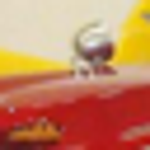
...
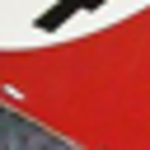
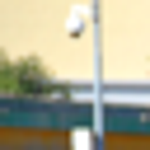
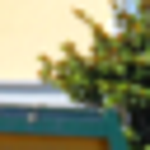
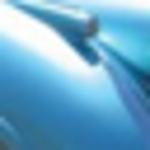
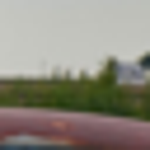

[402, 814, 879, 977, 1190, 1312, 1325, 1418, 1430, 1547, 1688, 1883, 1908, 1909, 2859, 2871, 2872, 3144, 3158, 3169, 3170, 3171, 3182, 3183, 3184, 3196, 3197, 3229, 3232, 3233, 3828, 3829, 3830, 3831, 3832, 3833, 3834, 3841, 3842, 3843, 3844, 3845, 3846, 3847, 3854, 3855, 3856, 3857, 3858, 3859, 3860, 3872, 3873, 4239, 4264, 5030, 5045, 5057, 5058, 5070, 5071, 5083, 5085, 5095, 5096, 5097, 5098, 5108, 6166, 6238, 6239, 6240, 6249, 6250, 6251, 6252, 6401, 6504, 6505, 6506, 6507, 6508, 6509, 6774, 6782, 6783, 7523, 7524, 7525, 7526, 7527, 7528, 7543, 7554, 7555, 7556, 8432, 8433, 8434, 8455, 8793, 8848, 9125, 9365, 9597, 9598, 9792, 9793, 9805, 10081, 10082, 10087, 10088, 10106, 10535, 10547, 10719, 10720, 10731, 10732, 10734, 11214, 11220, 11227, 11353, 11354, 11555, 11556, 11558, 11559, 11560, 11562, 11563, 11564, 11565, 11566, 11567, 11568, 11569, 11570, 11571, 11572, 11573, 11574, 11575, 11753, 12808, 14232, 14615, 14793, 14794, 14823, 14852, 14857, 14858, 14863, 14870, 14871, 15164,


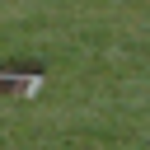
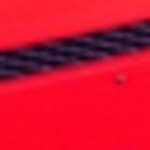
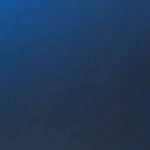
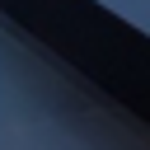
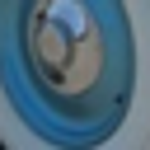
...
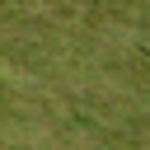
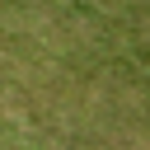
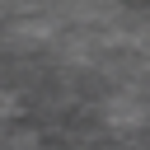
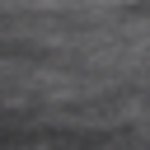
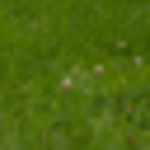

[296, 365, 859, 873, 885, 886, 1137, 1163, 1570, 1585, 2067, 2073, 2085, 2086, 2098, 2535, 2678, 2936, 3007, 3045, 3046, 3109, 3517, 3524, 3625, 3626, 3952, 3953, 3965, 3966, 4005, 4026, 4194, 4513, 4572, 4728, 5047, 5250, 5277, 5527, 5528, 5540, 5552, 5798, 5955, 6144, 6423, 7284, 7297, 7467, 7468, 7484, 7860, 7874, 7911, 7921, 7939, 7947, 7948, 8483, 9241, 9392, 9540, 9747, 9760, 9771, 9795, 10645, 10859, 11319, 11505, 11621, 11967, 11995, 12016, 12018, 12021, 12023, 12034, 12044, 12322, 12459, 12472, 12737, 12749, 12750, 12754, 12760, 12769, 12772, 12773, 12860, 13205, 13218, 13231, 13284, 13420, 13426, 13598, 14072, 14085, 14517, 14530, 14539, 14540, 14617, 14665, 14670, 14685, 14686, 14698, 14753, 14776, 15179, 15190, 15196, 15440, 15443, 15456, 15469, 15534, 16073, 16153, 16161, 16166, 16179, 16398, 16452, 16461, 16465, 16478, 16481, 17128, 17146, 17184, 17193, 17210, 17214, 17216, 17220, 17235, 17271, 17786, 17799, 17812, 18032, 18171, 18311, 18317, 18328, 18354, 18361, 18472, 1


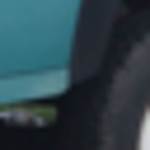
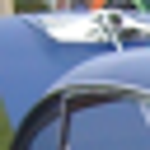
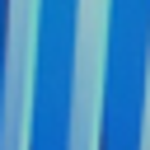
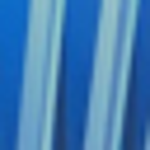
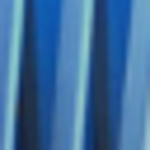
...
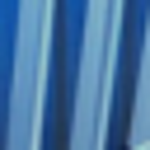
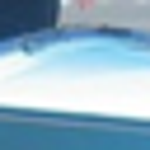
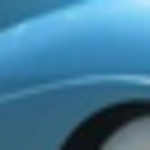
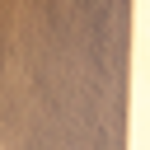
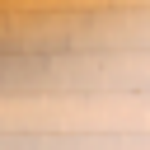

[892, 1824, 1825, 1826, 1827, 1828, 2074, 2075, 2372, 2667, 2668, 2670, 2672, 2673, 2675, 3687, 3688, 3690, 3750, 3809, 3818, 4630, 4644, 4861, 5048, 5049, 5050, 5052, 5293, 6179, 6180, 6413, 6414, 6415, 6416, 6417, 6418, 6451, 6452, 6453, 6454, 6455, 6456, 6457, 6480, 6516, 6517, 6518, 6519, 6520, 6521, 6522, 6523, 6858, 8006, 8007, 9150, 9165, 9267, 9384, 9385, 9772, 9773, 9774, 9968, 10178, 10179, 10390, 10391, 10478, 10512, 10812, 10900, 10901, 10902, 10903, 10904, 10905, 10906, 10907, 10908, 10909, 10910, 10911, 10912, 11494, 11496, 11779, 11780, 12026, 12788, 12798, 12804, 12805, 12806, 12933, 13242, 13267, 13511, 16108, 17147, 17162, 17389, 17582, 17648, 17803, 18163, 18164, 18165, 18275, 18276, 18506, 18507, 18508, 18513, 18514, 19352, 19354, 19737, 19752, 20324, 20325, 20450, 21127, 21318, 21319, 21320, 21321, 21322, 21391, 21392, 21550, 21562, 21563, 22186, 22187, 22196, 22327, 22328, 22329, 22526, 23622, 23627, 23628, 23629, 23630, 23631, 23632, 23634, 23635, 23636, 23637, 2


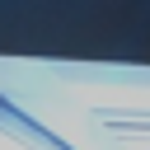
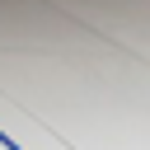
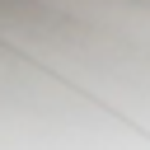
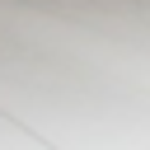
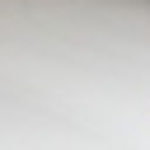
...
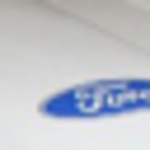
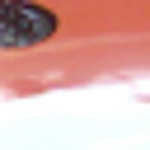
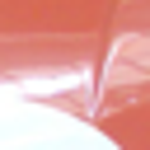
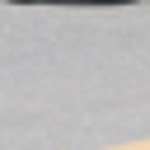
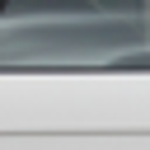

[252, 267, 378, 498, 511, 638, 695, 751, 789, 817, 818, 841, 1177, 1182, 1822, 1891, 1901, 2040, 2046, 2056, 2057, 2080, 2180, 2561, 2587, 2600, 2909, 2935, 2947, 2948, 2949, 2960, 2961, 2973, 2985, 3052, 3339, 3347, 3499, 3510, 3516, 3649, 3779, 3824, 4056, 4057, 4425, 4606, 4681, 4713, 4718, 4999, 5009, 5012, 5025, 5303, 5840, 6073, 6109, 6164, 6345, 6438, 6580, 6588, 6975, 7019, 7032, 7045, 7113, 7302, 7506, 7519, 7532, 7544, 7545, 7647, 7830, 7840, 7843, 7867, 7873, 7885, 7897, 7898, 7899, 7923, 7924, 7935, 7936, 7937, 8109, 8112, 8142, 8155, 8180, 8193, 8240, 8650, 8663, 8964, 9173, 9522, 9658, 9917, 10840, 10864, 10873, 11420, 11423, 11445, 11607, 11620, 11646, 11764, 12054, 12115, 12137, 12152, 12161, 12248, 12332, 12443, 12463, 12476, 12489, 12498, 12679, 13244, 13376, 13413, 13430, 13452, 13462, 13463, 13472, 13529, 13540, 13757, 14501, 14514, 14527, 14582, 14591, 14604, 14607, 14609, 14616, 14619, 14620, 14641, 14664, 14723, 14789, 14796, 14814, 14824, 14826, 14837, 15107, 15


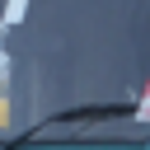
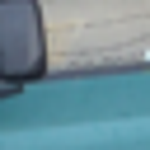
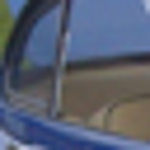
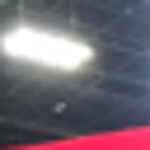
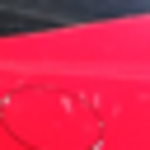
...
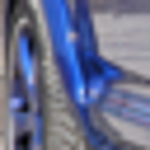
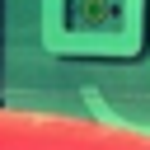
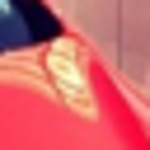
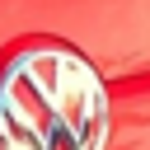
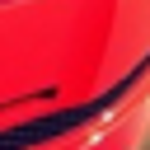

[203, 205, 212, 213, 214, 216, 538, 644, 845, 846, 848, 968, 1096, 1097, 1098, 1099, 1100, 1101, 1102, 1205, 1274, 1276, 1279, 1340, 1349, 1363, 1507, 1533, 1535, 1537, 1538, 1540, 1541, 1641, 1655, 1656, 1762, 1798, 1801, 1802, 1806, 1859, 1886, 2457, 2458, 2485, 2759, 2760, 2761, 2826, 2840, 2842, 2850, 2851, 2853, 2860, 2861, 2862, 2863, 2993, 2994, 3187, 3220, 3248, 3267, 3268, 3269, 3270, 3271, 3273, 3276, 3277, 3279, 3400, 3401, 3406, 3451, 3452, 3471, 3473, 3474, 3475, 3478, 3479, 3480, 3484, 3487, 3571, 3572, 3583, 3588, 3589, 3590, 3618, 3619, 3632, 3662, 3742, 3797, 3798, 3799, 3800, 3801, 3802, 3874, 4287, 4288, 4293, 4307, 4308, 4399, 4706, 4751, 4915, 4929, 4930, 5101, 5102, 5103, 5180, 5183, 5191, 5197, 5518, 5521, 5579, 5724, 5855, 5960, 6100, 6101, 6107, 6206, 6222, 6223, 6261, 6262, 6263, 6264, 6365, 6687, 6698, 6699, 6700, 6762, 6778, 6779, 6818, 6937, 6953, 7009, 7046, 7048, 7049, 7050, 7051, 7052, 7147, 7148, 7149, 7150, 7151, 7152, 7153, 7178, 7206, 7233, 7243, 725


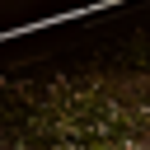
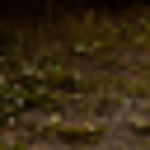
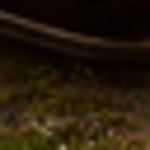
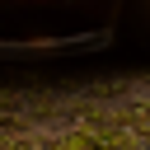
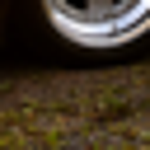
...
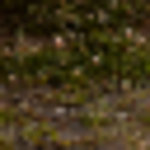
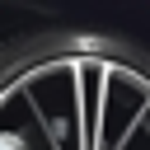
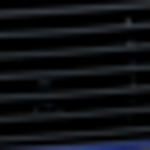
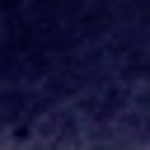
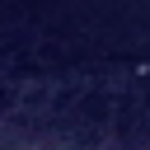

[928, 942, 994, 1030, 1044, 1142, 1155, 1156, 1169, 1195, 1258, 1271, 1624, 2015, 2159, 2542, 2543, 2548, 2584, 2679, 2682, 2878, 2910, 2923, 2950, 2963, 3010, 3110, 3427, 3650, 4217, 4427, 4594, 4822, 4835, 4913, 5173, 5290, 5449, 5457, 5698, 6177, 6190, 6572, 6988, 7310, 7315, 7323, 7350, 7363, 7493, 7621, 7634, 8024, 8037, 8221, 8234, 8376, 8377, 8864, 9146, 9174, 9585, 9891, 9904, 10037, 10592, 10658, 10806, 10848, 10860, 10964, 10978, 11373, 11428, 11441, 11499, 12008, 12079, 12170, 12261, 12400, 12485, 12493, 12507, 12515, 13098, 13106, 13111, 13165, 13192, 13257, 14020, 14101, 14516, 14630, 14634, 14710, 14738, 14795, 15146, 15247, 15260, 15272, 15470, 15483, 15900, 16120, 16157, 16435, 17159, 17202, 17429, 17472, 17633, 17646, 17923, 18017, 18229, 18272, 18505, 18733, 18762, 18772, 18870, 18880, 18937, 18993, 18994, 19006, 19007, 19056, 19069, 19201, 19214, 19241, 19242, 19255, 19330, 19413, 19584, 19600, 19667, 20351, 20359, 20360, 20535, 20867, 20890, 21009, 21023, 21327, 213


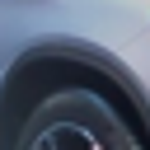
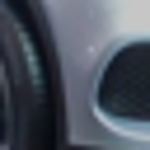
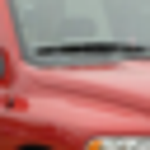
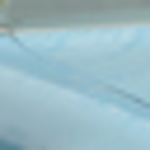
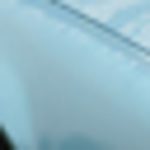
...
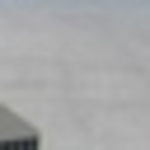
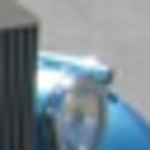
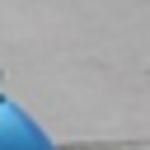
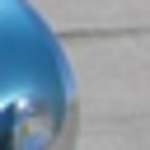
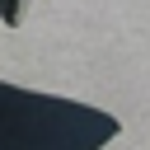

[183, 197, 198, 199, 200, 202, 204, 211, 215, 655, 656, 955, 1083, 1086, 1236, 1266, 1333, 1334, 1335, 1346, 1347, 1348, 1350, 1364, 1377, 1428, 1441, 1525, 1526, 1528, 1530, 1531, 1639, 1654, 1787, 1788, 1789, 1790, 1791, 1797, 1803, 1805, 2432, 2438, 2440, 2445, 2454, 2466, 2477, 2479, 2491, 2626, 2627, 2629, 2745, 2746, 2966, 2979, 3075, 3240, 3241, 3243, 3244, 3246, 3247, 3249, 3250, 3252, 3253, 3256, 3257, 3258, 3262, 3263, 3264, 3265, 3397, 3398, 3399, 3467, 3521, 3546, 3547, 3559, 3569, 3570, 3576, 3577, 3578, 3579, 3581, 3591, 3604, 3851, 4037, 4294, 4299, 4300, 4312, 4386, 4403, 4467, 4477, 4517, 4529, 4721, 4902, 5092, 5194, 5512, 5513, 5515, 5621, 5665, 5707, 5720, 5721, 5723, 5732, 5734, 5737, 5745, 5746, 5748, 5749, 5758, 5943, 5948, 5961, 6099, 6205, 6270, 6283, 6284, 6285, 6362, 6665, 6667, 6668, 6673, 6680, 6684, 6695, 6703, 6704, 6705, 6718, 6731, 6732, 6745, 6746, 6803, 6806, 6817, 6853, 6918, 6920, 6921, 6923, 6924, 6925, 6926, 6931, 6932, 6935, 6938, 6939, 6945, 695


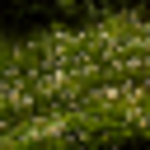
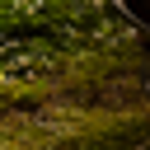
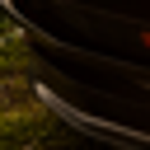
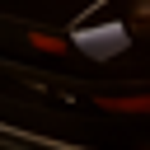
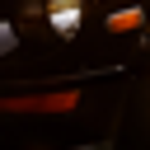
...
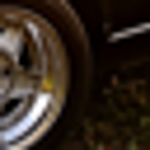
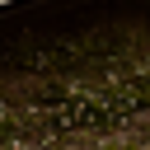
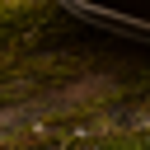
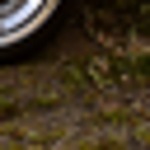
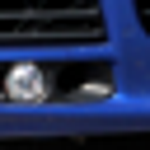

[384, 502, 515, 516, 532, 709, 725, 726, 740, 755, 792, 895, 1008, 1022, 1038, 1039, 1188, 1203, 1361, 1571, 1606, 1640, 1818, 1831, 2323, 2357, 2606, 2632, 2763, 2778, 2779, 3289, 3290, 3405, 3450, 3755, 3990, 4028, 4324, 4325, 4326, 4327, 4519, 4537, 4589, 4590, 4631, 4692, 4733, 4734, 4735, 4736, 4922, 4923, 4988, 5113, 5188, 5338, 5371, 5385, 5386, 5401, 5402, 5403, 5417, 5472, 5631, 5632, 5647, 5648, 5801, 5956, 6106, 6111, 6298, 6301, 6317, 6529, 6551, 6568, 6618, 6717, 6813, 6819, 6832, 6833, 6862, 6905, 7064, 7065, 7374, 7548, 7549, 7810, 7941, 8130, 8199, 8316, 8317, 8536, 8662, 9373, 9578, 9679, 9777, 10163, 10166, 10167, 10180, 10325, 10381, 10468, 10469, 10470, 10483, 10799, 10800, 10990, 11038, 11068, 11120, 11405, 11526, 11613, 11707, 11708, 11781, 11821, 11899, 11916, 11930, 11931, 11945, 11946, 12053, 12072, 12219, 12238, 12244, 12448, 12641, 12729, 12794, 12949, 13469, 13537, 13538, 13551, 13754, 13823, 13962, 13967, 14267, 14268, 14277, 14333, 14675, 14676, 14722, 147


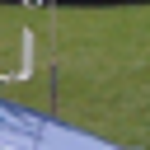
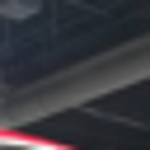
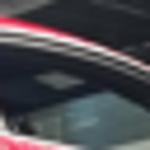
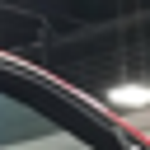
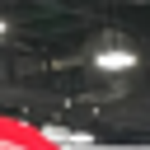
...
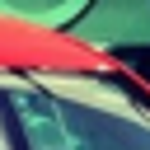
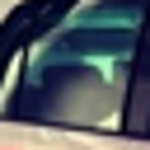
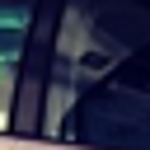
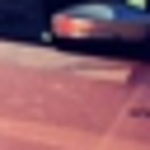
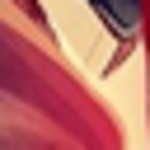

[37, 41, 50, 81, 247, 251, 276, 379, 392, 412, 414, 525, 526, 601, 628, 708, 925, 927, 950, 993, 1107, 1108, 1109, 1110, 1111, 1112, 1113, 1115, 1145, 1241, 1257, 1706, 1707, 1727, 1728, 1853, 1854, 1884, 1892, 1937, 1942, 1943, 1955, 2068, 2108, 2127, 2128, 2160, 2181, 2193, 2379, 2380, 2566, 2567, 2568, 2570, 2616, 2796, 2797, 2798, 2803, 2815, 2877, 2883, 2926, 2942, 2943, 2956, 3041, 3062, 3191, 3192, 3643, 3657, 3894, 3978, 3983, 3984, 4024, 4025, 4066, 4125, 4215, 4216, 4227, 4232, 4233, 4234, 4236, 4249, 4435, 4560, 4561, 4562, 4566, 4574, 4576, 4577, 4578, 4579, 4598, 4599, 4695, 4697, 4715, 4802, 4826, 4950, 4997, 5157, 5158, 5159, 5453, 5727, 6027, 6028, 6338, 6574, 6595, 6844, 7002, 7316, 7319, 7320, 7321, 7472, 7495, 7780, 7933, 8041, 8099, 8108, 8124, 8125, 8141, 8229, 8374, 8384, 8607, 8729, 8730, 8854, 9190, 9236, 9238, 9306, 9572, 9640, 9897, 10122, 10124, 10594, 10657, 10699, 10700, 10701, 11246, 11261, 11262, 11264, 11265, 11266, 11268, 11361, 11633, 11755, 12280, 123


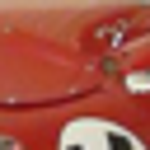
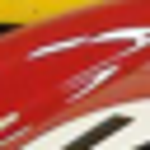
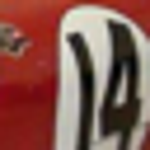
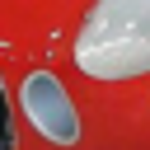
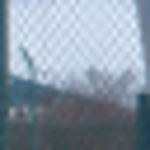
...
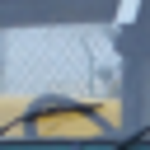
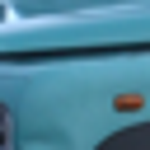
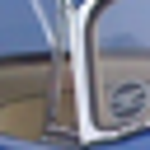
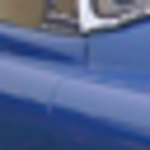
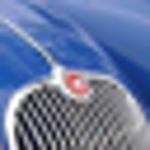

[192, 206, 481, 689, 837, 847, 849, 1206, 1275, 1290, 1300, 1329, 1339, 1352, 1355, 1357, 1542, 1750, 1809, 1860, 2467, 2468, 2470, 2493, 2630, 2653, 2769, 2844, 2864, 2865, 2995, 2996, 2997, 3175, 3176, 3198, 3211, 3274, 3411, 3412, 3548, 3560, 3567, 3568, 3573, 3617, 3628, 3629, 3640, 3803, 3807, 3864, 3865, 3875, 3876, 3877, 3887, 3888, 4397, 4480, 4730, 4752, 4753, 4799, 4927, 4989, 4990, 5093, 5104, 5196, 5522, 5644, 5655, 5666, 5679, 5747, 5828, 5831, 5858, 5962, 6220, 6297, 6309, 6366, 6719, 6780, 6781, 6830, 6831, 6854, 6855, 6867, 6878, 6933, 6947, 6949, 6967, 7013, 7154, 7155, 7245, 7246, 7266, 7267, 7791, 7803, 8246, 8296, 8625, 8638, 8779, 8792, 8809, 8822, 8833, 8879, 8882, 8883, 8988, 9312, 9323, 9441, 9497, 9580, 9583, 9601, 9613, 9681, 9894, 9932, 10107, 10120, 10135, 10563, 10564, 10575, 10576, 10627, 10628, 10727, 10738, 10884, 10941, 10953, 11066, 11092, 11106, 11395, 11553, 11948, 12100, 12105, 12214, 12252, 12659, 12660, 12672, 12683, 12940, 12947, 12948, 12960, 13


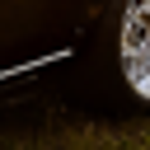
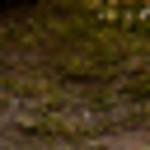
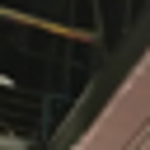
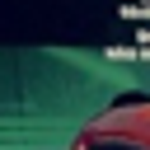
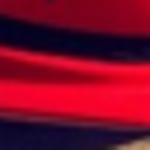
...
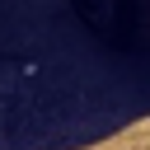
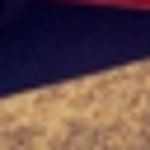
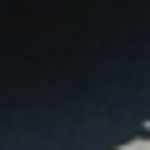
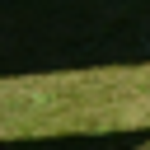
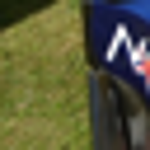

[270, 281, 386, 387, 772, 878, 1161, 1162, 1417, 1686, 1687, 1689, 1700, 1952, 1975, 1988, 2001, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2111, 2113, 2717, 2730, 2731, 2732, 2733, 2734, 2735, 2823, 3030, 3031, 3069, 3070, 3071, 3081, 3084, 3094, 3355, 3898, 3899, 3900, 3913, 3924, 3925, 3926, 3932, 3933, 3939, 3940, 3941, 3942, 4225, 4238, 4251, 4252, 4277, 4278, 4279, 4280, 4281, 4282, 4588, 4801, 5258, 5260, 5272, 5273, 5275, 5281, 5282, 5283, 5284, 5285, 5286, 5287, 6989, 7449, 7450, 7460, 7461, 7462, 7463, 7464, 7473, 7474, 7477, 7478, 7479, 8849, 9431, 9651, 9937, 9950, 9963, 10085, 10086, 10090, 10091, 10092, 10093, 10703, 10705, 10706, 10718, 10729, 10733, 10742, 11341, 11364, 13415, 14650, 14733, 14752, 14839, 14866, 15224, 15226, 15944, 16139, 17180, 17183, 17224, 17261, 17280, 17288, 17289, 17890, 18280, 18292, 18400, 18807, 18808, 18809, 18810, 18811, 18812, 18813, 19711, 19712, 21654, 21663, 21871, 21880, 21882, 21883, 21894, 22019, 22034, 233


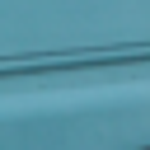
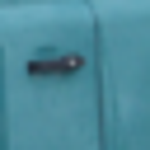
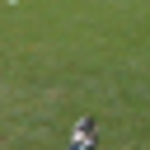
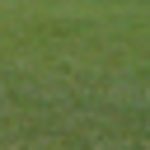
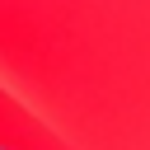
...
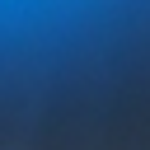
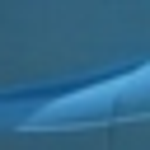
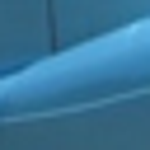
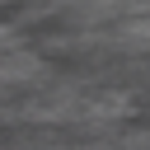
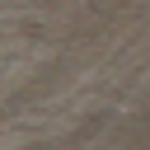

[35, 40, 42, 53, 56, 265, 363, 376, 425, 427, 436, 507, 520, 529, 534, 541, 605, 619, 625, 697, 698, 770, 805, 831, 875, 887, 889, 898, 933, 991, 1123, 1124, 1167, 1178, 1181, 2017, 2033, 2104, 2105, 2117, 2150, 2164, 2168, 2178, 2197, 2324, 2541, 2619, 2620, 2648, 2656, 2657, 2817, 2889, 2890, 2895, 2903, 3050, 3181, 3335, 3879, 3880, 3881, 3891, 3989, 3997, 3998, 4228, 4568, 4690, 4703, 4731, 4797, 4800, 4834, 4912, 4926, 4993, 5005, 5302, 5348, 5364, 5682, 6025, 6030, 6038, 6039, 6072, 6083, 6096, 6124, 6170, 6334, 6335, 6443, 6444, 6484, 6485, 6527, 6534, 6573, 6578, 6579, 6969, 7166, 7274, 7282, 7327, 7349, 7362, 7607, 7620, 7829, 7841, 7866, 7868, 7881, 7884, 8096, 8113, 8114, 8121, 8126, 8127, 8136, 8137, 8876, 8932, 9086, 9168, 9169, 10022, 10102, 10331, 10785, 10828, 11520, 11527, 11632, 11662, 11773, 12058, 12159, 12160, 12168, 12243, 12255, 12268, 12269, 12514, 12577, 12740, 12741, 12753, 13064, 13294, 13302, 13306, 13315, 13328, 13333, 13344, 13345, 13354, 13355, 13375, 134


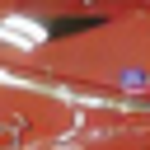
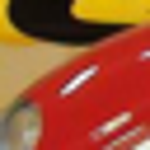
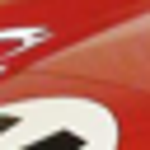
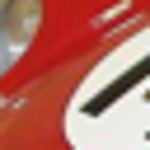
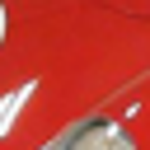
...
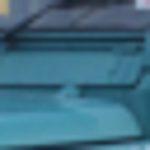
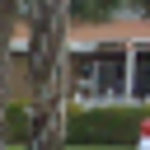
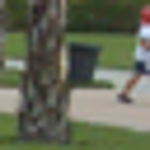
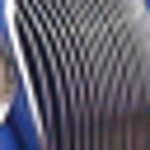
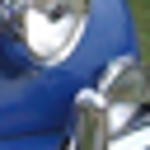

[164, 174, 437, 466, 558, 584, 606, 607, 620, 909, 929, 999, 1226, 1366, 1372, 1381, 1573, 1646, 1732, 1845, 1858, 1969, 2037, 2050, 2152, 2272, 2283, 2284, 2285, 2311, 2312, 2332, 2386, 2448, 2552, 2565, 2644, 3430, 3440, 3443, 3503, 4316, 4465, 4491, 4509, 4654, 4676, 4677, 4742, 4796, 4810, 4906, 4920, 4933, 4948, 5114, 5115, 5123, 5127, 5128, 5138, 5332, 5362, 5568, 5598, 5728, 5741, 5776, 5804, 5846, 5913, 5915, 5928, 6172, 6563, 6576, 6791, 6863, 6993, 7006, 7171, 7497, 7596, 7865, 7878, 7879, 8079, 8092, 8196, 8205, 8269, 8283, 8309, 8310, 8323, 8489, 8525, 8531, 8533, 8640, 9056, 9067, 9068, 9145, 9291, 9484, 9485, 9498, 9513, 9732, 9745, 9808, 9809, 9903, 9992, 10005, 10020, 10170, 10171, 10822, 10823, 10835, 11122, 11125, 11131, 11513, 11594, 11631, 11640, 11659, 11664, 11937, 12185, 12256, 12596, 12613, 12637, 12639, 12685, 13110, 13115, 13129, 13299, 13304, 13310, 13698, 13717, 13727, 13732, 13746, 13923, 14322, 14355, 14525, 14544, 14550, 14551, 14633, 14890, 14903, 14930,


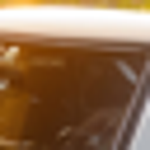
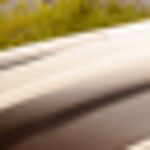
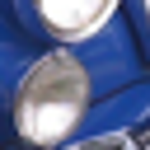
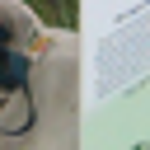
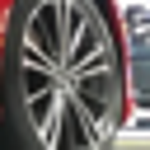
...
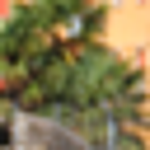
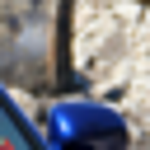
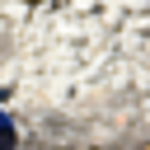
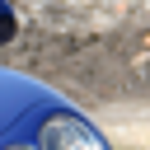
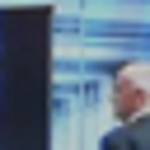

[85, 168, 439, 451, 519, 563, 564, 717, 730, 737, 741, 742, 743, 946, 1209, 1210, 1225, 1240, 1255, 1291, 1292, 1304, 1422, 1609, 1724, 1725, 1782, 1794, 2172, 2217, 2297, 2305, 2306, 2315, 2316, 2450, 2461, 2473, 3013, 3021, 3022, 3287, 3746, 4001, 4152, 4153, 4359, 4433, 4468, 4478, 4488, 4740, 4925, 5119, 5131, 5134, 5149, 5162, 5406, 5577, 5618, 5619, 5916, 5918, 5935, 5939, 6532, 6535, 6545, 6792, 6794, 6796, 6973, 7014, 7165, 7196, 7201, 7202, 7208, 7628, 7639, 7775, 8152, 8201, 8207, 8245, 8265, 8266, 8268, 8278, 8392, 8407, 8472, 8473, 8490, 8794, 8812, 8920, 9288, 9304, 9305, 9357, 9470, 9471, 9489, 9496, 9644, 9653, 9667, 10016, 10203, 10225, 10356, 10365, 10695, 10787, 10790, 10831, 10832, 10922, 10923, 11144, 11154, 11156, 11325, 11392, 11393, 11519, 11546, 11630, 11665, 11675, 11805, 11864, 11872, 11878, 12232, 12233, 12234, 12258, 12259, 12578, 12590, 12593, 12608, 12609, 12617, 12621, 12632, 12633, 12649, 12658, 12879, 12880, 12881, 12891, 12893, 12895, 12896, 12898, 128


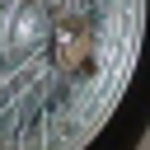
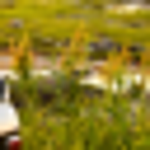
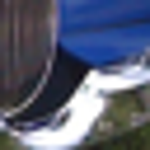
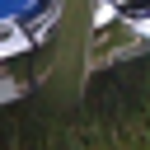
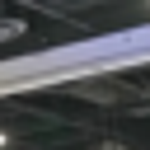
...
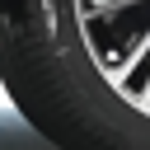
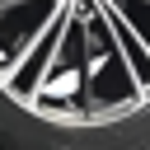
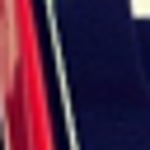
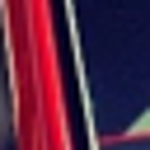
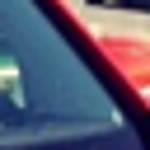

[64, 482, 799, 973, 1479, 1650, 1889, 2070, 2083, 2631, 2782, 2783, 2998, 3032, 3067, 3136, 3599, 3612, 3613, 4120, 4132, 4133, 4145, 4156, 4157, 4167, 4168, 4179, 4180, 4607, 5526, 5966, 6343, 6354, 7646, 8156, 8168, 8429, 8442, 8938, 8939, 8950, 8951, 8990, 9600, 9713, 9726, 9896, 9911, 10546, 10715, 10728, 11181, 11540, 11554, 12114, 12123, 13183, 13196, 13215, 13225, 13228, 13237, 13238, 14059, 14098, 15967, 16386, 16399, 16412, 16438, 16451, 16464, 17004, 17017, 17266, 17274, 17279, 17283, 17287, 18363, 18370, 18381, 18392, 18841, 19017, 19677, 19710, 19723, 20369, 20548, 20557, 20575, 21316, 21574, 21993, 21997, 22006, 22010, 22287, 22299, 22300, 22312, 22325, 22414, 22417, 23527, 24458, 24524, 24939, 24947, 25250, 25272, 25509, 26001, 26013, 26025, 26026, 26038, 26286, 26313, 26914, 26915, 26927, 26993, 27005, 27006, 27036, 27037, 28163, 28194, 28200, 28207, 28487, 28525, 28538, 29685, 29692, 29693, 29701, 29712, 29721, 29730, 29738, 29739, 29745, 29747, 29754, 29756, 29813, 298


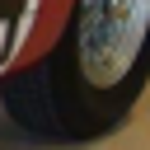
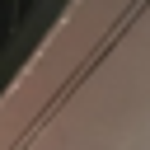
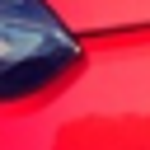
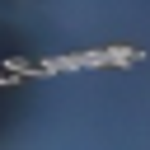
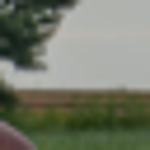
...
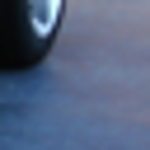
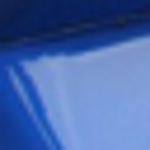
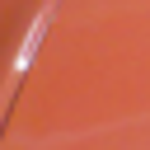
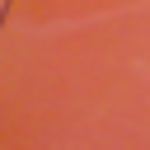
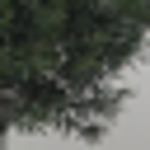

[417, 418, 419, 420, 429, 442, 443, 444, 455, 456, 457, 458, 468, 469, 470, 471, 472, 473, 474, 476, 867, 868, 869, 870, 880, 881, 1066, 1079, 1080, 1081, 1092, 1093, 1094, 1104, 1313, 1314, 1545, 1546, 1548, 1549, 1552, 1553, 1554, 1555, 1556, 1557, 1558, 1559, 1897, 1898, 1910, 2750, 2856, 2857, 2858, 2866, 2867, 2868, 2869, 2870, 3051, 3145, 3212, 3230, 3822, 3823, 3835, 4640, 5032, 5084, 5094, 5106, 5327, 5339, 5340, 5341, 5342, 5355, 5524, 6018, 6058, 6236, 6246, 6247, 6248, 6402, 6403, 6404, 6770, 7247, 7248, 7259, 7260, 7261, 7268, 7269, 7270, 7271, 7272, 7280, 7352, 7522, 8456, 8457, 8482, 8806, 9114, 9197, 9210, 9313, 9325, 9326, 9336, 9337, 9338, 9339, 9456, 9468, 9469, 9594, 9596, 10187, 11039, 11199, 11211, 11212, 11224, 11225, 11226, 11538, 11913, 12795, 13188, 13201, 13451, 13643, 14124, 14130, 14134, 14136, 14151, 14164, 14228, 14241, 14242, 14245, 14307, 14831, 14844, 14995, 15770, 15926, 15951, 16687, 16700, 17144, 17145, 17157, 17158, 17521, 18240, 18430, 18432, 18433


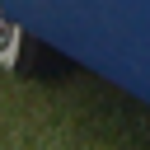
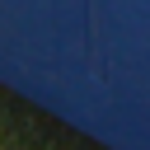
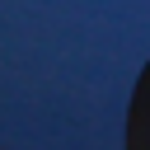
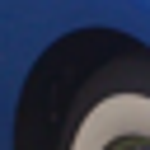
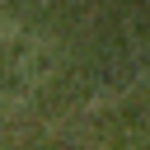
...
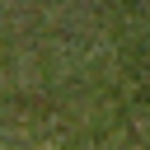
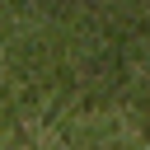
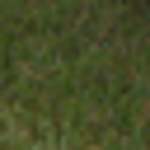
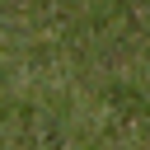
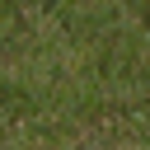

[975, 1147, 1148, 3082, 3123, 3157, 3595, 3608, 3912, 4174, 4175, 4186, 8430, 8443, 8444, 8445, 8446, 8447, 8448, 8449, 8450, 8451, 8452, 8453, 8454, 8677, 9351, 9352, 10083, 10084, 10089, 11561, 12759, 15169, 15172, 15173, 15174, 15186, 15187, 15502, 15504, 16165, 16387, 16614, 17179, 17181, 17182, 17187, 17188, 17189, 17190, 17191, 17192, 17195, 17196, 17204, 17270, 17290, 17291, 22213, 22214, 22215, 22216, 22219, 22226, 22227, 22228, 22229, 22239, 22240, 22241, 22253, 23420, 24511, 26964, 26965, 26966, 26967, 26978, 27035, 27046, 27047, 27048, 27049, 27056, 27057, 27058, 27313, 27326, 27419, 27422, 27435, 27461, 27462, 27463, 27464, 27474, 27475, 27476, 27477, 27478, 27479, 27480, 27482, 27488, 27489, 27490, 27491, 27492, 27493, 27494, 27495, 27496, 27497, 27498, 27499, 27500, 27501, 27502, 27503, 27504, 27505, 27506, 27507, 27508, 27509, 27510, 27511, 27512, 27513, 27514, 27515, 27516, 27517, 27518, 27519, 27520, 27521, 27522, 27523, 27524, 27757, 27758, 27759, 27760, 27773, 29398,


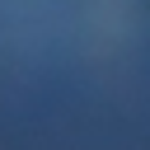
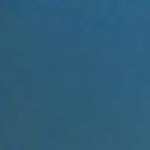
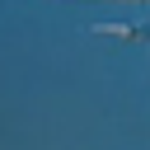
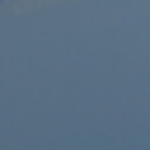
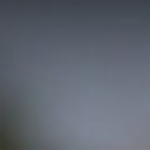
...
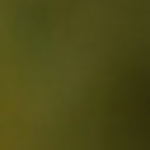
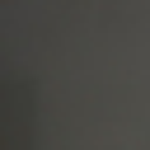
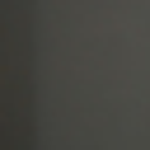
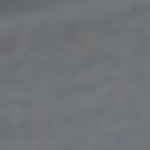
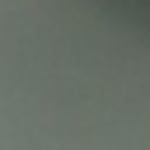

[26, 32, 162, 250, 381, 411, 423, 626, 778, 791, 888, 989, 990, 1063, 1463, 1711, 1730, 1731, 1743, 1864, 1893, 1959, 2020, 2021, 2052, 2079, 2103, 2116, 2163, 2203, 2537, 2538, 2540, 2550, 2881, 2884, 2885, 2892, 2920, 2925, 2938, 3061, 3530, 3999, 4020, 4041, 4352, 4353, 4431, 4497, 4502, 4504, 4609, 4821, 4824, 4825, 5040, 5056, 5787, 5808, 5810, 6726, 6729, 6848, 6992, 7020, 7115, 7173, 7317, 7338, 7339, 7348, 7485, 7494, 7533, 7605, 7862, 7892, 7896, 7926, 7928, 7940, 8100, 8139, 8230, 8535, 8611, 8865, 9274, 9525, 9538, 9665, 9887, 9913, 9926, 10669, 10839, 10951, 11426, 11432, 11433, 11439, 11801, 11988, 12040, 12141, 12150, 12167, 12184, 12230, 12235, 12242, 12257, 12276, 12289, 12500, 12508, 12512, 12648, 12676, 12689, 12739, 12768, 12780, 12855, 13232, 13256, 13303, 13400, 13407, 13408, 13418, 13447, 13456, 13483, 13550, 13789, 13797, 13845, 14089, 14090, 14116, 14305, 14312, 14314, 14341, 14546, 14549, 14579, 14606, 14622, 14659, 14660, 14672, 14701, 14714, 14828, 15064, 150


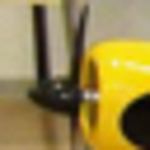
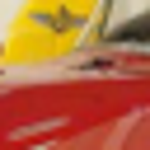
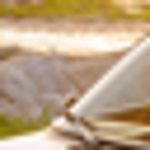
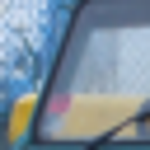
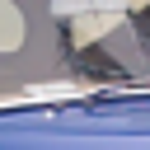
...
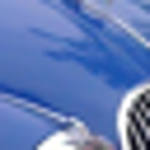
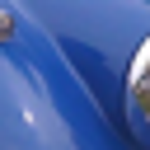
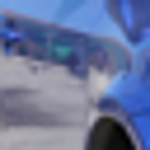
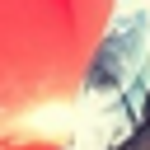
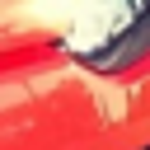

[318, 326, 327, 462, 463, 490, 493, 503, 518, 645, 744, 838, 839, 896, 958, 1054, 1084, 1085, 1090, 1288, 1306, 1307, 1415, 1484, 1513, 1529, 1536, 1614, 1630, 1748, 1749, 1867, 1869, 1872, 1878, 2581, 2594, 2595, 2831, 2832, 2841, 2843, 2849, 2852, 2967, 2969, 3209, 3324, 3346, 3402, 3472, 3532, 3653, 3806, 3849, 3908, 3916, 4164, 4165, 4241, 4255, 4260, 4271, 4272, 4289, 4516, 4613, 4626, 4633, 4674, 4675, 4707, 4724, 4726, 4968, 4970, 4971, 5001, 5007, 5076, 5086, 5088, 5309, 5310, 5311, 5312, 5313, 5323, 5324, 5325, 5372, 5510, 5519, 5566, 5593, 5595, 5596, 5608, 5609, 5610, 5622, 5623, 5856, 5857, 5859, 5936, 5937, 5945, 5946, 5950, 6102, 6103, 6112, 6113, 6114, 6115, 6116, 6117, 6118, 6119, 6120, 6208, 6214, 6221, 6227, 6302, 6353, 6605, 6606, 6612, 6613, 6614, 6656, 6657, 6743, 6744, 6763, 6820, 6907, 6908, 6909, 6916, 6917, 6928, 6999, 7030, 7054, 7055, 7056, 7066, 7067, 7116, 7117, 7235, 7242, 7411, 7641, 7645, 7653, 7654, 7715, 7743, 7793, 7813, 7814, 8173, 8175, 8176, 8302, 


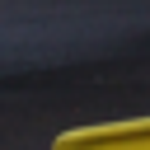
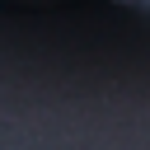
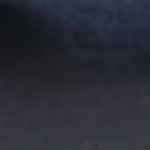
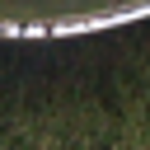
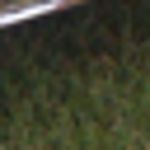
...
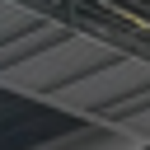
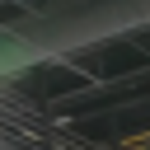
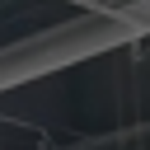
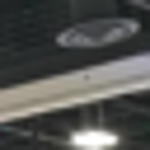
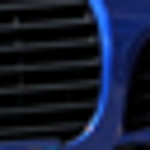

[36, 45, 46, 47, 49, 58, 277, 391, 401, 404, 406, 415, 483, 489, 495, 548, 585, 603, 604, 810, 811, 812, 813, 815, 949, 964, 965, 966, 974, 1105, 1122, 1176, 1426, 1431, 1432, 1486, 1487, 1488, 1489, 1490, 1493, 1494, 1495, 1500, 1502, 1503, 1504, 1895, 1896, 1904, 1905, 1906, 1950, 1951, 1965, 2035, 2121, 2122, 2124, 2137, 2138, 2140, 2206, 2207, 2208, 2218, 2219, 2226, 2691, 2716, 3064, 3065, 3066, 3226, 3227, 3356, 3357, 3358, 3359, 3361, 3362, 3365, 3848, 4114, 4115, 4127, 4129, 4137, 4253, 4375, 4376, 4570, 4571, 4600, 4601, 4614, 4618, 4619, 4817, 4840, 4841, 4842, 4843, 4845, 4941, 4942, 4956, 4957, 4960, 5004, 5008, 5072, 5288, 5295, 5296, 5297, 5298, 5300, 5328, 5343, 5581, 5594, 6035, 6086, 6242, 6243, 6244, 6245, 6337, 6339, 6400, 6490, 6491, 6495, 6610, 6611, 6760, 7003, 7016, 7017, 7118, 7119, 7279, 7491, 7492, 7508, 7509, 7518, 7521, 7529, 7530, 7538, 7539, 7540, 7541, 7542, 8036, 8159, 8161, 8162, 8646, 8647, 8927, 8928, 8929, 9087, 9093, 9096, 9097, 9099, 9100, 9101, 91


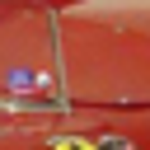
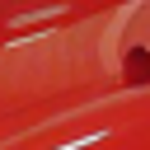
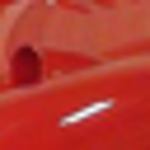
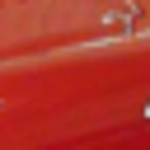
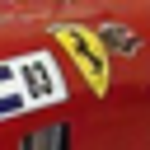
...
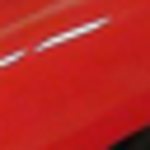
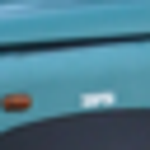
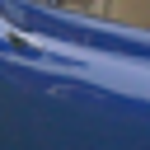
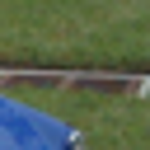
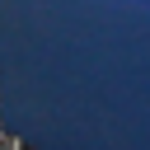

[12, 52, 65, 69, 70, 488, 694, 1140, 2088, 2089, 2102, 2944, 3048, 3155, 3529, 3988, 4094, 4503, 4812, 5053, 5242, 5279, 5318, 5967, 6356, 6382, 6725, 7172, 7298, 7311, 7432, 7434, 7445, 7458, 7824, 7909, 7922, 9166, 9387, 9399, 9546, 9550, 9577, 9735, 9746, 9790, 9939, 10583, 10584, 10596, 10644, 11297, 11309, 11431, 11497, 11504, 11979, 11983, 11996, 12005, 12027, 12063, 12197, 12320, 12340, 12350, 12458, 12462, 12471, 12484, 12582, 12675, 12752, 12807, 12820, 12858, 12863, 12868, 12871, 13164, 13185, 13203, 13204, 13259, 13466, 13475, 13485, 13495, 13505, 13515, 13832, 14033, 14046, 14287, 14295, 14296, 14636, 14687, 14735, 14748, 14786, 14798, 14799, 14862, 14869, 15233, 15417, 15441, 15459, 15460, 15473, 15572, 15585, 15598, 15611, 15624, 15637, 15650, 15663, 15880, 15881, 15883, 15884, 15890, 15893, 15894, 15906, 15919, 15931, 15932, 16423, 16620, 16633, 17176, 17186, 17241, 17418, 17505, 17611, 17623, 17716, 17784, 17797, 17915, 18018, 18034, 18113, 19062, 19067, 19080, 19093, 1


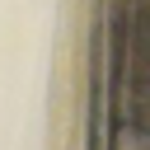
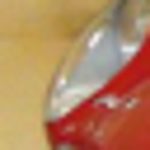
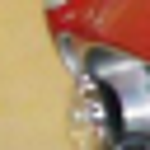
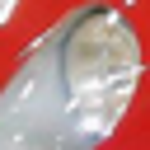
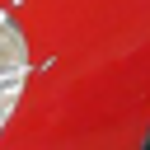
...
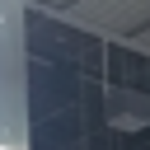
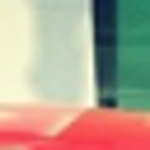
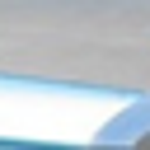
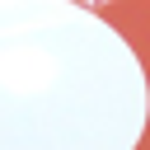
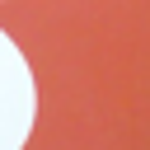

[178, 479, 706, 908, 943, 1058, 1078, 1382, 1592, 1593, 1601, 1602, 1843, 2344, 2348, 2689, 3025, 3165, 3166, 3728, 3729, 3758, 3788, 3903, 3904, 4019, 4106, 4195, 4345, 4436, 4437, 4438, 4439, 4440, 4679, 4963, 4964, 5065, 5066, 5153, 5493, 5717, 5816, 6149, 6150, 6192, 6601, 6752, 6895, 6896, 7109, 7702, 7805, 8255, 8380, 8381, 8617, 8732, 8733, 8734, 8735, 8739, 9071, 9422, 9554, 9555, 9556, 9557, 9558, 9633, 9824, 9878, 9879, 9880, 9881, 9888, 9889, 10129, 10138, 10190, 10191, 10192, 10193, 10214, 10215, 10348, 10350, 10351, 10457, 10495, 10682, 10776, 10827, 10982, 10983, 10985, 10997, 11509, 11511, 12046, 12050, 12581, 12987, 13813, 13937, 13938, 13987, 14027, 14078, 14535, 15422, 15423, 16241, 16637, 16638, 16789, 16790, 16791, 18206, 19362, 19378, 19380, 19668, 19681, 19922, 20489, 20769, 20770, 20777, 21008, 21069, 21070, 21463, 22008, 23047, 23048, 23368, 23801, 23839, 23840, 23841, 23842, 24091, 24093, 24336, 24779, 24780, 24782, 24784, 24790, 24791, 25032, 25334, 25335, 253


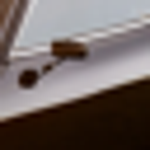
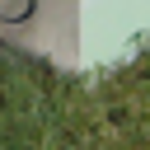
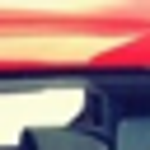
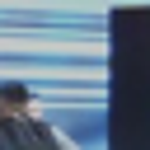
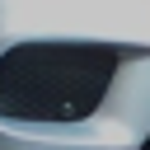
...
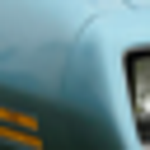
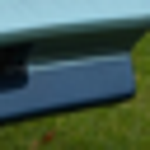
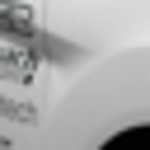
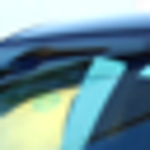
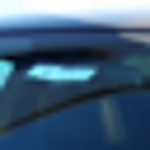

[57, 243, 244, 263, 280, 388, 397, 400, 535, 542, 554, 787, 800, 1149, 1246, 1663, 1675, 1676, 1685, 1701, 1702, 1714, 1715, 1924, 1925, 1938, 1939, 1940, 1941, 1944, 1945, 1946, 1947, 1953, 1962, 1977, 1978, 1979, 1989, 1990, 1991, 1992, 1993, 2000, 2055, 2095, 2236, 2661, 2662, 2718, 2719, 2720, 2721, 2722, 2723, 2724, 2725, 2726, 2727, 2728, 2729, 2916, 2931, 2932, 3019, 3043, 3056, 3068, 3085, 3086, 3348, 3350, 3885, 3886, 4022, 4199, 4200, 4265, 4575, 4698, 4699, 4700, 4701, 4702, 4813, 4814, 4815, 4816, 4831, 5246, 5248, 5261, 5941, 6162, 6325, 6475, 6476, 6477, 6478, 6482, 6773, 6976, 7033, 7167, 7475, 7476, 7907, 7910, 7946, 8110, 8146, 8179, 8192, 8370, 8371, 8385, 8630, 8688, 8689, 8690, 8691, 8692, 8702, 8838, 8852, 8862, 9599, 9724, 10741, 10852, 10886, 11316, 11342, 11365, 11485, 11486, 11740, 11761, 11762, 11767, 11770, 12111, 12124, 12128, 12323, 12324, 12326, 12334, 12342, 12354, 12452, 13074, 13155, 13405, 13421, 14578, 14589, 14597, 14602, 14603, 14618, 14787, 14788, 


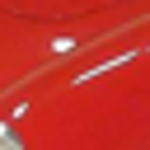
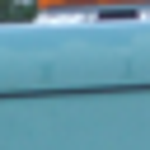
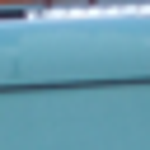
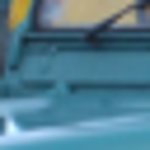
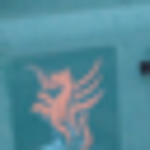
...
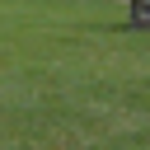
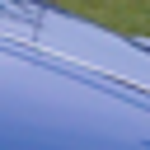
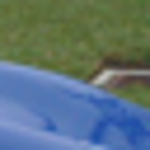
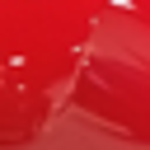
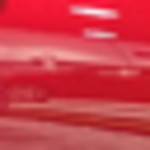

In [5]:
image_files = glob("dataset_100/train/*/*.jpg")

stride = 24
window_size = 32

for idx, image_file in enumerate(image_files):
    print(idx, image_file)
    pil_image = Image.open(image_file).convert('RGB')
    pil_image = pil_image.resize((int(round(pil_image.size[0]/3)), int(round(pil_image.size[1]/3))))
    image = np.array(pil_image)

    grid = (math.floor((image.shape[0] - (window_size - stride)) / stride), math.floor((image.shape[1] - (window_size - stride)) / stride))
    margin = ((image.shape[0] - grid[0] * stride)/2, (image.shape[1] - grid[1] * stride)/2)
    points = [(margin[0]+y*stride+stride/2,margin[1]+x*stride+stride/2) for y in range(grid[0]) for x in range(grid[1])]
    
    print('len(points)', len(points))
    
    patches = extract_windows(image, points, 32)

    P.extend(list(patches))
    
    windows = patches.astype(np.float64)

    feats = cnn.evalRGB(windows)
    feats = feats.reshape((windows.shape[0], 512))
    X.extend(list(feats))


print("Clustering with KMeans")
clusters = KMeans(n_clusters=100)
clusters.fit(np.array(X, dtype=np.float32))

# print("Clustering with MeanShift")
# bandwidth = estimate_bandwidth(X, quantile=0.5)
# clusters = MeanShift(bandwidth=bandwidth)
# clusters.fit(np.array(X, dtype=np.float32))

cluster_count = len(np.unique(clusters.labels_))
print('cluster_count', cluster_count)

for i in range(cluster_count):
    print([j for (j, x) in enumerate(clusters.labels_) if x == i])
    patch_cluster_samples = [P[j] for (j, x) in enumerate(clusters.labels_) if x == i][:10]
    ipyplot.plot_images(patch_cluster_samples)
    

In [ ]:
select_count = 10

select_ids = random.sample(patch_dict.keys(), select_count)
#print(select_ids)
select_feats = index.get_items(select_ids)
#print(len(select_feats))
nn_ids, nn_dis = index.knn_query(select_feats, 10)

for i in range(select_count):
    patch = patch_dict.get(select_ids[i])
    nn_patches = [patch_dict.get(q) for q in nn_ids[i]]
    nn_dis_labels = [q for q in nn_dis[i]]

    ipyplot.plot_images([patch], ['patch'])
    ipyplot.plot_images(nn_patches, nn_dis_labels)
